In [ ]:
import pandas as pd
import numpy as np
import time
from torch.utils.data import DataLoader
from torchvision.io import read_image
from torch.utils.data import Dataset
from torchvision import datasets
from torchvision.transforms import ToTensor, Resize
import torch
import torch.nn as nn
import torch.nn.functional as F
import numpy as np
import re

from sklearn.preprocessing import LabelEncoder
from sklearn.preprocessing import OneHotEncoder
from sklearn.model_selection import train_test_split
from PIL import Image
import argparse
import os
import random
import torch
import torch.nn as nn
import torch.nn.parallel
import torch.backends.cudnn as cudnn
import torch.optim as optim
import torch.utils.data
import torchvision.datasets as dset
import torchvision.transforms as transforms
import torchvision.utils as vutils
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.animation as animation
from IPython.display import HTML

dtype = torch.FloatTensor
BATCH_SIZE = 8
IMG_SIZE = (64, 64)

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
!ls drive/MyDrive/Colab\ Notebooks/tmnist

dataframe_creator_min_5_fonts_english.ipynb  main.ipynb
input					     main_pytorch.ipynb
main_english.ipynb			     Untitled0.ipynb
main_english_v2.ipynb


In [ ]:
!cp -r drive/MyDrive/Colab\ Notebooks/tmnist/input ./

In [ ]:
# This Python 3 environment comes with many helpful analytics libraries installed
# It is defined by the kaggle/python Docker image: https://github.com/kaggle/docker-python
# For example, here's several helpful packages to load
import os
import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)
import math
import matplotlib.pyplot as plt
# Input data files are available in the read-only "../input/" directory
# For example, running this (by clicking run or pressing Shift+Enter) will list all files under the input directory

import os
for dirname, _, filenames in os.walk('./input'):
    for filename in filenames:
        print(os.path.join(dirname, filename))

./input/devnagari_data.csv
./input/Glyphs_TMNIST_updated.csv
./input/min_5_fonts_english.csv


# CustomImageDataset

In [ ]:
class CustomImageDataset(Dataset):
    def __init__(self, dataset_file, transform=None, train=True, target_transform=None):
        # self.image_labels = pd.read_csv(annotations_file)
        self.query_dataset = None
        self.dataset = pd.read_csv(dataset_file)
        self.train = train
        self.target_transform = target_transform

    def set_dataset(self, x):
      self.query_dataset = self.dataset[self.dataset.label == x]
      X_train, X_test = train_test_split(self.query_dataset, test_size=0.20, random_state=42)
      if self.train:
        self.query_dataset = X_train.sort_values(['label', 'font_name'])
      else:
        self.query_dataset = X_test.sort_values(['label', 'font_name'])
      
      self.image_labels = self.dataset['label'].astype(str)
      self.query_image_labels = self.query_dataset['label'].astype(str)

      self.transform = transform
      self.target_transform = self.target_transform

      self.label_encoder = LabelEncoder()
      self.onehot_encoder = OneHotEncoder(sparse=False)

      self.integer_encoded = self.label_encoder.fit_transform(self.image_labels)
      self.integer_encoded = self.integer_encoded.reshape(len(self.integer_encoded), 1)

      self.onehot_encoded = self.onehot_encoder.fit_transform(self.integer_encoded)

    def encode_to_onehot(self, l):
      return self.onehot_encoder.transform(self.label_encoder.transform([l]).reshape(-1, 1))

    def decode_to_label(self, onehot):
      return self.label_encoder.inverse_transform([np.argmax(onehot)])

    def __len__(self):
        return len(self.query_image_labels)

    def __getitem__(self, idx):
        # 3rd column to last column are image pixels
        # Cannot keep 1x784 here because inner functions of DataLoader break
        # if idx < self.query_dataset.shape[0] and idx < self.query_image_labels.shape[0]:
        image = (self.query_dataset.iloc[idx,3:].values).astype(np.float64).reshape(28, 28)
        label = str(self.query_image_labels.iloc[idx])
        onehot_enc_label  = self.encode_to_onehot(label)
        if self.transform:
            image = self.transform(Image.fromarray(image))
        if self.target_transform:
            label = self.target_transform(label)
        return image, onehot_enc_label
        # return


In [ ]:
# transform = torchvision.transforms.Compose([
#     torchvision.transforms.ToTensor(),
#     torchvision.transforms.Normalize(
#         mean=[0.485, 0.456, 0.406],
#         std=[0.229, 0.224, 0.225],
#     ),
# ])
transform = transforms.Compose([Resize((64, 64)), ToTensor()])

csvname = 'min_5_fonts_english.csv'
training_data = CustomImageDataset(dataset_file=f"./input/{csvname}", train=True, transform=transform)
test_data = CustomImageDataset(dataset_file=f"./input/{csvname}", train=False, transform=transform)



/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:11: DtypeWarning: Columns (2) have mixed types.Specify dtype option on import or set low_memory=False.
  # This is added back by InteractiveShellApp.init_path()
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:12: DtypeWarning: Columns (2) have mixed types.Specify dtype option on import or set low_memory=False.
  if sys.path[0] == '':


In [ ]:
# cannot use shuffle=True
train_dataloader = DataLoader(training_data, batch_size=BATCH_SIZE, shuffle=False)
test_dataloader = DataLoader(test_data, batch_size=BATCH_SIZE, shuffle=False)

torch.Size([1, 64, 64])
(1, 62)


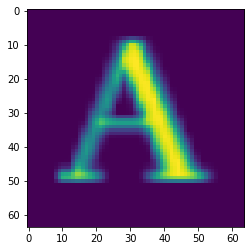

In [ ]:
for x, y in training_data:
  # print(y)
  print(x.shape)
  print(y.shape)
  plt.imshow(x.reshape(IMG_SIZE))
  break


In [ ]:
print(len(list(set(training_data.dataset.label))))

2


In [ ]:
print(list(set(training_data.dataset.label)))

['B', 'A']


In [ ]:
training_data.dataset.shape

(2452, 787)

torch.Size([8, 1, 64, 64])
torch.Size([8, 1, 62])
label is ['A']


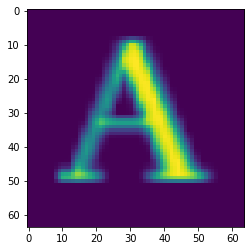

torch.Size([8, 1, 64, 64])
torch.Size([8, 1, 62])
label is ['A']


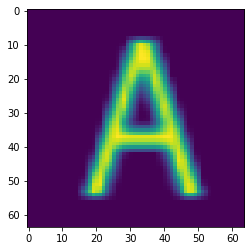

torch.Size([8, 1, 64, 64])
torch.Size([8, 1, 62])
label is ['A']


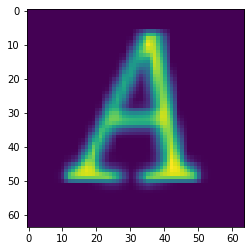

torch.Size([8, 1, 64, 64])
torch.Size([8, 1, 62])
label is ['A']


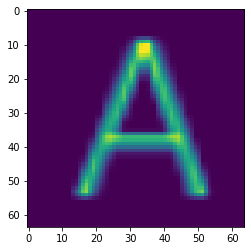

torch.Size([8, 1, 64, 64])
torch.Size([8, 1, 62])
label is ['A']


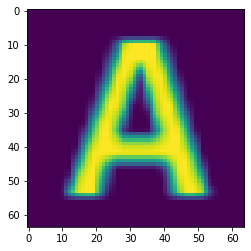

torch.Size([8, 1, 64, 64])
torch.Size([8, 1, 62])
label is ['A']


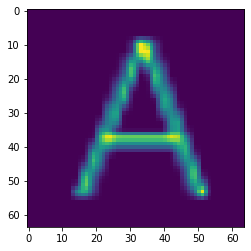

torch.Size([8, 1, 64, 64])
torch.Size([8, 1, 62])
label is ['A']


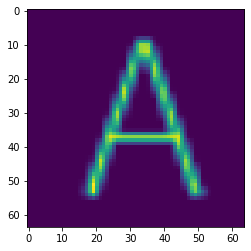

torch.Size([8, 1, 64, 64])
torch.Size([8, 1, 62])
label is ['A']


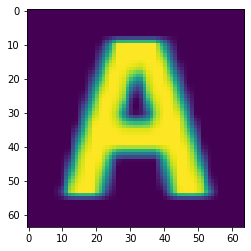

torch.Size([8, 1, 64, 64])
torch.Size([8, 1, 62])
label is ['A']


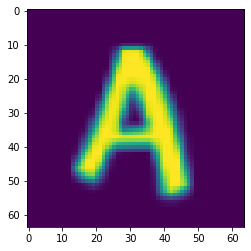

In [ ]:
# batch size is 8, b[1] would have 8 labels onehotencoded
for idx, b in enumerate(train_dataloader):
  print(b[0].shape)
  print(b[1].shape)
  print(f"label is {training_data.decode_to_label(b[1])}")
  plt.imshow(b[0][0].reshape(64, 64))
  plt.show()
  if idx==8:
    break

In [ ]:
b[0][0].reshape(IMG_SIZE).shape

torch.Size([64, 64])

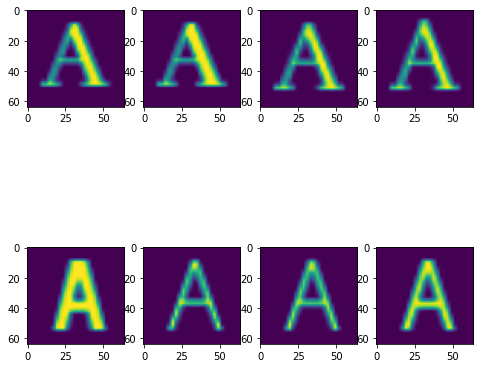

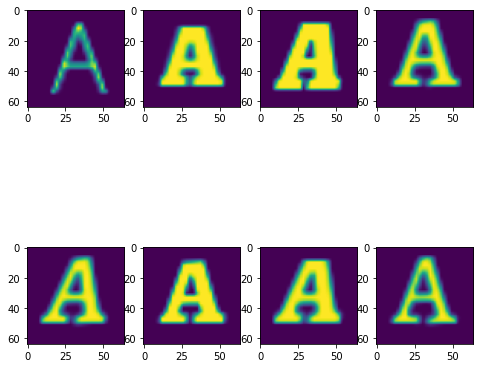

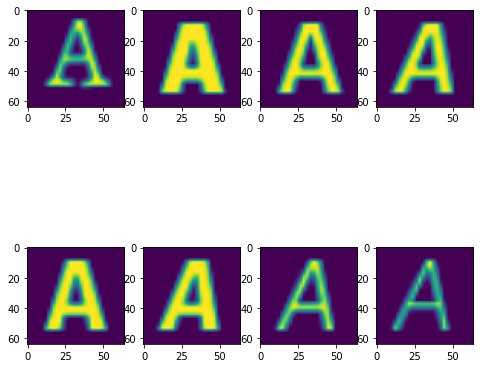

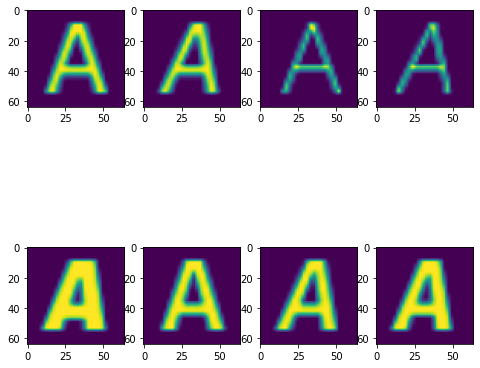

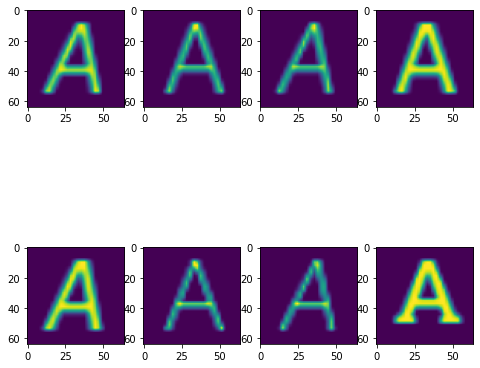

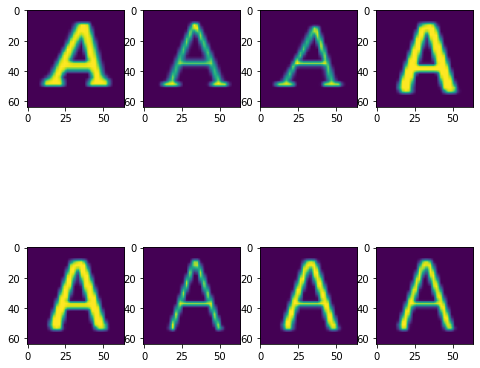

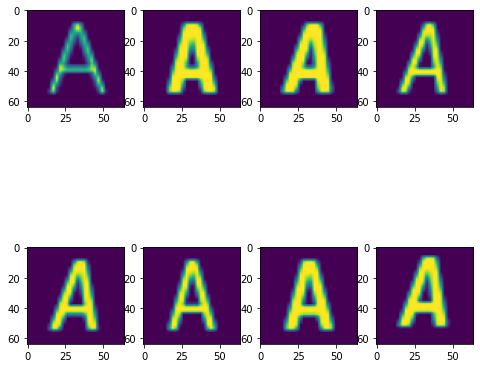

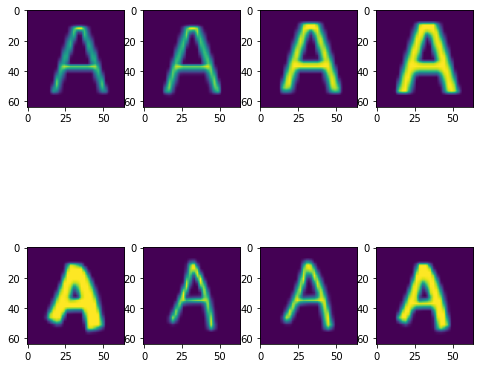

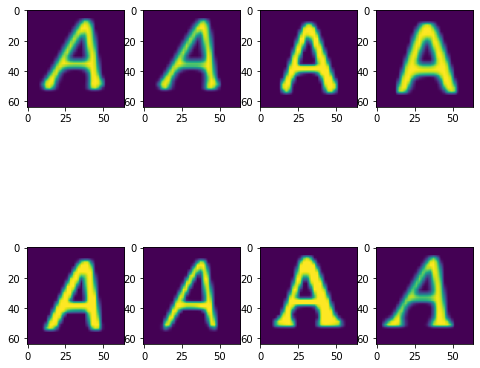

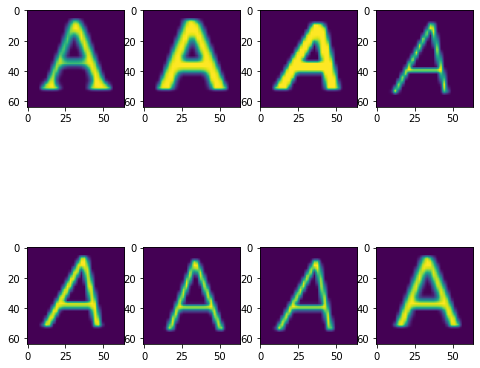

KeyboardInterrupt: ignored

In [ ]:
rows=2
img_count=0
cols = 4
for idx, b in enumerate(train_dataloader):
  fig, axes = plt.subplots(nrows=rows, ncols=cols, figsize=(8,8))
  img_count=0
  # print(b[1])
  for i in range(rows):
      for j in range(cols):
          if img_count < 8:      
            axes[i, j].imshow(b[0][img_count].reshape(64,64))
            img_count += 1
            # img_count = img_count%8
  plt.pause(0.0001)
  plt.show()


In [ ]:
def find_size(input_size, stride, kernel, padding=1):
  return ((input_size-1)*stride) + (kernel - 2*padding)

In [ ]:
find_size(16, 1, 5)

# t1


In [ ]:
# N(batch) Cin H W
input = torch.randn(32, 1, 5, 5)
m = nn.Sequential(
    # torch.nn.Conv2d(in_channels, out_channels, kernel_size, stride=1, padding=0, dilation=1, groups=1, bias=True, padding_mode='zeros', device=None, dtype=None)
    nn.Conv2d(1, 32, 5, 1, 1),
)
output = m(input)
# N(batch) Cout H W
output.size()

torch.Size([32, 32, 3, 3])

In [ ]:
# torch.nn.Linear(in_features, out_features, bias=True, device=None, dtype=None)
m = nn.Linear(20, 30)
input = torch.randn(128, 20)
output = m(input)
print(output.size())

torch.Size([128, 30])


In [ ]:
CLASS_COUNT = 62
NOISE_DIM = 1000

# Discriminator

In [ ]:
def initialize_weights(m):
    if isinstance(m, nn.Linear) or isinstance(m, nn.ConvTranspose2d):
        nn.init.xavier_uniform_(m.weight.data)

# Generator

In [ ]:

# Batch size during training
batch_size = BATCH_SIZE

# Spatial size of training images. All images will be resized to this
#   size using a transformer.
image_size = IMG_SIZE[0]

# Number of channels in the training images. For color images this is 3
nc = 1

# Size of z latent vector (i.e. size of generator input)
nz = 162 # 100

# Size of feature maps in generator
ngf = 64

# Size of feature maps in discriminator
ndf = 64

# Number of training epochs
num_epochs = 300

# Learning rate for optimizers
lr = 0.00001

# Beta1 hyperparam for Adam optimizers
beta1 = 0.5

# Number of GPUs available. Use 0 for CPU mode.
ngpu = 1

device = torch.device("cuda:0" if (torch.cuda.is_available() and ngpu > 0) else "cpu")


# Generator Code
class Generator(nn.Module):
    def __init__(self, ngpu):
        super(Generator, self).__init__()
        self.ngpu = ngpu
        self.main = nn.Sequential(
            # input is Z, going into a convolution
            nn.ConvTranspose2d( nz, ngf * 8, 4, 1, 0, bias=False),
            # nn.BatchNorm2d(ngf * 8),
            nn.ReLU(True),
            # state size. (ngf*8) x 4 x 4
            nn.ConvTranspose2d(ngf * 8, ngf * 4, 4, 2, 1, bias=False),
            # nn.BatchNorm2d(ngf * 4),
            nn.ReLU(True),
            # state size. (ngf*4) x 8 x 8
            nn.ConvTranspose2d( ngf * 4, ngf * 2, 4, 2, 1, bias=False),
            # nn.BatchNorm2d(ngf * 2),
            nn.ReLU(True),
            # state size. (ngf*2) x 16 x 16
            nn.ConvTranspose2d( ngf * 2, ngf, 4, 2, 1, bias=False),
            # nn.BatchNorm2d(ngf),
            nn.ReLU(True),
            # state size. (ngf) x 32 x 32
            nn.ConvTranspose2d( ngf, nc, 4, 2, 1, bias=False),
            nn.Tanh()
            # state size. (nc) x 64 x 64
        )

    def forward(self, input):
        return self.main(input)


# custom weights initialization called on netG and netD
def weights_init(m):
    classname = m.__class__.__name__
    if classname.find('Conv') != -1:
        nn.init.normal_(m.weight.data, 0.0, 0.02)
    elif classname.find('BatchNorm') != -1:
        nn.init.normal_(m.weight.data, 1.0, 0.02)
        nn.init.constant_(m.bias.data, 0)

netG = Generator(ngpu).to(device)
netG.apply(weights_init)

Generator(
  (main): Sequential(
    (0): ConvTranspose2d(162, 512, kernel_size=(4, 4), stride=(1, 1), bias=False)
    (1): ReLU(inplace=True)
    (2): ConvTranspose2d(512, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (3): ReLU(inplace=True)
    (4): ConvTranspose2d(256, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (5): ReLU(inplace=True)
    (6): ConvTranspose2d(128, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (7): ReLU(inplace=True)
    (8): ConvTranspose2d(64, 1, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (9): Tanh()
  )
)

In [ ]:
class Discriminator(nn.Module):
    def __init__(self, ngpu):
        super(Discriminator, self).__init__()
        self.ngpu = ngpu
        self.main = nn.Sequential(
            # input is (nc) x 64 x 64
            nn.Conv2d(nc, ndf, 4, 2, 1, bias=False),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. (ndf) x 32 x 32
            nn.Conv2d(ndf, ndf * 2, 4, 2, 1, bias=False),
            # nn.BatchNorm2d(ndf * 2),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. (ndf*2) x 16 x 16
            nn.Conv2d(ndf * 2, ndf * 4, 4, 2, 1, bias=False),
            # nn.BatchNorm2d(ndf * 4),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. (ndf*4) x 8 x 8
            nn.Conv2d(ndf * 4, ndf * 8, 4, 2, 1, bias=False),
            # nn.BatchNorm2d(ndf * 8),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. (ndf*8) x 4 x 4
            nn.Conv2d(ndf * 8, 1, 4, 1, 0, bias=False),
            nn.Sigmoid()
        )

    def forward(self, input):
        return self.main(input)


# Create the Discriminator
netD = Discriminator(ngpu).to(device)

# Handle multi-gpu if desired
if (device.type == 'cuda') and (ngpu > 1):
    netD = nn.DataParallel(netD, list(range(ngpu)))

# Apply the weights_init function to randomly initialize all weights
#  to mean=0, stdev=0.2.
netD.apply(weights_init)

# Print the model
print(netD)

netD(torch.from_numpy(np.random.randn(8,1,64,64)).type(torch.FloatTensor).to(device))

Discriminator(
  (main): Sequential(
    (0): Conv2d(1, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (1): LeakyReLU(negative_slope=0.2, inplace=True)
    (2): Conv2d(64, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (3): LeakyReLU(negative_slope=0.2, inplace=True)
    (4): Conv2d(128, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (5): LeakyReLU(negative_slope=0.2, inplace=True)
    (6): Conv2d(256, 512, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (7): LeakyReLU(negative_slope=0.2, inplace=True)
    (8): Conv2d(512, 1, kernel_size=(4, 4), stride=(1, 1), bias=False)
    (9): Sigmoid()
  )
)


tensor([[[[0.4998]]],


        [[[0.4981]]],


        [[[0.4931]]],


        [[[0.4979]]],


        [[[0.4919]]],


        [[[0.4898]]],


        [[[0.4972]]],


        [[[0.4964]]]], device='cuda:0', grad_fn=<SigmoidBackward0>)

In [ ]:
# Initialize BCELoss function
criterion = nn.BCELoss()

# Create batch of latent vectors that we will use to visualize
#  the progression of the generator
fixed_noise = torch.randn(64, nz, 1, 1, device=device)

# Establish convention for real and fake labels during training
real_label = 1.
fake_label = 0.

# Setup Adam optimizers for both G and D
optimizerD = optim.Adam(netD.parameters(), lr=lr, betas=(beta1, 0.999))
optimizerG = optim.Adam(netG.parameters(), lr=lr, betas=(beta1, 0.999))

## labellist

Starting Training Loop...
[0/300][0/154]	Loss_D: 1.4050	Loss_G: 0.6932	D(x): 0.5917	D(G(z)): 0.5000 / 0.5000
label is ['A']


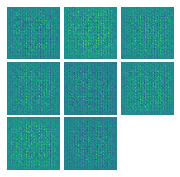

(8, 1, 64, 64)
[0/300][50/154]	Loss_D: 0.6942	Loss_G: 0.6922	D(x): 0.9999	D(G(z)): 0.5005 / 0.5005
label is ['A']


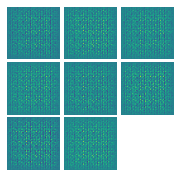

(8, 1, 64, 64)
[0/300][100/154]	Loss_D: 0.7479	Loss_G: 0.6870	D(x): 0.9558	D(G(z)): 0.5030 / 0.5031
label is ['A']


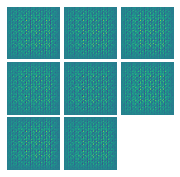

(8, 1, 64, 64)
[0/300][150/154]	Loss_D: 0.7171	Loss_G: 0.6777	D(x): 0.9921	D(G(z)): 0.5079 / 0.5078
label is ['A']


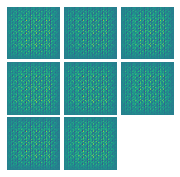

(8, 1, 64, 64)
[1/300][0/154]	Loss_D: 0.7104	Loss_G: 0.6776	D(x): 0.9988	D(G(z)): 0.5080 / 0.5078
label is ['A']


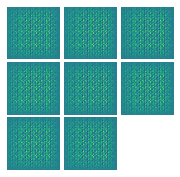

(8, 1, 64, 64)
[1/300][50/154]	Loss_D: 0.7068	Loss_G: 0.6800	D(x): 1.0000	D(G(z)): 0.5068 / 0.5066
label is ['A']


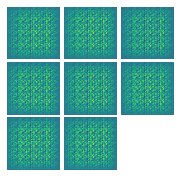

(8, 1, 64, 64)
[1/300][100/154]	Loss_D: 0.7425	Loss_G: 0.6802	D(x): 0.9659	D(G(z)): 0.5063 / 0.5065
label is ['A']


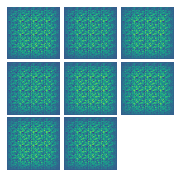

(8, 1, 64, 64)
[1/300][150/154]	Loss_D: 0.7260	Loss_G: 0.6843	D(x): 0.9775	D(G(z)): 0.5045 / 0.5045
label is ['A']


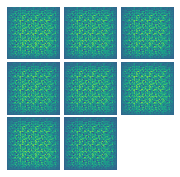

(8, 1, 64, 64)
[2/300][0/154]	Loss_D: 0.7033	Loss_G: 0.6844	D(x): 0.9991	D(G(z)): 0.5046 / 0.5044
label is ['A']


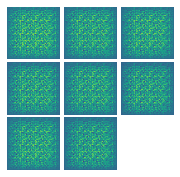

(8, 1, 64, 64)
[2/300][50/154]	Loss_D: 0.6979	Loss_G: 0.6889	D(x): 1.0000	D(G(z)): 0.5023 / 0.5021
label is ['A']


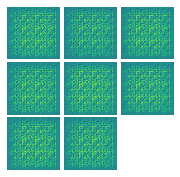

(8, 1, 64, 64)
[2/300][100/154]	Loss_D: 0.7170	Loss_G: 0.6898	D(x): 0.9804	D(G(z)): 0.5017 / 0.5017
label is ['A']


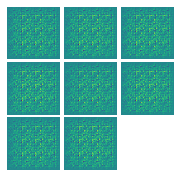

(8, 1, 64, 64)
[2/300][150/154]	Loss_D: 0.6998	Loss_G: 0.6942	D(x): 0.9927	D(G(z)): 0.4996 / 0.4995
label is ['A']


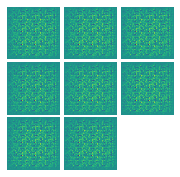

(8, 1, 64, 64)
[3/300][0/154]	Loss_D: 0.6923	Loss_G: 0.6946	D(x): 0.9997	D(G(z)): 0.4994 / 0.4993
label is ['A']


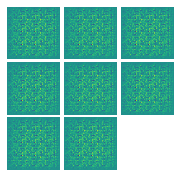

(8, 1, 64, 64)
[3/300][50/154]	Loss_D: 0.6907	Loss_G: 0.6958	D(x): 1.0000	D(G(z)): 0.4988 / 0.4987
label is ['A']


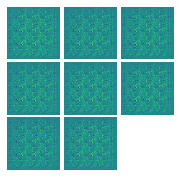

(8, 1, 64, 64)
[3/300][100/154]	Loss_D: 0.7074	Loss_G: 0.6929	D(x): 0.9862	D(G(z)): 0.5000 / 0.5001
label is ['A']


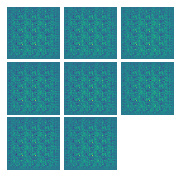

(8, 1, 64, 64)
[3/300][150/154]	Loss_D: 0.6970	Loss_G: 0.6913	D(x): 0.9982	D(G(z)): 0.5010 / 0.5009
label is ['A']


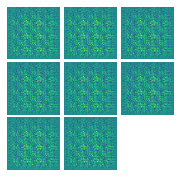

(8, 1, 64, 64)
[4/300][0/154]	Loss_D: 0.6953	Loss_G: 0.6912	D(x): 0.9999	D(G(z)): 0.5010 / 0.5010
label is ['A']


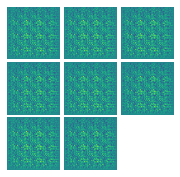

(8, 1, 64, 64)
[4/300][50/154]	Loss_D: 0.6954	Loss_G: 0.6911	D(x): 1.0000	D(G(z)): 0.5011 / 0.5010
label is ['A']


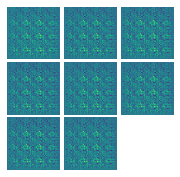

(8, 1, 64, 64)
[4/300][100/154]	Loss_D: 0.7136	Loss_G: 0.6922	D(x): 0.9812	D(G(z)): 0.5004 / 0.5005
label is ['A']


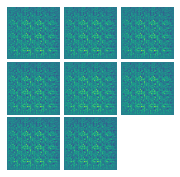

(8, 1, 64, 64)
[4/300][150/154]	Loss_D: 0.6999	Loss_G: 0.6933	D(x): 0.9932	D(G(z)): 0.4999 / 0.4999
label is ['A']


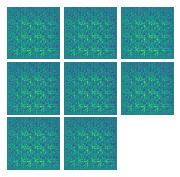

(8, 1, 64, 64)
[5/300][0/154]	Loss_D: 0.6932	Loss_G: 0.6933	D(x): 0.9999	D(G(z)): 0.5000 / 0.4999
label is ['A']


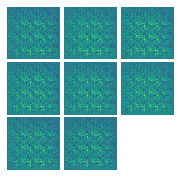

(8, 1, 64, 64)
[5/300][50/154]	Loss_D: 0.6932	Loss_G: 0.6932	D(x): 1.0000	D(G(z)): 0.5000 / 0.5000
label is ['A']


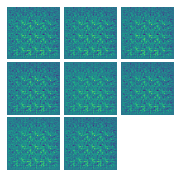

(8, 1, 64, 64)
[5/300][100/154]	Loss_D: 0.7104	Loss_G: 0.6929	D(x): 0.9834	D(G(z)): 0.5000 / 0.5001
label is ['A']


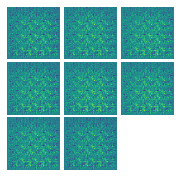

(8, 1, 64, 64)
[5/300][150/154]	Loss_D: 0.6993	Loss_G: 0.6931	D(x): 0.9941	D(G(z)): 0.5000 / 0.5000
label is ['A']


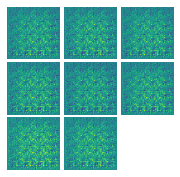

(8, 1, 64, 64)
[6/300][0/154]	Loss_D: 0.6934	Loss_G: 0.6930	D(x): 0.9999	D(G(z)): 0.5001 / 0.5001
label is ['A']


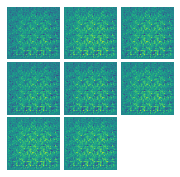

(8, 1, 64, 64)
[6/300][50/154]	Loss_D: 0.6931	Loss_G: 0.6932	D(x): 1.0000	D(G(z)): 0.5000 / 0.5000
label is ['A']


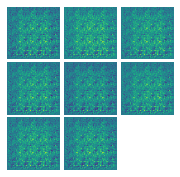

(8, 1, 64, 64)
[6/300][100/154]	Loss_D: 0.6976	Loss_G: 0.6917	D(x): 0.9967	D(G(z)): 0.5006 / 0.5007
label is ['A']


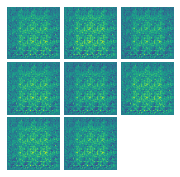

(8, 1, 64, 64)
[6/300][150/154]	Loss_D: 0.6953	Loss_G: 0.6918	D(x): 0.9992	D(G(z)): 0.5007 / 0.5007
label is ['A']


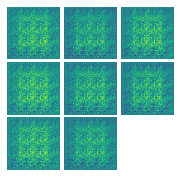

(8, 1, 64, 64)
[7/300][0/154]	Loss_D: 0.6946	Loss_G: 0.6917	D(x): 1.0000	D(G(z)): 0.5007 / 0.5007
label is ['A']


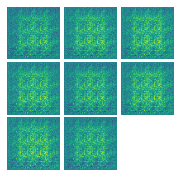

(8, 1, 64, 64)
[7/300][50/154]	Loss_D: 0.6942	Loss_G: 0.6922	D(x): 1.0000	D(G(z)): 0.5005 / 0.5005
label is ['A']


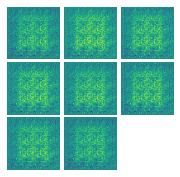

(8, 1, 64, 64)
[7/300][100/154]	Loss_D: 0.7085	Loss_G: 0.6925	D(x): 0.9855	D(G(z)): 0.5002 / 0.5003
label is ['A']


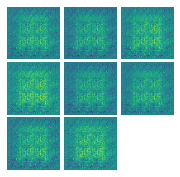

(8, 1, 64, 64)
[7/300][150/154]	Loss_D: 0.6971	Loss_G: 0.6923	D(x): 0.9969	D(G(z)): 0.5004 / 0.5004
label is ['A']


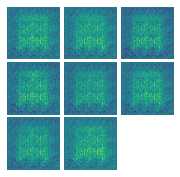

(8, 1, 64, 64)
[8/300][0/154]	Loss_D: 0.6939	Loss_G: 0.6925	D(x): 1.0000	D(G(z)): 0.5004 / 0.5003
label is ['A']


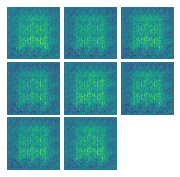

(8, 1, 64, 64)
[8/300][50/154]	Loss_D: 0.6944	Loss_G: 0.6919	D(x): 1.0000	D(G(z)): 0.5006 / 0.5006
label is ['A']


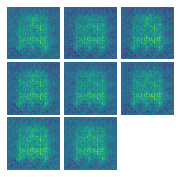

(8, 1, 64, 64)
[8/300][100/154]	Loss_D: 0.7013	Loss_G: 0.6838	D(x): 1.0000	D(G(z)): 0.5041 / 0.5047
label is ['A']


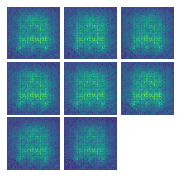

(8, 1, 64, 64)
[8/300][150/154]	Loss_D: 0.7065	Loss_G: 0.6803	D(x): 1.0000	D(G(z)): 0.5066 / 0.5065
label is ['A']


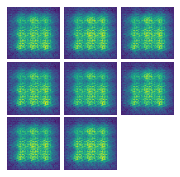

(8, 1, 64, 64)
[9/300][0/154]	Loss_D: 0.7068	Loss_G: 0.6799	D(x): 1.0000	D(G(z)): 0.5068 / 0.5067
label is ['A']


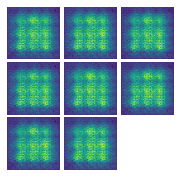

(8, 1, 64, 64)
[9/300][50/154]	Loss_D: 0.7069	Loss_G: 0.6798	D(x): 1.0000	D(G(z)): 0.5068 / 0.5067
label is ['A']


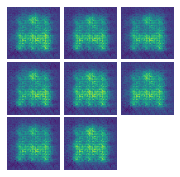

(8, 1, 64, 64)
[9/300][100/154]	Loss_D: 0.7048	Loss_G: 0.6823	D(x): 0.9996	D(G(z)): 0.5056 / 0.5055
label is ['A']


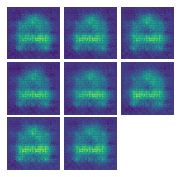

(8, 1, 64, 64)
[9/300][150/154]	Loss_D: 0.7121	Loss_G: 0.6750	D(x): 0.9998	D(G(z)): 0.5093 / 0.5091
label is ['A']


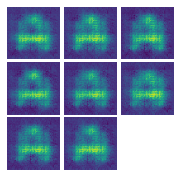

(8, 1, 64, 64)
[10/300][0/154]	Loss_D: 0.7106	Loss_G: 0.6762	D(x): 1.0000	D(G(z)): 0.5087 / 0.5085
label is ['A']


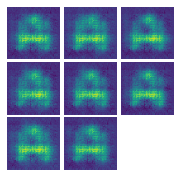

(8, 1, 64, 64)
[10/300][50/154]	Loss_D: 0.7050	Loss_G: 0.6817	D(x): 1.0000	D(G(z)): 0.5059 / 0.5058
label is ['A']


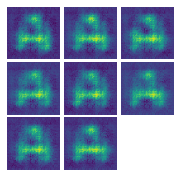

(8, 1, 64, 64)
[10/300][100/154]	Loss_D: 0.7132	Loss_G: 0.6739	D(x): 0.9984	D(G(z)): 0.5092 / 0.5097
label is ['A']


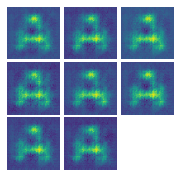

(8, 1, 64, 64)
[10/300][150/154]	Loss_D: 0.7121	Loss_G: 0.6781	D(x): 0.9965	D(G(z)): 0.5077 / 0.5076
label is ['A']


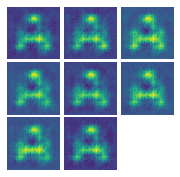

(8, 1, 64, 64)
[11/300][0/154]	Loss_D: 0.7079	Loss_G: 0.6791	D(x): 0.9997	D(G(z)): 0.5072 / 0.5071
label is ['A']


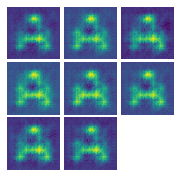

(8, 1, 64, 64)
[11/300][50/154]	Loss_D: 0.7035	Loss_G: 0.6832	D(x): 0.9999	D(G(z)): 0.5051 / 0.5050
label is ['A']


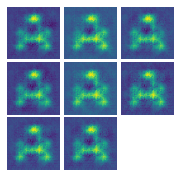

(8, 1, 64, 64)
[11/300][100/154]	Loss_D: 0.7114	Loss_G: 0.6842	D(x): 0.9906	D(G(z)): 0.5043 / 0.5045
label is ['A']


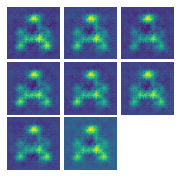

(8, 1, 64, 64)
[11/300][150/154]	Loss_D: 0.7117	Loss_G: 0.6867	D(x): 0.9881	D(G(z)): 0.5031 / 0.5032
label is ['A']


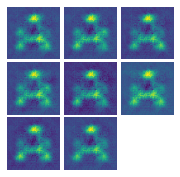

(8, 1, 64, 64)
[12/300][0/154]	Loss_D: 0.6995	Loss_G: 0.6873	D(x): 0.9997	D(G(z)): 0.5030 / 0.5029
label is ['A']


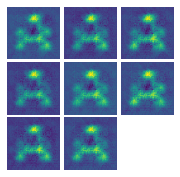

(8, 1, 64, 64)
[12/300][50/154]	Loss_D: 0.6950	Loss_G: 0.6917	D(x): 0.9998	D(G(z)): 0.5008 / 0.5007
label is ['A']


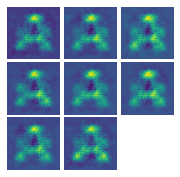

(8, 1, 64, 64)
[12/300][100/154]	Loss_D: 0.7050	Loss_G: 0.6824	D(x): 0.9992	D(G(z)): 0.5055 / 0.5054
label is ['A']


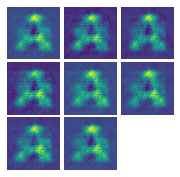

(8, 1, 64, 64)
[12/300][150/154]	Loss_D: 0.7009	Loss_G: 0.6889	D(x): 0.9967	D(G(z)): 0.5022 / 0.5021
label is ['A']


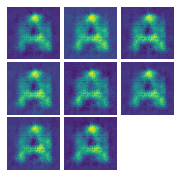

(8, 1, 64, 64)
[13/300][0/154]	Loss_D: 0.6982	Loss_G: 0.6885	D(x): 0.9993	D(G(z)): 0.5022 / 0.5023
label is ['A']


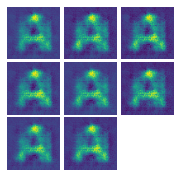

(8, 1, 64, 64)
[13/300][50/154]	Loss_D: 0.6958	Loss_G: 0.6913	D(x): 0.9993	D(G(z)): 0.5010 / 0.5009
label is ['A']


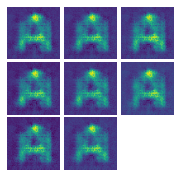

(8, 1, 64, 64)
[13/300][100/154]	Loss_D: 0.7188	Loss_G: 0.6643	D(x): 1.0000	D(G(z)): 0.5126 / 0.5146
label is ['A']


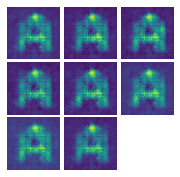

(8, 1, 64, 64)
[13/300][150/154]	Loss_D: 0.7348	Loss_G: 0.6537	D(x): 1.0000	D(G(z)): 0.5204 / 0.5201
label is ['A']


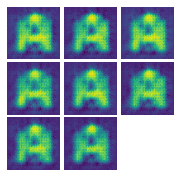

(8, 1, 64, 64)
[14/300][0/154]	Loss_D: 0.7348	Loss_G: 0.6537	D(x): 1.0000	D(G(z)): 0.5204 / 0.5201
label is ['A']


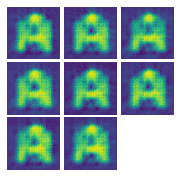

(8, 1, 64, 64)
[14/300][50/154]	Loss_D: 0.7200	Loss_G: 0.6674	D(x): 1.0000	D(G(z)): 0.5132 / 0.5130
label is ['A']


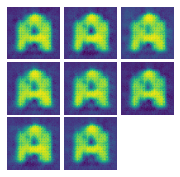

(8, 1, 64, 64)
[14/300][100/154]	Loss_D: 0.7055	Loss_G: 0.6823	D(x): 0.9989	D(G(z)): 0.5056 / 0.5055
label is ['A']


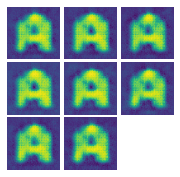

(8, 1, 64, 64)
[14/300][150/154]	Loss_D: 0.6994	Loss_G: 0.6894	D(x): 0.9977	D(G(z)): 0.5020 / 0.5019
label is ['A']


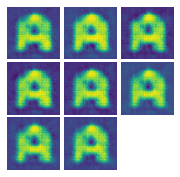

(8, 1, 64, 64)
[15/300][0/154]	Loss_D: 0.6980	Loss_G: 0.6902	D(x): 0.9982	D(G(z)): 0.5015 / 0.5015
label is ['A']


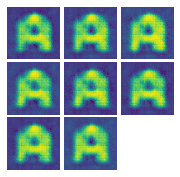

(8, 1, 64, 64)
[15/300][50/154]	Loss_D: 0.6952	Loss_G: 0.6918	D(x): 0.9995	D(G(z)): 0.5008 / 0.5007
label is ['A']


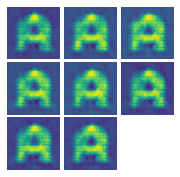

(8, 1, 64, 64)
[15/300][100/154]	Loss_D: 0.7033	Loss_G: 0.6860	D(x): 0.9967	D(G(z)): 0.5034 / 0.5036
label is ['A']


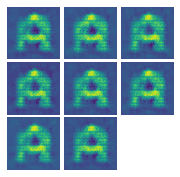

(8, 1, 64, 64)
[15/300][150/154]	Loss_D: 0.7073	Loss_G: 0.6882	D(x): 0.9910	D(G(z)): 0.5025 / 0.5025
label is ['A']


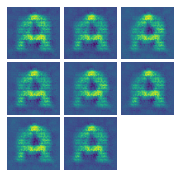

(8, 1, 64, 64)
[16/300][0/154]	Loss_D: 0.6987	Loss_G: 0.6884	D(x): 0.9994	D(G(z)): 0.5025 / 0.5024
label is ['A']


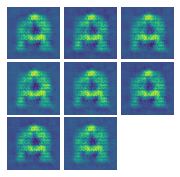

(8, 1, 64, 64)
[16/300][50/154]	Loss_D: 0.6961	Loss_G: 0.6905	D(x): 0.9999	D(G(z)): 0.5014 / 0.5013
label is ['A']


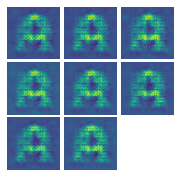

(8, 1, 64, 64)
[16/300][100/154]	Loss_D: 0.7020	Loss_G: 0.6858	D(x): 0.9977	D(G(z)): 0.5033 / 0.5037
label is ['A']


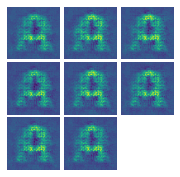

(8, 1, 64, 64)
[16/300][150/154]	Loss_D: 0.7027	Loss_G: 0.6880	D(x): 0.9958	D(G(z)): 0.5026 / 0.5026
label is ['A']


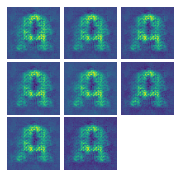

(8, 1, 64, 64)
[17/300][0/154]	Loss_D: 0.6986	Loss_G: 0.6882	D(x): 0.9997	D(G(z)): 0.5026 / 0.5025
label is ['A']


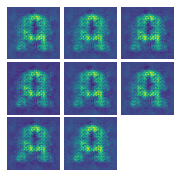

(8, 1, 64, 64)
[17/300][50/154]	Loss_D: 0.6951	Loss_G: 0.6914	D(x): 1.0000	D(G(z)): 0.5010 / 0.5009
label is ['A']


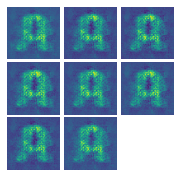

(8, 1, 64, 64)
[17/300][100/154]	Loss_D: 0.7025	Loss_G: 0.6923	D(x): 0.9916	D(G(z)): 0.5004 / 0.5004
label is ['A']


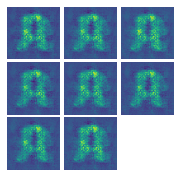

(8, 1, 64, 64)
[17/300][150/154]	Loss_D: 0.7032	Loss_G: 0.6898	D(x): 0.9933	D(G(z)): 0.5016 / 0.5017
label is ['A']


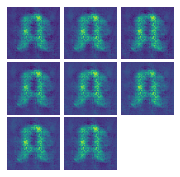

(8, 1, 64, 64)
[18/300][0/154]	Loss_D: 0.6969	Loss_G: 0.6898	D(x): 0.9998	D(G(z)): 0.5018 / 0.5017
label is ['A']


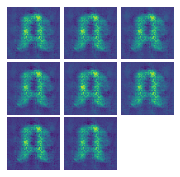

(8, 1, 64, 64)
[18/300][50/154]	Loss_D: 0.6940	Loss_G: 0.6926	D(x): 0.9999	D(G(z)): 0.5004 / 0.5003
label is ['A']


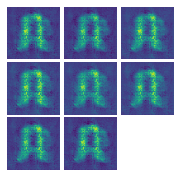

(8, 1, 64, 64)
[18/300][100/154]	Loss_D: 0.7011	Loss_G: 0.6852	D(x): 0.9989	D(G(z)): 0.5034 / 0.5040
label is ['A']


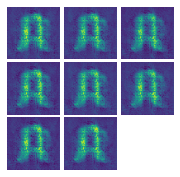

(8, 1, 64, 64)
[18/300][150/154]	Loss_D: 0.6997	Loss_G: 0.6875	D(x): 0.9993	D(G(z)): 0.5029 / 0.5028
label is ['A']


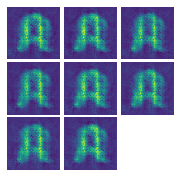

(8, 1, 64, 64)
[19/300][0/154]	Loss_D: 0.6986	Loss_G: 0.6880	D(x): 0.9999	D(G(z)): 0.5027 / 0.5026
label is ['A']


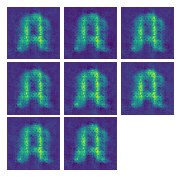

(8, 1, 64, 64)
[19/300][50/154]	Loss_D: 0.6957	Loss_G: 0.6909	D(x): 0.9998	D(G(z)): 0.5012 / 0.5011
label is ['A']


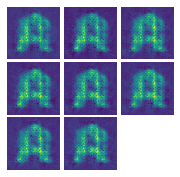

(8, 1, 64, 64)
[19/300][100/154]	Loss_D: 0.7080	Loss_G: 0.6910	D(x): 0.9873	D(G(z)): 0.5009 / 0.5011
label is ['A']


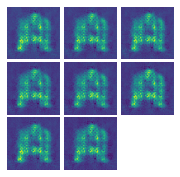

(8, 1, 64, 64)
[19/300][150/154]	Loss_D: 0.7042	Loss_G: 0.6820	D(x): 0.9997	D(G(z)): 0.5054 / 0.5056
label is ['A']


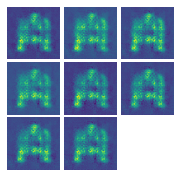

(8, 1, 64, 64)
[20/300][0/154]	Loss_D: 0.7048	Loss_G: 0.6818	D(x): 1.0000	D(G(z)): 0.5058 / 0.5057
label is ['A']


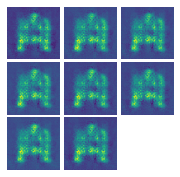

(8, 1, 64, 64)
[20/300][50/154]	Loss_D: 0.6981	Loss_G: 0.6885	D(x): 1.0000	D(G(z)): 0.5025 / 0.5023
label is ['A']


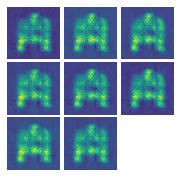

(8, 1, 64, 64)
[20/300][100/154]	Loss_D: 0.7100	Loss_G: 0.6909	D(x): 0.9853	D(G(z)): 0.5008 / 0.5011
label is ['A']


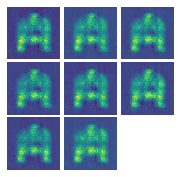

(8, 1, 64, 64)
[20/300][150/154]	Loss_D: 0.6970	Loss_G: 0.6929	D(x): 0.9963	D(G(z)): 0.5001 / 0.5001
label is ['A']


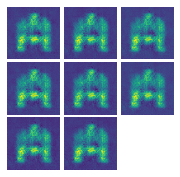

(8, 1, 64, 64)
[21/300][0/154]	Loss_D: 0.6929	Loss_G: 0.6936	D(x): 0.9999	D(G(z)): 0.4998 / 0.4998
label is ['A']


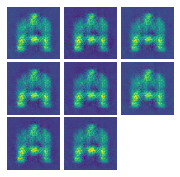

(8, 1, 64, 64)
[21/300][50/154]	Loss_D: 0.6896	Loss_G: 0.6970	D(x): 0.9998	D(G(z)): 0.4982 / 0.4981
label is ['A']


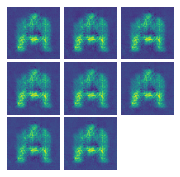

(8, 1, 64, 64)
[21/300][100/154]	Loss_D: 0.7078	Loss_G: 0.6789	D(x): 1.0000	D(G(z)): 0.5073 / 0.5072
label is ['A']


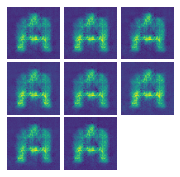

(8, 1, 64, 64)
[21/300][150/154]	Loss_D: 0.7039	Loss_G: 0.6828	D(x): 1.0000	D(G(z)): 0.5053 / 0.5052
label is ['A']


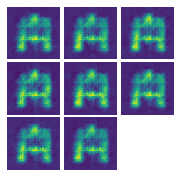

(8, 1, 64, 64)
[22/300][0/154]	Loss_D: 0.7032	Loss_G: 0.6835	D(x): 1.0000	D(G(z)): 0.5050 / 0.5048
label is ['A']


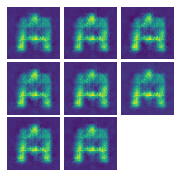

(8, 1, 64, 64)
[22/300][50/154]	Loss_D: 0.6958	Loss_G: 0.6907	D(x): 1.0000	D(G(z)): 0.5013 / 0.5012
label is ['A']


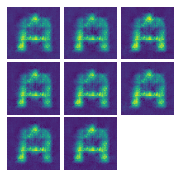

(8, 1, 64, 64)
[22/300][100/154]	Loss_D: 0.6973	Loss_G: 0.6894	D(x): 0.9992	D(G(z)): 0.5017 / 0.5019
label is ['A']


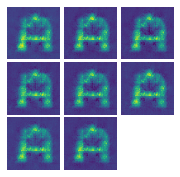

(8, 1, 64, 64)
[22/300][150/154]	Loss_D: 0.6951	Loss_G: 0.6919	D(x): 0.9994	D(G(z)): 0.5007 / 0.5006
label is ['A']


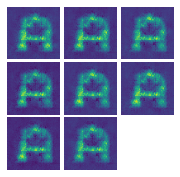

(8, 1, 64, 64)
[23/300][0/154]	Loss_D: 0.6949	Loss_G: 0.6918	D(x): 0.9997	D(G(z)): 0.5007 / 0.5007
label is ['A']


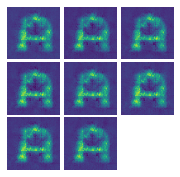

(8, 1, 64, 64)
[23/300][50/154]	Loss_D: 0.6931	Loss_G: 0.6934	D(x): 0.9999	D(G(z)): 0.4999 / 0.4999
label is ['A']


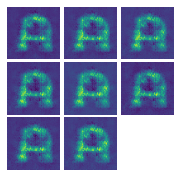

(8, 1, 64, 64)
[23/300][100/154]	Loss_D: 0.7059	Loss_G: 0.6784	D(x): 1.0000	D(G(z)): 0.5063 / 0.5074
label is ['A']


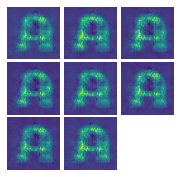

(8, 1, 64, 64)
[23/300][150/154]	Loss_D: 0.7171	Loss_G: 0.6701	D(x): 1.0000	D(G(z)): 0.5118 / 0.5117
label is ['A']


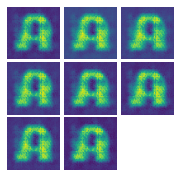

(8, 1, 64, 64)
[24/300][0/154]	Loss_D: 0.7156	Loss_G: 0.6716	D(x): 1.0000	D(G(z)): 0.5111 / 0.5109
label is ['A']


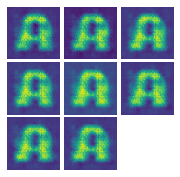

(8, 1, 64, 64)
[24/300][50/154]	Loss_D: 0.7043	Loss_G: 0.6824	D(x): 1.0000	D(G(z)): 0.5056 / 0.5054
label is ['A']


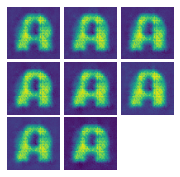

(8, 1, 64, 64)
[24/300][100/154]	Loss_D: 0.6959	Loss_G: 0.6920	D(x): 0.9985	D(G(z)): 0.5006 / 0.5006
label is ['A']


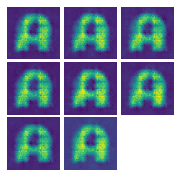

(8, 1, 64, 64)
[24/300][150/154]	Loss_D: 0.6971	Loss_G: 0.6900	D(x): 0.9992	D(G(z)): 0.5016 / 0.5016
label is ['A']


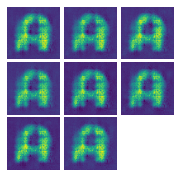

(8, 1, 64, 64)
[25/300][0/154]	Loss_D: 0.6963	Loss_G: 0.6903	D(x): 1.0000	D(G(z)): 0.5015 / 0.5014
label is ['A']


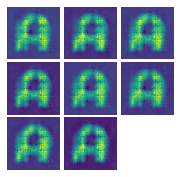

(8, 1, 64, 64)
[25/300][50/154]	Loss_D: 0.6906	Loss_G: 0.6959	D(x): 0.9999	D(G(z)): 0.4987 / 0.4986
label is ['A']


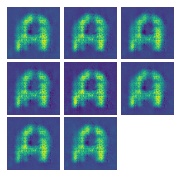

(8, 1, 64, 64)
[25/300][100/154]	Loss_D: 0.6966	Loss_G: 0.6906	D(x): 0.9993	D(G(z)): 0.5014 / 0.5013
label is ['A']


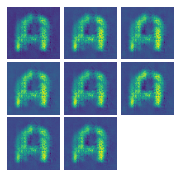

(8, 1, 64, 64)
[25/300][150/154]	Loss_D: 0.6963	Loss_G: 0.6901	D(x): 0.9997	D(G(z)): 0.5014 / 0.5015
label is ['A']


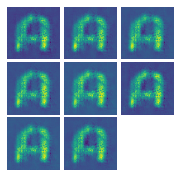

(8, 1, 64, 64)
[26/300][0/154]	Loss_D: 0.6964	Loss_G: 0.6900	D(x): 1.0000	D(G(z)): 0.5016 / 0.5016
label is ['A']


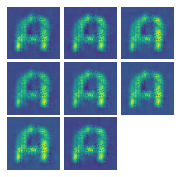

(8, 1, 64, 64)
[26/300][50/154]	Loss_D: 0.6920	Loss_G: 0.6945	D(x): 1.0000	D(G(z)): 0.4994 / 0.4993
label is ['A']


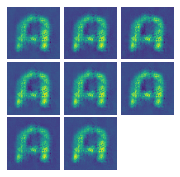

(8, 1, 64, 64)
[26/300][100/154]	Loss_D: 0.7070	Loss_G: 0.6770	D(x): 1.0000	D(G(z)): 0.5069 / 0.5081
label is ['A']


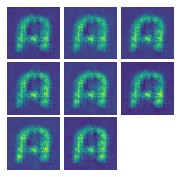

(8, 1, 64, 64)
[26/300][150/154]	Loss_D: 0.7270	Loss_G: 0.6607	D(x): 1.0000	D(G(z)): 0.5167 / 0.5165
label is ['A']


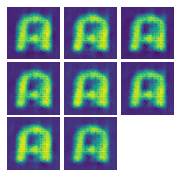

(8, 1, 64, 64)
[27/300][0/154]	Loss_D: 0.7272	Loss_G: 0.6606	D(x): 1.0000	D(G(z)): 0.5167 / 0.5165
label is ['A']


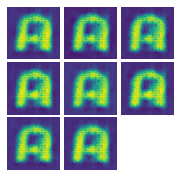

(8, 1, 64, 64)
[27/300][50/154]	Loss_D: 0.7148	Loss_G: 0.6723	D(x): 1.0000	D(G(z)): 0.5107 / 0.5106
label is ['A']


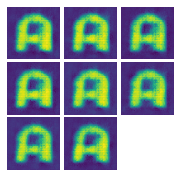

(8, 1, 64, 64)
[27/300][100/154]	Loss_D: 0.7045	Loss_G: 0.6825	D(x): 0.9996	D(G(z)): 0.5055 / 0.5053
label is ['A']


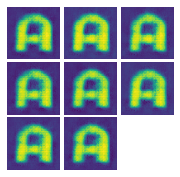

(8, 1, 64, 64)
[27/300][150/154]	Loss_D: 0.6967	Loss_G: 0.6905	D(x): 0.9993	D(G(z)): 0.5014 / 0.5013
label is ['A']


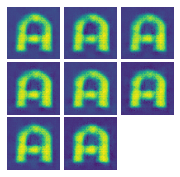

(8, 1, 64, 64)
[28/300][0/154]	Loss_D: 0.6958	Loss_G: 0.6908	D(x): 0.9999	D(G(z)): 0.5013 / 0.5012
label is ['A']


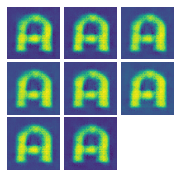

(8, 1, 64, 64)
[28/300][50/154]	Loss_D: 0.6917	Loss_G: 0.6949	D(x): 0.9999	D(G(z)): 0.4992 / 0.4991
label is ['A']


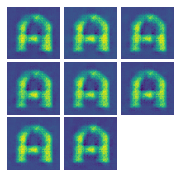

(8, 1, 64, 64)
[28/300][100/154]	Loss_D: 0.7053	Loss_G: 0.6815	D(x): 0.9997	D(G(z)): 0.5059 / 0.5058
label is ['A']


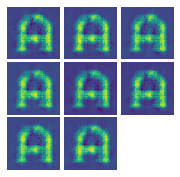

(8, 1, 64, 64)
[28/300][150/154]	Loss_D: 0.7011	Loss_G: 0.6860	D(x): 0.9994	D(G(z)): 0.5037 / 0.5036
label is ['A']


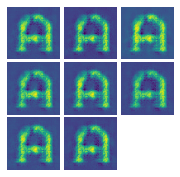

(8, 1, 64, 64)
[29/300][0/154]	Loss_D: 0.6999	Loss_G: 0.6866	D(x): 1.0000	D(G(z)): 0.5034 / 0.5033
label is ['A']


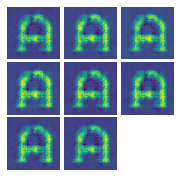

(8, 1, 64, 64)
[29/300][50/154]	Loss_D: 0.6959	Loss_G: 0.6905	D(x): 1.0000	D(G(z)): 0.5014 / 0.5013
label is ['A']


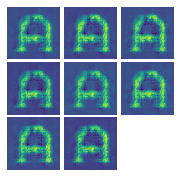

(8, 1, 64, 64)
[29/300][100/154]	Loss_D: 0.7062	Loss_G: 0.6788	D(x): 0.9997	D(G(z)): 0.5064 / 0.5072
label is ['A']


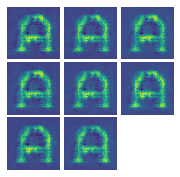

(8, 1, 64, 64)
[29/300][150/154]	Loss_D: 0.7148	Loss_G: 0.6722	D(x): 0.9999	D(G(z)): 0.5107 / 0.5106
label is ['A']


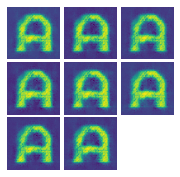

(8, 1, 64, 64)
[30/300][0/154]	Loss_D: 0.7149	Loss_G: 0.6721	D(x): 1.0000	D(G(z)): 0.5108 / 0.5107
label is ['A']


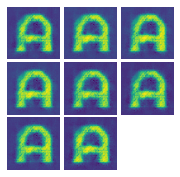

(8, 1, 64, 64)
[30/300][50/154]	Loss_D: 0.7099	Loss_G: 0.6769	D(x): 1.0000	D(G(z)): 0.5083 / 0.5082
label is ['A']


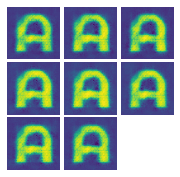

(8, 1, 64, 64)
[30/300][100/154]	Loss_D: 0.7056	Loss_G: 0.6842	D(x): 0.9968	D(G(z)): 0.5046 / 0.5045
label is ['A']


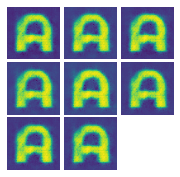

(8, 1, 64, 64)
[30/300][150/154]	Loss_D: 0.7005	Loss_G: 0.6916	D(x): 0.9944	D(G(z)): 0.5008 / 0.5008
label is ['A']


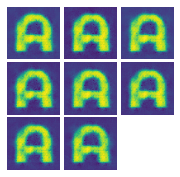

(8, 1, 64, 64)
[31/300][0/154]	Loss_D: 0.6943	Loss_G: 0.6922	D(x): 1.0000	D(G(z)): 0.5006 / 0.5005
label is ['A']


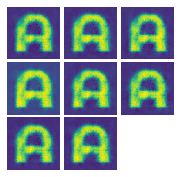

(8, 1, 64, 64)
[31/300][50/154]	Loss_D: 0.6900	Loss_G: 0.6965	D(x): 1.0000	D(G(z)): 0.4984 / 0.4983
label is ['A']


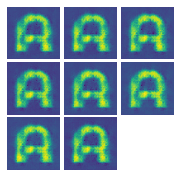

(8, 1, 64, 64)
[31/300][100/154]	Loss_D: 0.7022	Loss_G: 0.6852	D(x): 0.9991	D(G(z)): 0.5041 / 0.5040
label is ['A']


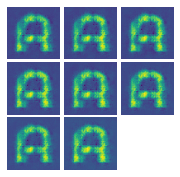

(8, 1, 64, 64)
[31/300][150/154]	Loss_D: 0.6995	Loss_G: 0.6885	D(x): 0.9984	D(G(z)): 0.5024 / 0.5023
label is ['A']


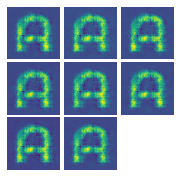

(8, 1, 64, 64)
[32/300][0/154]	Loss_D: 0.6978	Loss_G: 0.6887	D(x): 1.0000	D(G(z)): 0.5023 / 0.5022
label is ['A']


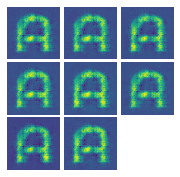

(8, 1, 64, 64)
[32/300][50/154]	Loss_D: 0.6947	Loss_G: 0.6918	D(x): 1.0000	D(G(z)): 0.5008 / 0.5007
label is ['A']


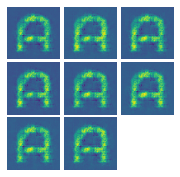

(8, 1, 64, 64)
[32/300][100/154]	Loss_D: 0.7055	Loss_G: 0.6804	D(x): 0.9990	D(G(z)): 0.5056 / 0.5064
label is ['A']


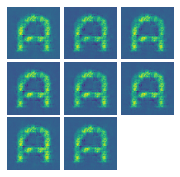

(8, 1, 64, 64)
[32/300][150/154]	Loss_D: 0.7096	Loss_G: 0.6774	D(x): 0.9996	D(G(z)): 0.5080 / 0.5079
label is ['A']


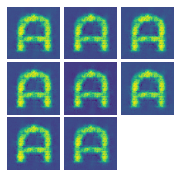

(8, 1, 64, 64)
[33/300][0/154]	Loss_D: 0.7087	Loss_G: 0.6780	D(x): 1.0000	D(G(z)): 0.5077 / 0.5076
label is ['A']


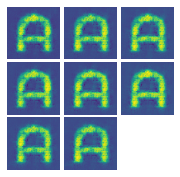

(8, 1, 64, 64)
[33/300][50/154]	Loss_D: 0.7037	Loss_G: 0.6829	D(x): 1.0000	D(G(z)): 0.5052 / 0.5051
label is ['A']


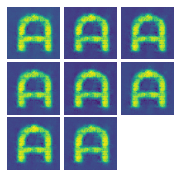

(8, 1, 64, 64)
[33/300][100/154]	Loss_D: 0.7086	Loss_G: 0.6877	D(x): 0.9901	D(G(z)): 0.5027 / 0.5028
label is ['A']


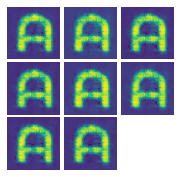

(8, 1, 64, 64)
[33/300][150/154]	Loss_D: 0.7040	Loss_G: 0.6924	D(x): 0.9901	D(G(z)): 0.5004 / 0.5004
label is ['A']


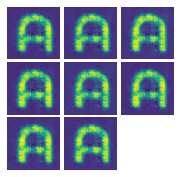

(8, 1, 64, 64)
[34/300][0/154]	Loss_D: 0.6937	Loss_G: 0.6928	D(x): 1.0000	D(G(z)): 0.5003 / 0.5002
label is ['A']


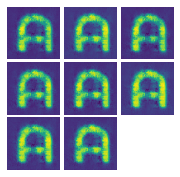

(8, 1, 64, 64)
[34/300][50/154]	Loss_D: 0.6916	Loss_G: 0.6948	D(x): 1.0000	D(G(z)): 0.4992 / 0.4992
label is ['A']


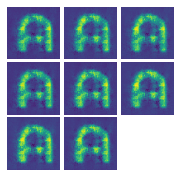

(8, 1, 64, 64)
[34/300][100/154]	Loss_D: 0.7035	Loss_G: 0.6845	D(x): 0.9985	D(G(z)): 0.5044 / 0.5044
label is ['A']


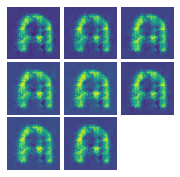

(8, 1, 64, 64)
[34/300][150/154]	Loss_D: 0.7011	Loss_G: 0.6874	D(x): 0.9979	D(G(z)): 0.5029 / 0.5029
label is ['A']


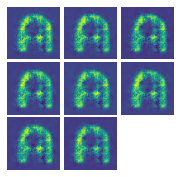

(8, 1, 64, 64)
[35/300][0/154]	Loss_D: 0.6988	Loss_G: 0.6877	D(x): 1.0000	D(G(z)): 0.5028 / 0.5028
label is ['A']


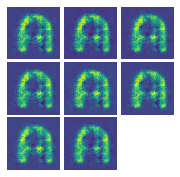

(8, 1, 64, 64)
[35/300][50/154]	Loss_D: 0.6956	Loss_G: 0.6909	D(x): 1.0000	D(G(z)): 0.5012 / 0.5011
label is ['A']


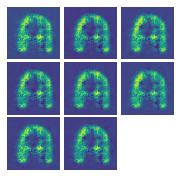

(8, 1, 64, 64)
[35/300][100/154]	Loss_D: 0.7022	Loss_G: 0.6890	D(x): 0.9947	D(G(z)): 0.5018 / 0.5021
label is ['A']


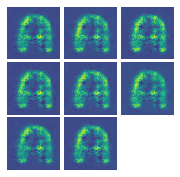

(8, 1, 64, 64)
[35/300][150/154]	Loss_D: 0.7043	Loss_G: 0.6910	D(x): 0.9913	D(G(z)): 0.5011 / 0.5011
label is ['A']


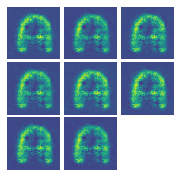

(8, 1, 64, 64)
[36/300][0/154]	Loss_D: 0.6953	Loss_G: 0.6912	D(x): 1.0000	D(G(z)): 0.5010 / 0.5010
label is ['A']


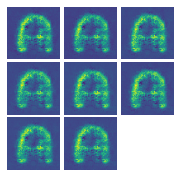

(8, 1, 64, 64)
[36/300][50/154]	Loss_D: 0.6928	Loss_G: 0.6936	D(x): 1.0000	D(G(z)): 0.4998 / 0.4998
label is ['A']


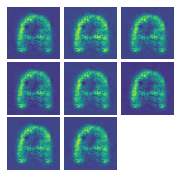

(8, 1, 64, 64)
[36/300][100/154]	Loss_D: 0.7051	Loss_G: 0.6920	D(x): 0.9893	D(G(z)): 0.5005 / 0.5006
label is ['A']


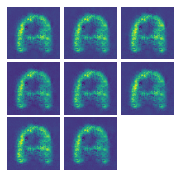

(8, 1, 64, 64)
[36/300][150/154]	Loss_D: 0.7236	Loss_G: 0.6931	D(x): 0.9715	D(G(z)): 0.4999 / 0.5000
label is ['A']


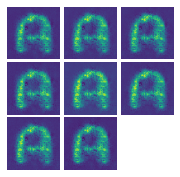

(8, 1, 64, 64)
[37/300][0/154]	Loss_D: 0.6936	Loss_G: 0.6929	D(x): 0.9999	D(G(z)): 0.5002 / 0.5001
label is ['A']


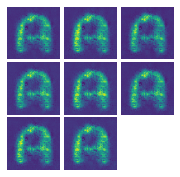

(8, 1, 64, 64)
[37/300][50/154]	Loss_D: 0.6905	Loss_G: 0.6960	D(x): 1.0000	D(G(z)): 0.4986 / 0.4986
label is ['A']


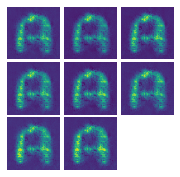

(8, 1, 64, 64)
[37/300][100/154]	Loss_D: 0.7028	Loss_G: 0.6841	D(x): 0.9996	D(G(z)): 0.5046 / 0.5046
label is ['A']


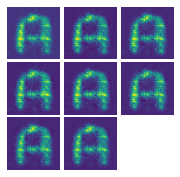

(8, 1, 64, 64)
[37/300][150/154]	Loss_D: 0.7031	Loss_G: 0.6848	D(x): 0.9985	D(G(z)): 0.5042 / 0.5042
label is ['A']


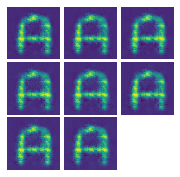

(8, 1, 64, 64)
[38/300][0/154]	Loss_D: 0.7013	Loss_G: 0.6853	D(x): 1.0000	D(G(z)): 0.5040 / 0.5040
label is ['A']


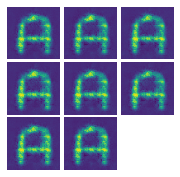

(8, 1, 64, 64)
[38/300][50/154]	Loss_D: 0.6965	Loss_G: 0.6900	D(x): 1.0000	D(G(z)): 0.5017 / 0.5016
label is ['A']


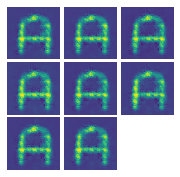

(8, 1, 64, 64)
[38/300][100/154]	Loss_D: 0.7035	Loss_G: 0.6842	D(x): 0.9975	D(G(z)): 0.5039 / 0.5045
label is ['A']


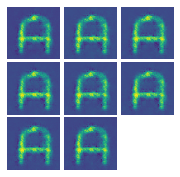

(8, 1, 64, 64)
[38/300][150/154]	Loss_D: 0.7035	Loss_G: 0.6865	D(x): 0.9965	D(G(z)): 0.5034 / 0.5033
label is ['A']


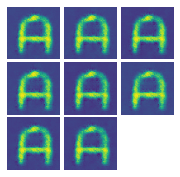

(8, 1, 64, 64)
[39/300][0/154]	Loss_D: 0.6994	Loss_G: 0.6872	D(x): 1.0000	D(G(z)): 0.5031 / 0.5030
label is ['A']


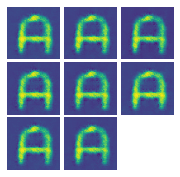

(8, 1, 64, 64)
[39/300][50/154]	Loss_D: 0.6937	Loss_G: 0.6928	D(x): 1.0000	D(G(z)): 0.5003 / 0.5002
label is ['A']


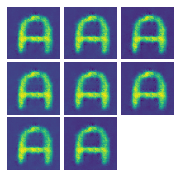

(8, 1, 64, 64)
[39/300][100/154]	Loss_D: 0.7044	Loss_G: 0.6852	D(x): 0.9968	D(G(z)): 0.5040 / 0.5040
label is ['A']


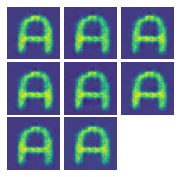

(8, 1, 64, 64)
[39/300][150/154]	Loss_D: 0.7036	Loss_G: 0.6914	D(x): 0.9915	D(G(z)): 0.5009 / 0.5009
label is ['A']


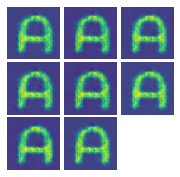

(8, 1, 64, 64)
[40/300][0/154]	Loss_D: 0.6948	Loss_G: 0.6918	D(x): 0.9999	D(G(z)): 0.5008 / 0.5007
label is ['A']


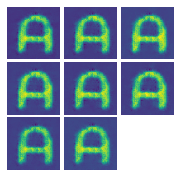

(8, 1, 64, 64)
[40/300][50/154]	Loss_D: 0.6897	Loss_G: 0.6968	D(x): 1.0000	D(G(z)): 0.4983 / 0.4982
label is ['A']


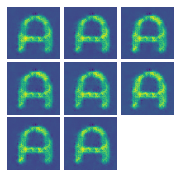

(8, 1, 64, 64)
[40/300][100/154]	Loss_D: 0.7046	Loss_G: 0.6827	D(x): 0.9993	D(G(z)): 0.5053 / 0.5053
label is ['A']


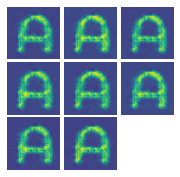

(8, 1, 64, 64)
[40/300][150/154]	Loss_D: 0.7013	Loss_G: 0.6870	D(x): 0.9982	D(G(z)): 0.5031 / 0.5031
label is ['A']


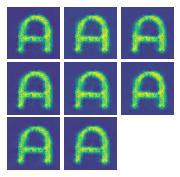

(8, 1, 64, 64)
[41/300][0/154]	Loss_D: 0.6989	Loss_G: 0.6876	D(x): 1.0000	D(G(z)): 0.5029 / 0.5028
label is ['A']


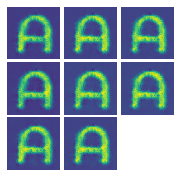

(8, 1, 64, 64)
[41/300][50/154]	Loss_D: 0.6938	Loss_G: 0.6927	D(x): 1.0000	D(G(z)): 0.5003 / 0.5002
label is ['A']


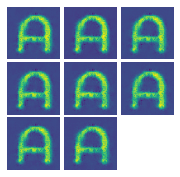

(8, 1, 64, 64)
[41/300][100/154]	Loss_D: 0.7024	Loss_G: 0.6898	D(x): 0.9942	D(G(z)): 0.5017 / 0.5017
label is ['A']


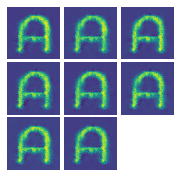

(8, 1, 64, 64)
[41/300][150/154]	Loss_D: 0.7198	Loss_G: 0.6936	D(x): 0.9740	D(G(z)): 0.4996 / 0.4998
label is ['A']


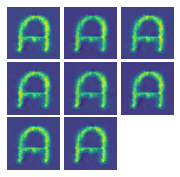

(8, 1, 64, 64)
[42/300][0/154]	Loss_D: 0.6932	Loss_G: 0.6932	D(x): 1.0000	D(G(z)): 0.5000 / 0.5000
label is ['A']


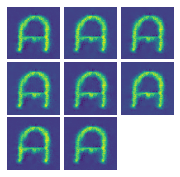

(8, 1, 64, 64)
[42/300][50/154]	Loss_D: 0.6891	Loss_G: 0.6973	D(x): 1.0000	D(G(z)): 0.4980 / 0.4979
label is ['A']


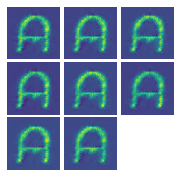

(8, 1, 64, 64)
[42/300][100/154]	Loss_D: 0.7106	Loss_G: 0.6763	D(x): 0.9998	D(G(z)): 0.5086 / 0.5085
label is ['A']


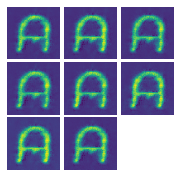

(8, 1, 64, 64)
[42/300][150/154]	Loss_D: 0.7077	Loss_G: 0.6797	D(x): 0.9993	D(G(z)): 0.5069 / 0.5068
label is ['A']


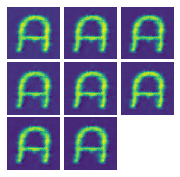

(8, 1, 64, 64)
[43/300][0/154]	Loss_D: 0.7063	Loss_G: 0.6804	D(x): 1.0000	D(G(z)): 0.5065 / 0.5064
label is ['A']


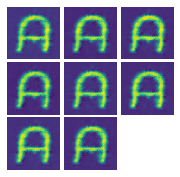

(8, 1, 64, 64)
[43/300][50/154]	Loss_D: 0.6997	Loss_G: 0.6868	D(x): 1.0000	D(G(z)): 0.5033 / 0.5032
label is ['A']


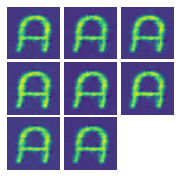

(8, 1, 64, 64)
[43/300][100/154]	Loss_D: 0.7022	Loss_G: 0.6893	D(x): 0.9946	D(G(z)): 0.5018 / 0.5019
label is ['A']


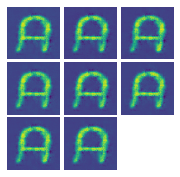

(8, 1, 64, 64)
[43/300][150/154]	Loss_D: 0.7073	Loss_G: 0.6928	D(x): 0.9866	D(G(z)): 0.5002 / 0.5002
label is ['A']


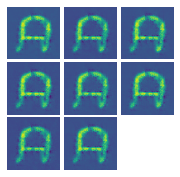

(8, 1, 64, 64)
[44/300][0/154]	Loss_D: 0.6937	Loss_G: 0.6928	D(x): 1.0000	D(G(z)): 0.5002 / 0.5002
label is ['A']


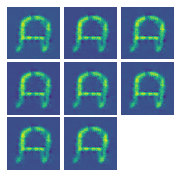

(8, 1, 64, 64)
[44/300][50/154]	Loss_D: 0.6914	Loss_G: 0.6950	D(x): 1.0000	D(G(z)): 0.4991 / 0.4991
label is ['A']


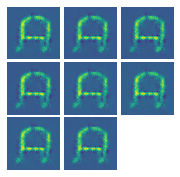

(8, 1, 64, 64)
[44/300][100/154]	Loss_D: 0.7023	Loss_G: 0.6849	D(x): 0.9993	D(G(z)): 0.5042 / 0.5041
label is ['A']


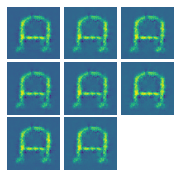

(8, 1, 64, 64)
[44/300][150/154]	Loss_D: 0.6997	Loss_G: 0.6887	D(x): 0.9981	D(G(z)): 0.5023 / 0.5022
label is ['A']


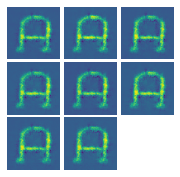

(8, 1, 64, 64)
[45/300][0/154]	Loss_D: 0.6974	Loss_G: 0.6891	D(x): 1.0000	D(G(z)): 0.5021 / 0.5020
label is ['A']


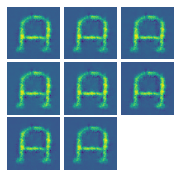

(8, 1, 64, 64)
[45/300][50/154]	Loss_D: 0.6930	Loss_G: 0.6935	D(x): 1.0000	D(G(z)): 0.4999 / 0.4998
label is ['A']


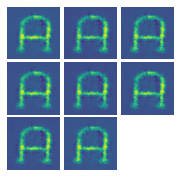

(8, 1, 64, 64)
[45/300][100/154]	Loss_D: 0.7000	Loss_G: 0.6908	D(x): 0.9955	D(G(z)): 0.5012 / 0.5012
label is ['A']


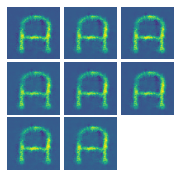

(8, 1, 64, 64)
[45/300][150/154]	Loss_D: 0.7041	Loss_G: 0.6942	D(x): 0.9883	D(G(z)): 0.4995 / 0.4995
label is ['A']


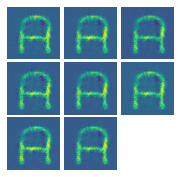

(8, 1, 64, 64)
[46/300][0/154]	Loss_D: 0.6923	Loss_G: 0.6941	D(x): 1.0000	D(G(z)): 0.4996 / 0.4995
label is ['A']


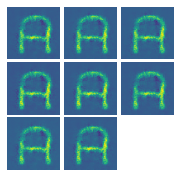

(8, 1, 64, 64)
[46/300][50/154]	Loss_D: 0.6906	Loss_G: 0.6957	D(x): 1.0000	D(G(z)): 0.4987 / 0.4987
label is ['A']


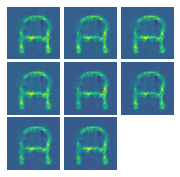

(8, 1, 64, 64)
[46/300][100/154]	Loss_D: 0.7060	Loss_G: 0.6807	D(x): 0.9998	D(G(z)): 0.5063 / 0.5063
label is ['A']


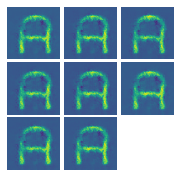

(8, 1, 64, 64)
[46/300][150/154]	Loss_D: 0.7057	Loss_G: 0.6811	D(x): 0.9998	D(G(z)): 0.5062 / 0.5061
label is ['A']


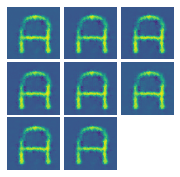

(8, 1, 64, 64)
[47/300][0/154]	Loss_D: 0.7053	Loss_G: 0.6813	D(x): 1.0000	D(G(z)): 0.5061 / 0.5060
label is ['A']


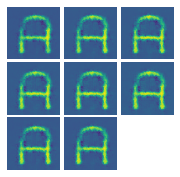

(8, 1, 64, 64)
[47/300][50/154]	Loss_D: 0.6998	Loss_G: 0.6867	D(x): 1.0000	D(G(z)): 0.5033 / 0.5032
label is ['A']


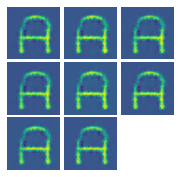

(8, 1, 64, 64)
[47/300][100/154]	Loss_D: 0.7000	Loss_G: 0.6914	D(x): 0.9950	D(G(z)): 0.5009 / 0.5009
label is ['A']


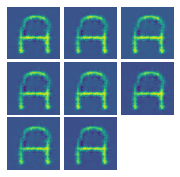

(8, 1, 64, 64)
[47/300][150/154]	Loss_D: 0.6991	Loss_G: 0.6938	D(x): 0.9935	D(G(z)): 0.4997 / 0.4997
label is ['A']


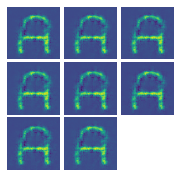

(8, 1, 64, 64)
[48/300][0/154]	Loss_D: 0.6926	Loss_G: 0.6939	D(x): 0.9999	D(G(z)): 0.4997 / 0.4996
label is ['A']


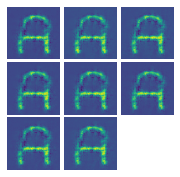

(8, 1, 64, 64)
[48/300][50/154]	Loss_D: 0.6909	Loss_G: 0.6955	D(x): 1.0000	D(G(z)): 0.4989 / 0.4988
label is ['A']


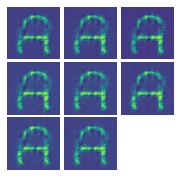

(8, 1, 64, 64)
[48/300][100/154]	Loss_D: 0.7003	Loss_G: 0.6893	D(x): 0.9968	D(G(z)): 0.5020 / 0.5019
label is ['A']


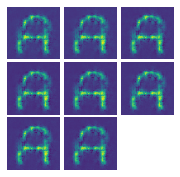

(8, 1, 64, 64)
[48/300][150/154]	Loss_D: 0.6972	Loss_G: 0.6921	D(x): 0.9971	D(G(z)): 0.5006 / 0.5005
label is ['A']


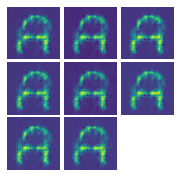

(8, 1, 64, 64)
[49/300][0/154]	Loss_D: 0.6943	Loss_G: 0.6922	D(x): 0.9999	D(G(z)): 0.5005 / 0.5005
label is ['A']


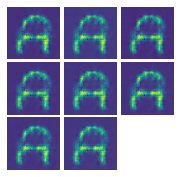

(8, 1, 64, 64)
[49/300][50/154]	Loss_D: 0.6918	Loss_G: 0.6946	D(x): 1.0000	D(G(z)): 0.4993 / 0.4993
label is ['A']


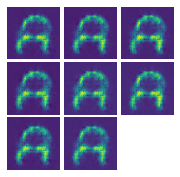

(8, 1, 64, 64)
[49/300][100/154]	Loss_D: 0.7069	Loss_G: 0.6922	D(x): 0.9874	D(G(z)): 0.5004 / 0.5005
label is ['A']


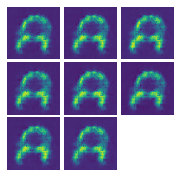

(8, 1, 64, 64)
[49/300][150/154]	Loss_D: 0.6997	Loss_G: 0.6932	D(x): 0.9934	D(G(z)): 0.4999 / 0.5000
label is ['A']


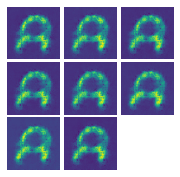

(8, 1, 64, 64)
[50/300][0/154]	Loss_D: 0.6931	Loss_G: 0.6935	D(x): 0.9999	D(G(z)): 0.4999 / 0.4998
label is ['A']


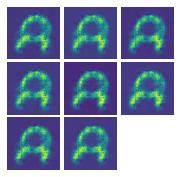

(8, 1, 64, 64)
[50/300][50/154]	Loss_D: 0.6902	Loss_G: 0.6963	D(x): 1.0000	D(G(z)): 0.4985 / 0.4984
label is ['A']


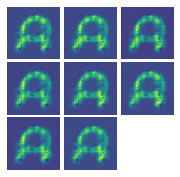

(8, 1, 64, 64)
[50/300][100/154]	Loss_D: 0.7052	Loss_G: 0.6820	D(x): 0.9994	D(G(z)): 0.5057 / 0.5056
label is ['A']


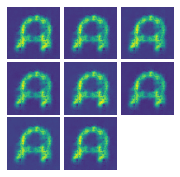

(8, 1, 64, 64)
[50/300][150/154]	Loss_D: 0.7009	Loss_G: 0.6860	D(x): 0.9996	D(G(z)): 0.5037 / 0.5036
label is ['A']


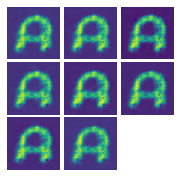

(8, 1, 64, 64)
[51/300][0/154]	Loss_D: 0.7000	Loss_G: 0.6865	D(x): 1.0000	D(G(z)): 0.5034 / 0.5033
label is ['A']


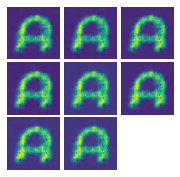

(8, 1, 64, 64)
[51/300][50/154]	Loss_D: 0.6942	Loss_G: 0.6923	D(x): 1.0000	D(G(z)): 0.5005 / 0.5004
label is ['A']


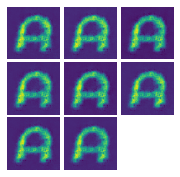

(8, 1, 64, 64)
[51/300][100/154]	Loss_D: 0.7035	Loss_G: 0.6865	D(x): 0.9957	D(G(z)): 0.5030 / 0.5033
label is ['A']


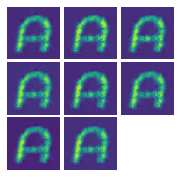

(8, 1, 64, 64)
[51/300][150/154]	Loss_D: 0.6982	Loss_G: 0.6909	D(x): 0.9973	D(G(z)): 0.5012 / 0.5011
label is ['A']


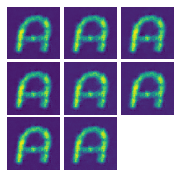

(8, 1, 64, 64)
[52/300][0/154]	Loss_D: 0.6951	Loss_G: 0.6914	D(x): 1.0000	D(G(z)): 0.5010 / 0.5009
label is ['A']


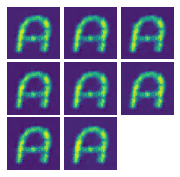

(8, 1, 64, 64)
[52/300][50/154]	Loss_D: 0.6901	Loss_G: 0.6963	D(x): 1.0000	D(G(z)): 0.4985 / 0.4984
label is ['A']


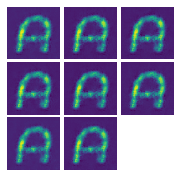

(8, 1, 64, 64)
[52/300][100/154]	Loss_D: 0.7047	Loss_G: 0.6840	D(x): 0.9978	D(G(z)): 0.5046 / 0.5046
label is ['A']


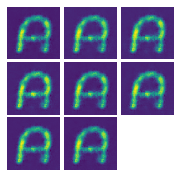

(8, 1, 64, 64)
[52/300][150/154]	Loss_D: 0.7005	Loss_G: 0.6883	D(x): 0.9977	D(G(z)): 0.5025 / 0.5024
label is ['A']


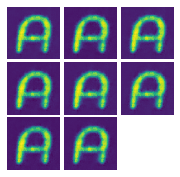

(8, 1, 64, 64)
[53/300][0/154]	Loss_D: 0.6977	Loss_G: 0.6889	D(x): 1.0000	D(G(z)): 0.5022 / 0.5021
label is ['A']


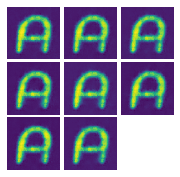

(8, 1, 64, 64)
[53/300][50/154]	Loss_D: 0.6896	Loss_G: 0.6969	D(x): 1.0000	D(G(z)): 0.4982 / 0.4981
label is ['A']


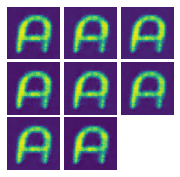

(8, 1, 64, 64)
[53/300][100/154]	Loss_D: 0.7058	Loss_G: 0.6828	D(x): 0.9981	D(G(z)): 0.5053 / 0.5052
label is ['A']


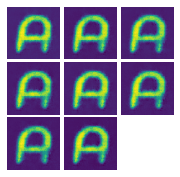

(8, 1, 64, 64)
[53/300][150/154]	Loss_D: 0.6981	Loss_G: 0.6911	D(x): 0.9972	D(G(z)): 0.5011 / 0.5010
label is ['A']


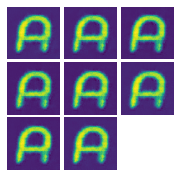

(8, 1, 64, 64)
[54/300][0/154]	Loss_D: 0.6947	Loss_G: 0.6918	D(x): 1.0000	D(G(z)): 0.5008 / 0.5007
label is ['A']


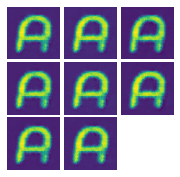

(8, 1, 64, 64)
[54/300][50/154]	Loss_D: 0.6878	Loss_G: 0.6987	D(x): 1.0000	D(G(z)): 0.4973 / 0.4972
label is ['A']


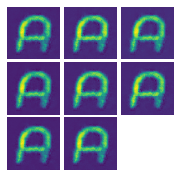

(8, 1, 64, 64)
[54/300][100/154]	Loss_D: 0.7028	Loss_G: 0.6858	D(x): 0.9978	D(G(z)): 0.5037 / 0.5037
label is ['A']


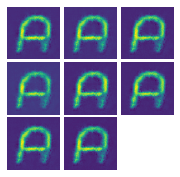

(8, 1, 64, 64)
[54/300][150/154]	Loss_D: 0.6986	Loss_G: 0.6911	D(x): 0.9968	D(G(z)): 0.5011 / 0.5010
label is ['A']


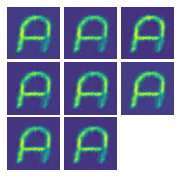

(8, 1, 64, 64)
[55/300][0/154]	Loss_D: 0.6950	Loss_G: 0.6915	D(x): 1.0000	D(G(z)): 0.5009 / 0.5008
label is ['A']


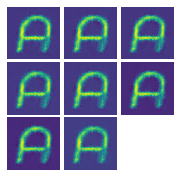

(8, 1, 64, 64)
[55/300][50/154]	Loss_D: 0.6898	Loss_G: 0.6966	D(x): 1.0000	D(G(z)): 0.4983 / 0.4983
label is ['A']


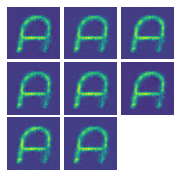

(8, 1, 64, 64)
[55/300][100/154]	Loss_D: 0.7061	Loss_G: 0.6810	D(x): 0.9995	D(G(z)): 0.5062 / 0.5061
label is ['A']


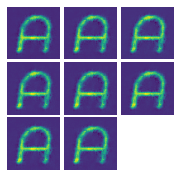

(8, 1, 64, 64)
[55/300][150/154]	Loss_D: 0.7020	Loss_G: 0.6856	D(x): 0.9989	D(G(z)): 0.5039 / 0.5038
label is ['A']


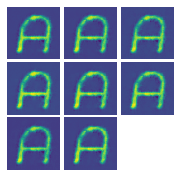

(8, 1, 64, 64)
[56/300][0/154]	Loss_D: 0.7003	Loss_G: 0.6862	D(x): 1.0000	D(G(z)): 0.5036 / 0.5035
label is ['A']


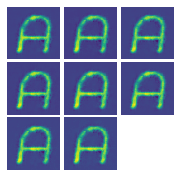

(8, 1, 64, 64)
[56/300][50/154]	Loss_D: 0.6943	Loss_G: 0.6921	D(x): 1.0000	D(G(z)): 0.5006 / 0.5005
label is ['A']


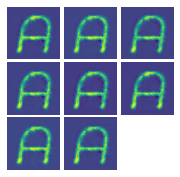

(8, 1, 64, 64)
[56/300][100/154]	Loss_D: 0.7018	Loss_G: 0.6876	D(x): 0.9971	D(G(z)): 0.5029 / 0.5028
label is ['A']


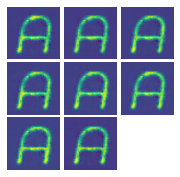

(8, 1, 64, 64)
[56/300][150/154]	Loss_D: 0.6996	Loss_G: 0.6931	D(x): 0.9937	D(G(z)): 0.5000 / 0.5000
label is ['A']


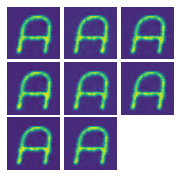

(8, 1, 64, 64)
[57/300][0/154]	Loss_D: 0.6931	Loss_G: 0.6933	D(x): 1.0000	D(G(z)): 0.5000 / 0.4999
label is ['A']


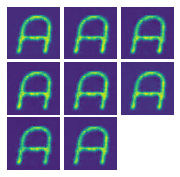

(8, 1, 64, 64)
[57/300][50/154]	Loss_D: 0.6891	Loss_G: 0.6974	D(x): 1.0000	D(G(z)): 0.4979 / 0.4979
label is ['A']


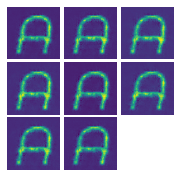

(8, 1, 64, 64)
[57/300][100/154]	Loss_D: 0.7057	Loss_G: 0.6814	D(x): 0.9995	D(G(z)): 0.5060 / 0.5059
label is ['A']


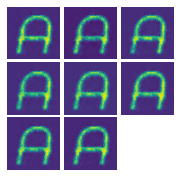

(8, 1, 64, 64)
[57/300][150/154]	Loss_D: 0.7016	Loss_G: 0.6856	D(x): 0.9993	D(G(z)): 0.5039 / 0.5038
label is ['A']


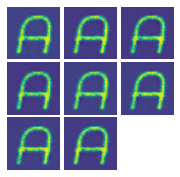

(8, 1, 64, 64)
[58/300][0/154]	Loss_D: 0.7004	Loss_G: 0.6861	D(x): 1.0000	D(G(z)): 0.5036 / 0.5035
label is ['A']


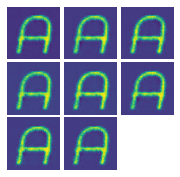

(8, 1, 64, 64)
[58/300][50/154]	Loss_D: 0.6961	Loss_G: 0.6903	D(x): 1.0000	D(G(z)): 0.5015 / 0.5014
label is ['A']


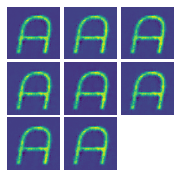

(8, 1, 64, 64)
[58/300][100/154]	Loss_D: 0.7038	Loss_G: 0.6868	D(x): 0.9959	D(G(z)): 0.5032 / 0.5032
label is ['A']


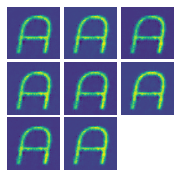

(8, 1, 64, 64)
[58/300][150/154]	Loss_D: 0.6979	Loss_G: 0.6919	D(x): 0.9966	D(G(z)): 0.5007 / 0.5006
label is ['A']


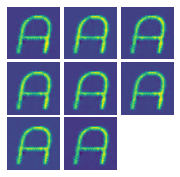

(8, 1, 64, 64)
[59/300][0/154]	Loss_D: 0.6942	Loss_G: 0.6922	D(x): 1.0000	D(G(z)): 0.5005 / 0.5005
label is ['A']


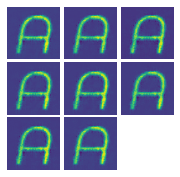

(8, 1, 64, 64)
[59/300][50/154]	Loss_D: 0.6902	Loss_G: 0.6962	D(x): 1.0000	D(G(z)): 0.4985 / 0.4985
label is ['A']


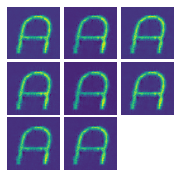

(8, 1, 64, 64)
[59/300][100/154]	Loss_D: 0.7052	Loss_G: 0.6835	D(x): 0.9978	D(G(z)): 0.5049 / 0.5049
label is ['A']


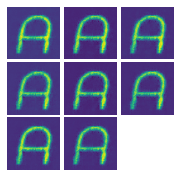

(8, 1, 64, 64)
[59/300][150/154]	Loss_D: 0.6999	Loss_G: 0.6880	D(x): 0.9985	D(G(z)): 0.5026 / 0.5026
label is ['A']


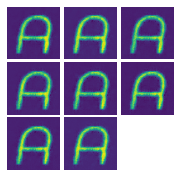

(8, 1, 64, 64)
[60/300][0/154]	Loss_D: 0.6979	Loss_G: 0.6886	D(x): 1.0000	D(G(z)): 0.5024 / 0.5023
label is ['A']


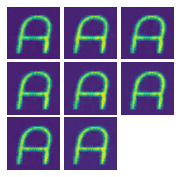

(8, 1, 64, 64)
[60/300][50/154]	Loss_D: 0.6927	Loss_G: 0.6937	D(x): 1.0000	D(G(z)): 0.4998 / 0.4997
label is ['A']


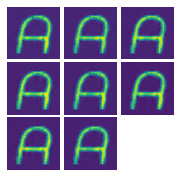

(8, 1, 64, 64)
[60/300][100/154]	Loss_D: 0.7054	Loss_G: 0.6846	D(x): 0.9965	D(G(z)): 0.5044 / 0.5043
label is ['A']


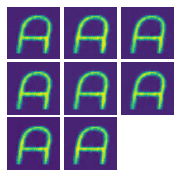

(8, 1, 64, 64)
[60/300][150/154]	Loss_D: 0.6982	Loss_G: 0.6904	D(x): 0.9978	D(G(z)): 0.5014 / 0.5014
label is ['A']


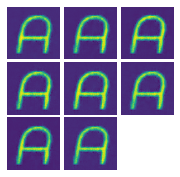

(8, 1, 64, 64)
[61/300][0/154]	Loss_D: 0.6956	Loss_G: 0.6908	D(x): 1.0000	D(G(z)): 0.5012 / 0.5012
label is ['A']


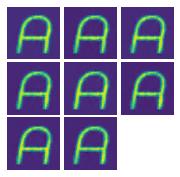

(8, 1, 64, 64)
[61/300][50/154]	Loss_D: 0.6904	Loss_G: 0.6960	D(x): 1.0000	D(G(z)): 0.4986 / 0.4986
label is ['A']


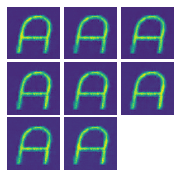

(8, 1, 64, 64)
[61/300][100/154]	Loss_D: 0.7056	Loss_G: 0.6835	D(x): 0.9974	D(G(z)): 0.5049 / 0.5048
label is ['A']


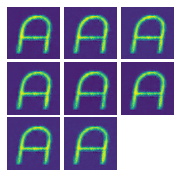

(8, 1, 64, 64)
[61/300][150/154]	Loss_D: 0.6994	Loss_G: 0.6887	D(x): 0.9983	D(G(z)): 0.5023 / 0.5022
label is ['A']


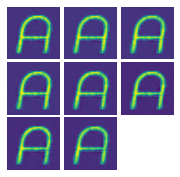

(8, 1, 64, 64)
[62/300][0/154]	Loss_D: 0.6972	Loss_G: 0.6892	D(x): 1.0000	D(G(z)): 0.5020 / 0.5020
label is ['A']


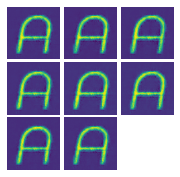

(8, 1, 64, 64)
[62/300][50/154]	Loss_D: 0.6925	Loss_G: 0.6939	D(x): 1.0000	D(G(z)): 0.4997 / 0.4996
label is ['A']


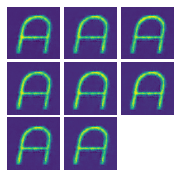

(8, 1, 64, 64)
[62/300][100/154]	Loss_D: 0.7050	Loss_G: 0.6861	D(x): 0.9954	D(G(z)): 0.5036 / 0.5035
label is ['A']


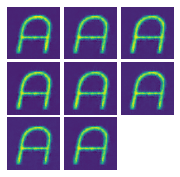

(8, 1, 64, 64)
[62/300][150/154]	Loss_D: 0.6985	Loss_G: 0.6913	D(x): 0.9966	D(G(z)): 0.5010 / 0.5009
label is ['A']


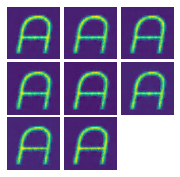

(8, 1, 64, 64)
[63/300][0/154]	Loss_D: 0.6947	Loss_G: 0.6917	D(x): 1.0000	D(G(z)): 0.5008 / 0.5007
label is ['A']


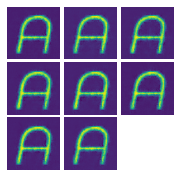

(8, 1, 64, 64)
[63/300][50/154]	Loss_D: 0.6899	Loss_G: 0.6965	D(x): 1.0000	D(G(z)): 0.4984 / 0.4983
label is ['A']


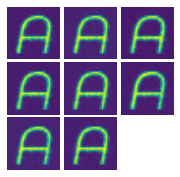

(8, 1, 64, 64)
[63/300][100/154]	Loss_D: 0.7050	Loss_G: 0.6838	D(x): 0.9978	D(G(z)): 0.5048 / 0.5047
label is ['A']


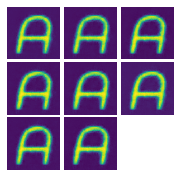

(8, 1, 64, 64)
[63/300][150/154]	Loss_D: 0.6979	Loss_G: 0.6908	D(x): 0.9978	D(G(z)): 0.5013 / 0.5012
label is ['A']


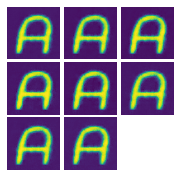

(8, 1, 64, 64)
[64/300][0/154]	Loss_D: 0.6951	Loss_G: 0.6915	D(x): 1.0000	D(G(z)): 0.5009 / 0.5008
label is ['A']


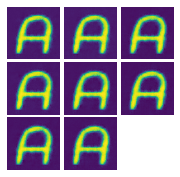

(8, 1, 64, 64)
[64/300][50/154]	Loss_D: 0.6863	Loss_G: 0.7003	D(x): 1.0000	D(G(z)): 0.4966 / 0.4964
label is ['A']


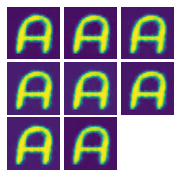

(8, 1, 64, 64)
[64/300][100/154]	Loss_D: 0.7119	Loss_G: 0.6754	D(x): 0.9997	D(G(z)): 0.5091 / 0.5090
label is ['A']


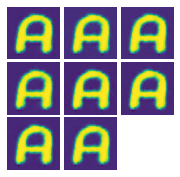

(8, 1, 64, 64)
[64/300][150/154]	Loss_D: 0.6998	Loss_G: 0.6874	D(x): 0.9995	D(G(z)): 0.5030 / 0.5029
label is ['A']


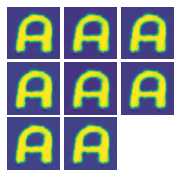

(8, 1, 64, 64)
[65/300][0/154]	Loss_D: 0.6985	Loss_G: 0.6882	D(x): 1.0000	D(G(z)): 0.5026 / 0.5025
label is ['A']


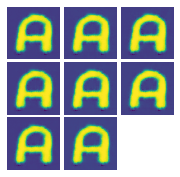

(8, 1, 64, 64)
[65/300][50/154]	Loss_D: 0.6936	Loss_G: 0.6929	D(x): 1.0000	D(G(z)): 0.5002 / 0.5001
label is ['A']


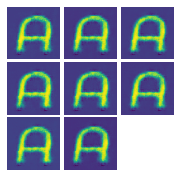

(8, 1, 64, 64)
[65/300][100/154]	Loss_D: 0.7055	Loss_G: 0.6834	D(x): 0.9976	D(G(z)): 0.5049 / 0.5049
label is ['A']


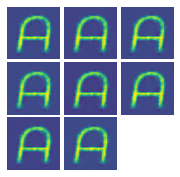

(8, 1, 64, 64)
[65/300][150/154]	Loss_D: 0.7018	Loss_G: 0.6898	D(x): 0.9948	D(G(z)): 0.5017 / 0.5017
label is ['A']


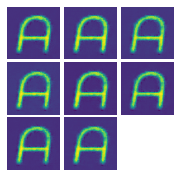

(8, 1, 64, 64)
[66/300][0/154]	Loss_D: 0.6963	Loss_G: 0.6902	D(x): 0.9999	D(G(z)): 0.5015 / 0.5015
label is ['A']


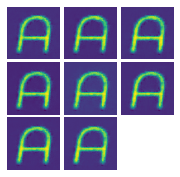

(8, 1, 64, 64)
[66/300][50/154]	Loss_D: 0.6909	Loss_G: 0.6956	D(x): 1.0000	D(G(z)): 0.4989 / 0.4988
label is ['A']


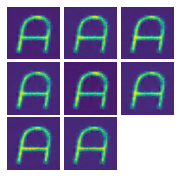

(8, 1, 64, 64)
[66/300][100/154]	Loss_D: 0.7052	Loss_G: 0.6822	D(x): 0.9991	D(G(z)): 0.5056 / 0.5055
label is ['A']


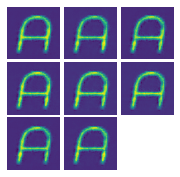

(8, 1, 64, 64)
[66/300][150/154]	Loss_D: 0.7023	Loss_G: 0.6861	D(x): 0.9981	D(G(z)): 0.5036 / 0.5036
label is ['A']


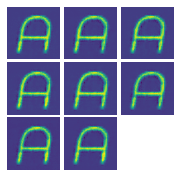

(8, 1, 64, 64)
[67/300][0/154]	Loss_D: 0.6999	Loss_G: 0.6866	D(x): 1.0000	D(G(z)): 0.5034 / 0.5033
label is ['A']


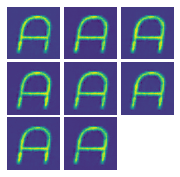

(8, 1, 64, 64)
[67/300][50/154]	Loss_D: 0.6959	Loss_G: 0.6905	D(x): 1.0000	D(G(z)): 0.5014 / 0.5013
label is ['A']


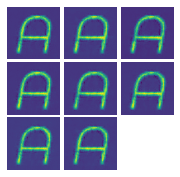

(8, 1, 64, 64)
[67/300][100/154]	Loss_D: 0.7027	Loss_G: 0.6894	D(x): 0.9944	D(G(z)): 0.5019 / 0.5019
label is ['A']


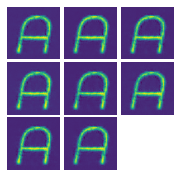

(8, 1, 64, 64)
[67/300][150/154]	Loss_D: 0.7016	Loss_G: 0.6929	D(x): 0.9920	D(G(z)): 0.5002 / 0.5001
label is ['A']


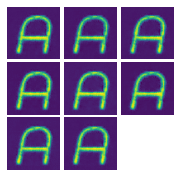

(8, 1, 64, 64)
[68/300][0/154]	Loss_D: 0.6932	Loss_G: 0.6932	D(x): 1.0000	D(G(z)): 0.5000 / 0.5000
label is ['A']


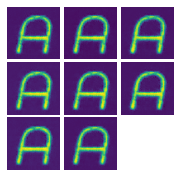

(8, 1, 64, 64)
[68/300][50/154]	Loss_D: 0.6887	Loss_G: 0.6977	D(x): 1.0000	D(G(z)): 0.4978 / 0.4977
label is ['A']


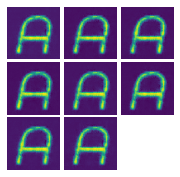

(8, 1, 64, 64)
[68/300][100/154]	Loss_D: 0.7057	Loss_G: 0.6820	D(x): 0.9988	D(G(z)): 0.5056 / 0.5056
label is ['A']


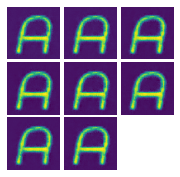

(8, 1, 64, 64)
[68/300][150/154]	Loss_D: 0.7014	Loss_G: 0.6865	D(x): 0.9986	D(G(z)): 0.5034 / 0.5033
label is ['A']


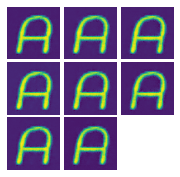

(8, 1, 64, 64)
[69/300][0/154]	Loss_D: 0.6995	Loss_G: 0.6870	D(x): 1.0000	D(G(z)): 0.5032 / 0.5031
label is ['A']


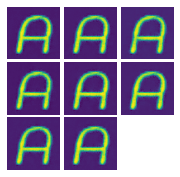

(8, 1, 64, 64)
[69/300][50/154]	Loss_D: 0.6934	Loss_G: 0.6930	D(x): 1.0000	D(G(z)): 0.5001 / 0.5001
label is ['A']


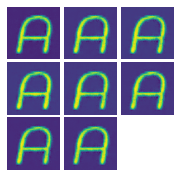

(8, 1, 64, 64)
[69/300][100/154]	Loss_D: 0.7040	Loss_G: 0.6847	D(x): 0.9977	D(G(z)): 0.5043 / 0.5042
label is ['A']


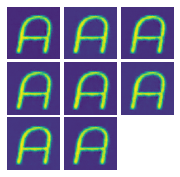

(8, 1, 64, 64)
[69/300][150/154]	Loss_D: 0.6976	Loss_G: 0.6908	D(x): 0.9980	D(G(z)): 0.5012 / 0.5012
label is ['A']


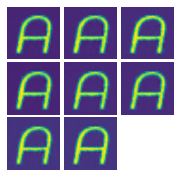

(8, 1, 64, 64)
[70/300][0/154]	Loss_D: 0.6952	Loss_G: 0.6913	D(x): 1.0000	D(G(z)): 0.5010 / 0.5009
label is ['A']


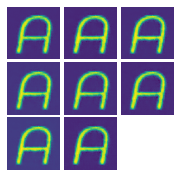

(8, 1, 64, 64)
[70/300][50/154]	Loss_D: 0.6908	Loss_G: 0.6956	D(x): 1.0000	D(G(z)): 0.4988 / 0.4988
label is ['A']


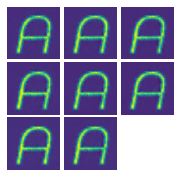

(8, 1, 64, 64)
[70/300][100/154]	Loss_D: 0.7042	Loss_G: 0.6840	D(x): 0.9982	D(G(z)): 0.5046 / 0.5046
label is ['A']


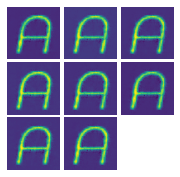

(8, 1, 64, 64)
[70/300][150/154]	Loss_D: 0.6992	Loss_G: 0.6890	D(x): 0.9983	D(G(z)): 0.5021 / 0.5021
label is ['A']


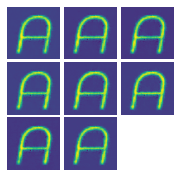

(8, 1, 64, 64)
[71/300][0/154]	Loss_D: 0.6971	Loss_G: 0.6893	D(x): 1.0000	D(G(z)): 0.5020 / 0.5019
label is ['A']


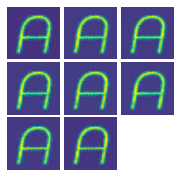

(8, 1, 64, 64)
[71/300][50/154]	Loss_D: 0.6926	Loss_G: 0.6938	D(x): 1.0000	D(G(z)): 0.4997 / 0.4997
label is ['A']


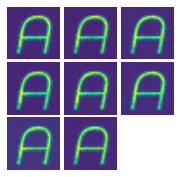

(8, 1, 64, 64)
[71/300][100/154]	Loss_D: 0.7026	Loss_G: 0.6873	D(x): 0.9965	D(G(z)): 0.5030 / 0.5029
label is ['A']


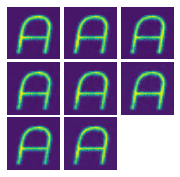

(8, 1, 64, 64)
[71/300][150/154]	Loss_D: 0.6984	Loss_G: 0.6912	D(x): 0.9969	D(G(z)): 0.5010 / 0.5010
label is ['A']


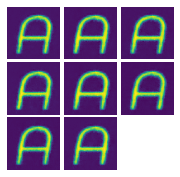

(8, 1, 64, 64)
[72/300][0/154]	Loss_D: 0.6948	Loss_G: 0.6916	D(x): 1.0000	D(G(z)): 0.5008 / 0.5008
label is ['A']


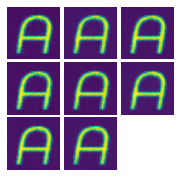

(8, 1, 64, 64)
[72/300][50/154]	Loss_D: 0.6897	Loss_G: 0.6968	D(x): 1.0000	D(G(z)): 0.4983 / 0.4982
label is ['A']


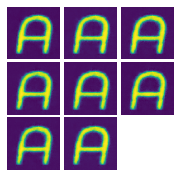

(8, 1, 64, 64)
[72/300][100/154]	Loss_D: 0.7079	Loss_G: 0.6795	D(x): 0.9994	D(G(z)): 0.5070 / 0.5069
label is ['A']


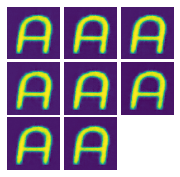

(8, 1, 64, 64)
[72/300][150/154]	Loss_D: 0.6994	Loss_G: 0.6882	D(x): 0.9988	D(G(z)): 0.5025 / 0.5025
label is ['A']


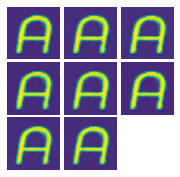

(8, 1, 64, 64)
[73/300][0/154]	Loss_D: 0.6979	Loss_G: 0.6886	D(x): 1.0000	D(G(z)): 0.5023 / 0.5023
label is ['A']


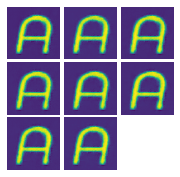

(8, 1, 64, 64)
[73/300][50/154]	Loss_D: 0.6946	Loss_G: 0.6918	D(x): 1.0000	D(G(z)): 0.5007 / 0.5007
label is ['A']


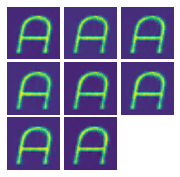

(8, 1, 64, 64)
[73/300][100/154]	Loss_D: 0.7029	Loss_G: 0.6852	D(x): 0.9983	D(G(z)): 0.5040 / 0.5040
label is ['A']


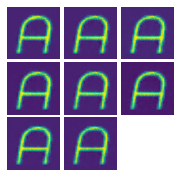

(8, 1, 64, 64)
[73/300][150/154]	Loss_D: 0.6991	Loss_G: 0.6900	D(x): 0.9974	D(G(z)): 0.5017 / 0.5016
label is ['A']


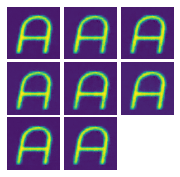

(8, 1, 64, 64)
[74/300][0/154]	Loss_D: 0.6961	Loss_G: 0.6903	D(x): 1.0000	D(G(z)): 0.5015 / 0.5014
label is ['A']


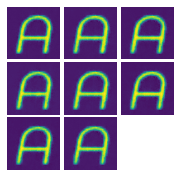

(8, 1, 64, 64)
[74/300][50/154]	Loss_D: 0.6905	Loss_G: 0.6959	D(x): 1.0000	D(G(z)): 0.4987 / 0.4986
label is ['A']


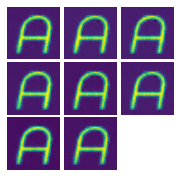

(8, 1, 64, 64)
[74/300][100/154]	Loss_D: 0.7035	Loss_G: 0.6839	D(x): 0.9990	D(G(z)): 0.5047 / 0.5046
label is ['A']


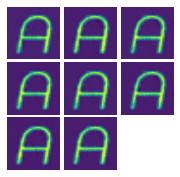

(8, 1, 64, 64)
[74/300][150/154]	Loss_D: 0.6998	Loss_G: 0.6883	D(x): 0.9983	D(G(z)): 0.5025 / 0.5024
label is ['A']


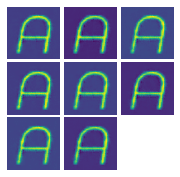

(8, 1, 64, 64)
[75/300][0/154]	Loss_D: 0.6977	Loss_G: 0.6887	D(x): 1.0000	D(G(z)): 0.5023 / 0.5022
label is ['A']


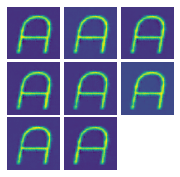

(8, 1, 64, 64)
[75/300][50/154]	Loss_D: 0.6937	Loss_G: 0.6927	D(x): 1.0000	D(G(z)): 0.5003 / 0.5002
label is ['A']


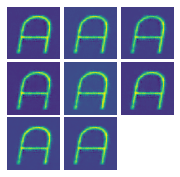

(8, 1, 64, 64)
[75/300][100/154]	Loss_D: 0.7015	Loss_G: 0.6889	D(x): 0.9960	D(G(z)): 0.5022 / 0.5021
label is ['A']


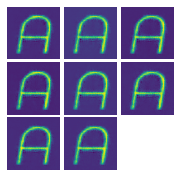

(8, 1, 64, 64)
[75/300][150/154]	Loss_D: 0.6988	Loss_G: 0.6918	D(x): 0.9958	D(G(z)): 0.5007 / 0.5007
label is ['A']


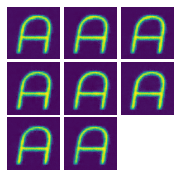

(8, 1, 64, 64)
[76/300][0/154]	Loss_D: 0.6945	Loss_G: 0.6919	D(x): 1.0000	D(G(z)): 0.5007 / 0.5006
label is ['A']


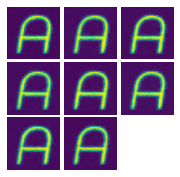

(8, 1, 64, 64)
[76/300][50/154]	Loss_D: 0.6907	Loss_G: 0.6958	D(x): 1.0000	D(G(z)): 0.4988 / 0.4987
label is ['A']


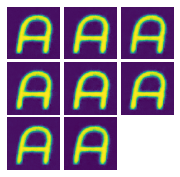

(8, 1, 64, 64)
[76/300][100/154]	Loss_D: 0.7056	Loss_G: 0.6825	D(x): 0.9986	D(G(z)): 0.5055 / 0.5054
label is ['A']


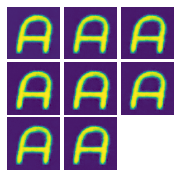

(8, 1, 64, 64)
[76/300][150/154]	Loss_D: 0.6979	Loss_G: 0.6905	D(x): 0.9981	D(G(z)): 0.5014 / 0.5013
label is ['A']


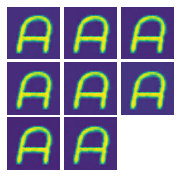

(8, 1, 64, 64)
[77/300][0/154]	Loss_D: 0.6955	Loss_G: 0.6910	D(x): 1.0000	D(G(z)): 0.5011 / 0.5011
label is ['A']


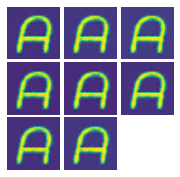

(8, 1, 64, 64)
[77/300][50/154]	Loss_D: 0.6942	Loss_G: 0.6922	D(x): 1.0000	D(G(z)): 0.5005 / 0.5005
label is ['A']


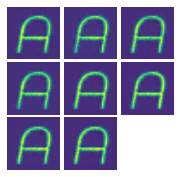

(8, 1, 64, 64)
[77/300][100/154]	Loss_D: 0.7052	Loss_G: 0.6843	D(x): 0.9970	D(G(z)): 0.5045 / 0.5044
label is ['A']


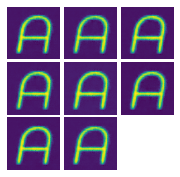

(8, 1, 64, 64)
[77/300][150/154]	Loss_D: 0.6991	Loss_G: 0.6895	D(x): 0.9978	D(G(z)): 0.5019 / 0.5018
label is ['A']


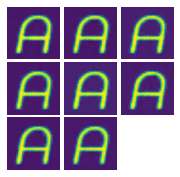

(8, 1, 64, 64)
[78/300][0/154]	Loss_D: 0.6964	Loss_G: 0.6900	D(x): 1.0000	D(G(z)): 0.5016 / 0.5016
label is ['A']


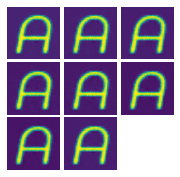

(8, 1, 64, 64)
[78/300][50/154]	Loss_D: 0.6905	Loss_G: 0.6959	D(x): 1.0000	D(G(z)): 0.4987 / 0.4986
label is ['A']


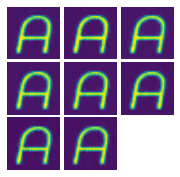

(8, 1, 64, 64)
[78/300][100/154]	Loss_D: 0.7042	Loss_G: 0.6837	D(x): 0.9986	D(G(z)): 0.5048 / 0.5048
label is ['A']


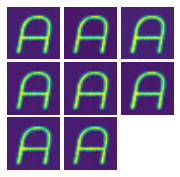

(8, 1, 64, 64)
[78/300][150/154]	Loss_D: 0.6991	Loss_G: 0.6886	D(x): 0.9987	D(G(z)): 0.5023 / 0.5023
label is ['A']


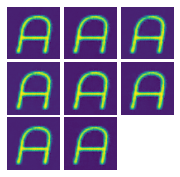

(8, 1, 64, 64)
[79/300][0/154]	Loss_D: 0.6974	Loss_G: 0.6890	D(x): 1.0000	D(G(z)): 0.5021 / 0.5021
label is ['A']


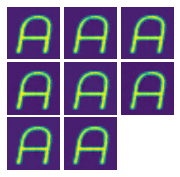

(8, 1, 64, 64)
[79/300][50/154]	Loss_D: 0.6925	Loss_G: 0.6939	D(x): 1.0000	D(G(z)): 0.4997 / 0.4996
label is ['A']


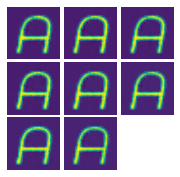

(8, 1, 64, 64)
[79/300][100/154]	Loss_D: 0.7022	Loss_G: 0.6868	D(x): 0.9975	D(G(z)): 0.5032 / 0.5032
label is ['A']


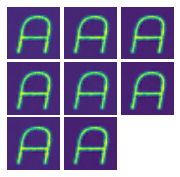

(8, 1, 64, 64)
[79/300][150/154]	Loss_D: 0.6973	Loss_G: 0.6911	D(x): 0.9980	D(G(z)): 0.5011 / 0.5010
label is ['A']


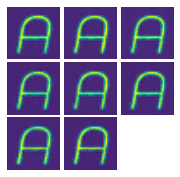

(8, 1, 64, 64)
[80/300][0/154]	Loss_D: 0.6950	Loss_G: 0.6914	D(x): 1.0000	D(G(z)): 0.5009 / 0.5009
label is ['A']


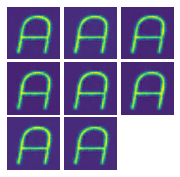

(8, 1, 64, 64)
[80/300][50/154]	Loss_D: 0.6913	Loss_G: 0.6951	D(x): 1.0000	D(G(z)): 0.4991 / 0.4990
label is ['A']


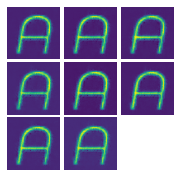

(8, 1, 64, 64)
[80/300][100/154]	Loss_D: 0.7020	Loss_G: 0.6881	D(x): 0.9963	D(G(z)): 0.5026 / 0.5025
label is ['A']


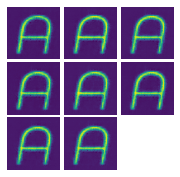

(8, 1, 64, 64)
[80/300][150/154]	Loss_D: 0.6995	Loss_G: 0.6896	D(x): 0.9973	D(G(z)): 0.5018 / 0.5018
label is ['A']


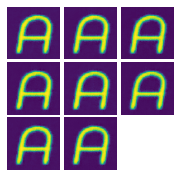

(8, 1, 64, 64)
[81/300][0/154]	Loss_D: 0.6965	Loss_G: 0.6900	D(x): 1.0000	D(G(z)): 0.5017 / 0.5016
label is ['A']


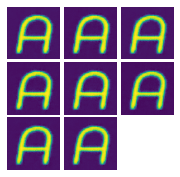

(8, 1, 64, 64)
[81/300][50/154]	Loss_D: 0.6894	Loss_G: 0.6971	D(x): 1.0000	D(G(z)): 0.4981 / 0.4980
label is ['A']


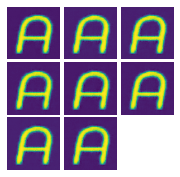

(8, 1, 64, 64)
[81/300][100/154]	Loss_D: 0.7069	Loss_G: 0.6805	D(x): 0.9993	D(G(z)): 0.5065 / 0.5064
label is ['A']


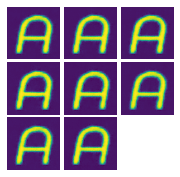

(8, 1, 64, 64)
[81/300][150/154]	Loss_D: 0.6988	Loss_G: 0.6890	D(x): 0.9987	D(G(z)): 0.5022 / 0.5021
label is ['A']


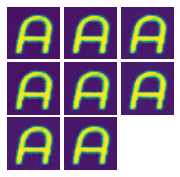

(8, 1, 64, 64)
[82/300][0/154]	Loss_D: 0.6969	Loss_G: 0.6897	D(x): 1.0000	D(G(z)): 0.5019 / 0.5017
label is ['A']


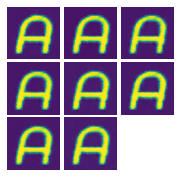

(8, 1, 64, 64)
[82/300][50/154]	Loss_D: 0.6914	Loss_G: 0.6951	D(x): 1.0000	D(G(z)): 0.4991 / 0.4990
label is ['A']


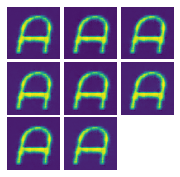

(8, 1, 64, 64)
[82/300][100/154]	Loss_D: 0.7045	Loss_G: 0.6830	D(x): 0.9990	D(G(z)): 0.5051 / 0.5051
label is ['A']


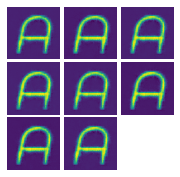

(8, 1, 64, 64)
[82/300][150/154]	Loss_D: 0.7005	Loss_G: 0.6867	D(x): 0.9992	D(G(z)): 0.5033 / 0.5032
label is ['A']


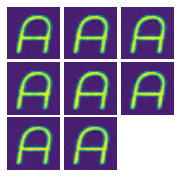

(8, 1, 64, 64)
[83/300][0/154]	Loss_D: 0.6993	Loss_G: 0.6871	D(x): 1.0000	D(G(z)): 0.5031 / 0.5030
label is ['A']


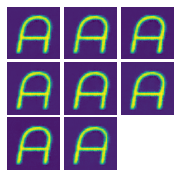

(8, 1, 64, 64)
[83/300][50/154]	Loss_D: 0.6943	Loss_G: 0.6921	D(x): 1.0000	D(G(z)): 0.5006 / 0.5005
label is ['A']


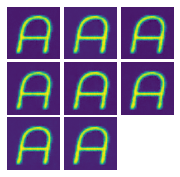

(8, 1, 64, 64)
[83/300][100/154]	Loss_D: 0.7018	Loss_G: 0.6870	D(x): 0.9977	D(G(z)): 0.5031 / 0.5031
label is ['A']


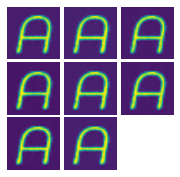

(8, 1, 64, 64)
[83/300][150/154]	Loss_D: 0.6962	Loss_G: 0.6918	D(x): 0.9984	D(G(z)): 0.5007 / 0.5007
label is ['A']


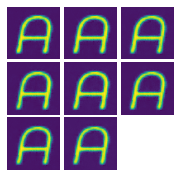

(8, 1, 64, 64)
[84/300][0/154]	Loss_D: 0.6943	Loss_G: 0.6922	D(x): 1.0000	D(G(z)): 0.5005 / 0.5005
label is ['A']


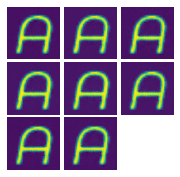

(8, 1, 64, 64)
[84/300][50/154]	Loss_D: 0.6899	Loss_G: 0.6965	D(x): 1.0000	D(G(z)): 0.4984 / 0.4983
label is ['A']


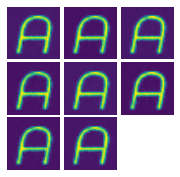

(8, 1, 64, 64)
[84/300][100/154]	Loss_D: 0.7029	Loss_G: 0.6849	D(x): 0.9987	D(G(z)): 0.5042 / 0.5041
label is ['A']


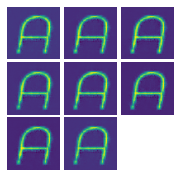

(8, 1, 64, 64)
[84/300][150/154]	Loss_D: 0.6987	Loss_G: 0.6891	D(x): 0.9987	D(G(z)): 0.5021 / 0.5020
label is ['A']


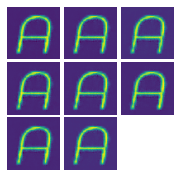

(8, 1, 64, 64)
[85/300][0/154]	Loss_D: 0.6970	Loss_G: 0.6895	D(x): 1.0000	D(G(z)): 0.5019 / 0.5018
label is ['A']


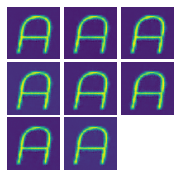

(8, 1, 64, 64)
[85/300][50/154]	Loss_D: 0.6929	Loss_G: 0.6935	D(x): 1.0000	D(G(z)): 0.4999 / 0.4998
label is ['A']


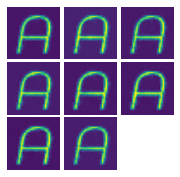

(8, 1, 64, 64)
[85/300][100/154]	Loss_D: 0.7018	Loss_G: 0.6888	D(x): 0.9959	D(G(z)): 0.5022 / 0.5022
label is ['A']


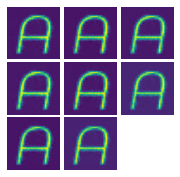

(8, 1, 64, 64)
[85/300][150/154]	Loss_D: 0.6979	Loss_G: 0.6910	D(x): 0.9975	D(G(z)): 0.5011 / 0.5011
label is ['A']


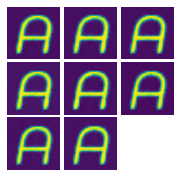

(8, 1, 64, 64)
[86/300][0/154]	Loss_D: 0.6953	Loss_G: 0.6912	D(x): 1.0000	D(G(z)): 0.5010 / 0.5010
label is ['A']


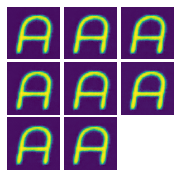

(8, 1, 64, 64)
[86/300][50/154]	Loss_D: 0.6917	Loss_G: 0.6949	D(x): 1.0000	D(G(z)): 0.4993 / 0.4991
label is ['A']


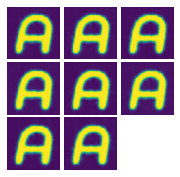

(8, 1, 64, 64)
[86/300][100/154]	Loss_D: 0.6994	Loss_G: 0.6886	D(x): 0.9986	D(G(z)): 0.5024 / 0.5023
label is ['A']


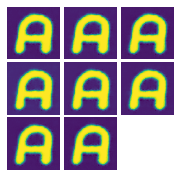

(8, 1, 64, 64)
[86/300][150/154]	Loss_D: 0.6997	Loss_G: 0.6891	D(x): 0.9976	D(G(z)): 0.5021 / 0.5020
label is ['A']


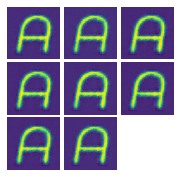

(8, 1, 64, 64)
[87/300][0/154]	Loss_D: 0.6978	Loss_G: 0.6887	D(x): 1.0000	D(G(z)): 0.5023 / 0.5022
label is ['A']


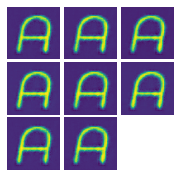

(8, 1, 64, 64)
[87/300][50/154]	Loss_D: 0.6945	Loss_G: 0.6919	D(x): 1.0000	D(G(z)): 0.5007 / 0.5006
label is ['A']


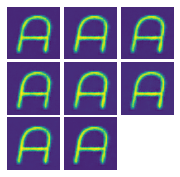

(8, 1, 64, 64)
[87/300][100/154]	Loss_D: 0.7039	Loss_G: 0.6851	D(x): 0.9974	D(G(z)): 0.5041 / 0.5040
label is ['A']


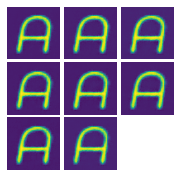

(8, 1, 64, 64)
[87/300][150/154]	Loss_D: 0.6980	Loss_G: 0.6907	D(x): 0.9977	D(G(z)): 0.5013 / 0.5012
label is ['A']


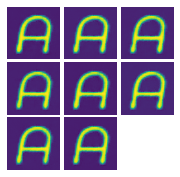

(8, 1, 64, 64)
[88/300][0/154]	Loss_D: 0.6953	Loss_G: 0.6912	D(x): 1.0000	D(G(z)): 0.5010 / 0.5010
label is ['A']


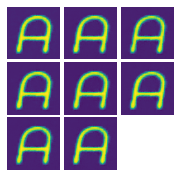

(8, 1, 64, 64)
[88/300][50/154]	Loss_D: 0.6899	Loss_G: 0.6966	D(x): 1.0000	D(G(z)): 0.4983 / 0.4983
label is ['A']


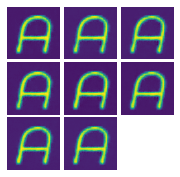

(8, 1, 64, 64)
[88/300][100/154]	Loss_D: 0.7029	Loss_G: 0.6848	D(x): 0.9987	D(G(z)): 0.5042 / 0.5042
label is ['A']


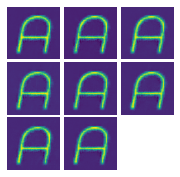

(8, 1, 64, 64)
[88/300][150/154]	Loss_D: 0.6991	Loss_G: 0.6892	D(x): 0.9982	D(G(z)): 0.5020 / 0.5020
label is ['A']


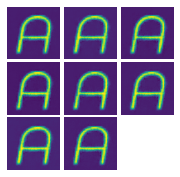

(8, 1, 64, 64)
[89/300][0/154]	Loss_D: 0.6968	Loss_G: 0.6896	D(x): 1.0000	D(G(z)): 0.5018 / 0.5018
label is ['A']


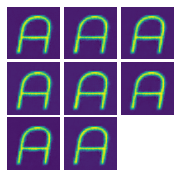

(8, 1, 64, 64)
[89/300][50/154]	Loss_D: 0.6940	Loss_G: 0.6924	D(x): 1.0000	D(G(z)): 0.5004 / 0.5004
label is ['A']


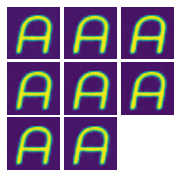

(8, 1, 64, 64)
[89/300][100/154]	Loss_D: 0.7024	Loss_G: 0.6861	D(x): 0.9980	D(G(z)): 0.5036 / 0.5035
label is ['A']


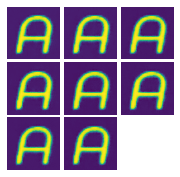

(8, 1, 64, 64)
[89/300][150/154]	Loss_D: 0.6964	Loss_G: 0.6921	D(x): 0.9979	D(G(z)): 0.5006 / 0.5005
label is ['A']


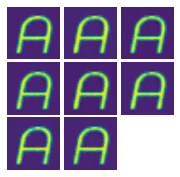

(8, 1, 64, 64)
[90/300][0/154]	Loss_D: 0.6943	Loss_G: 0.6922	D(x): 1.0000	D(G(z)): 0.5006 / 0.5005
label is ['A']


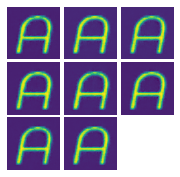

(8, 1, 64, 64)
[90/300][50/154]	Loss_D: 0.6925	Loss_G: 0.6940	D(x): 1.0000	D(G(z)): 0.4997 / 0.4996
label is ['A']


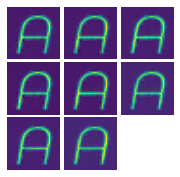

(8, 1, 64, 64)
[90/300][100/154]	Loss_D: 0.7028	Loss_G: 0.6848	D(x): 0.9989	D(G(z)): 0.5043 / 0.5042
label is ['A']


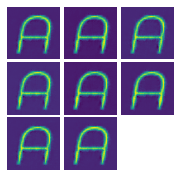

(8, 1, 64, 64)
[90/300][150/154]	Loss_D: 0.6993	Loss_G: 0.6887	D(x): 0.9984	D(G(z)): 0.5023 / 0.5022
label is ['A']


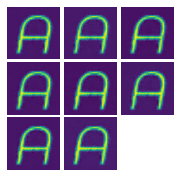

(8, 1, 64, 64)
[91/300][0/154]	Loss_D: 0.6974	Loss_G: 0.6890	D(x): 1.0000	D(G(z)): 0.5021 / 0.5021
label is ['A']


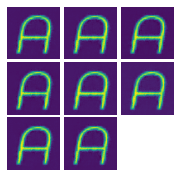

(8, 1, 64, 64)
[91/300][50/154]	Loss_D: 0.6940	Loss_G: 0.6924	D(x): 1.0000	D(G(z)): 0.5004 / 0.5003
label is ['A']


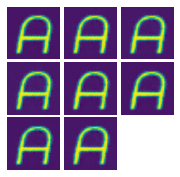

(8, 1, 64, 64)
[91/300][100/154]	Loss_D: 0.7020	Loss_G: 0.6868	D(x): 0.9976	D(G(z)): 0.5032 / 0.5032
label is ['A']


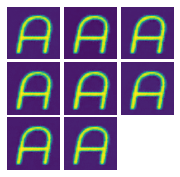

(8, 1, 64, 64)
[91/300][150/154]	Loss_D: 0.6969	Loss_G: 0.6916	D(x): 0.9979	D(G(z)): 0.5008 / 0.5008
label is ['A']


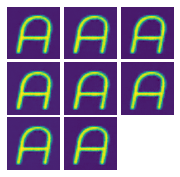

(8, 1, 64, 64)
[92/300][0/154]	Loss_D: 0.6944	Loss_G: 0.6920	D(x): 1.0000	D(G(z)): 0.5006 / 0.5006
label is ['A']


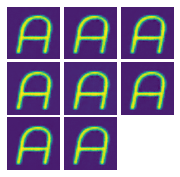

(8, 1, 64, 64)
[92/300][50/154]	Loss_D: 0.6910	Loss_G: 0.6954	D(x): 1.0000	D(G(z)): 0.4989 / 0.4989
label is ['A']


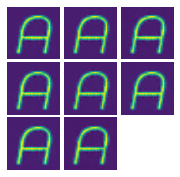

(8, 1, 64, 64)
[92/300][100/154]	Loss_D: 0.7011	Loss_G: 0.6873	D(x): 0.9981	D(G(z)): 0.5030 / 0.5029
label is ['A']


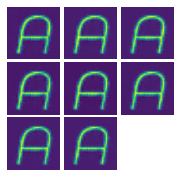

(8, 1, 64, 64)
[92/300][150/154]	Loss_D: 0.6983	Loss_G: 0.6899	D(x): 0.9982	D(G(z)): 0.5017 / 0.5016
label is ['A']


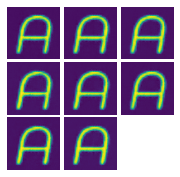

(8, 1, 64, 64)
[93/300][0/154]	Loss_D: 0.6963	Loss_G: 0.6902	D(x): 1.0000	D(G(z)): 0.5015 / 0.5015
label is ['A']


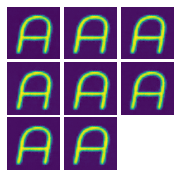

(8, 1, 64, 64)
[93/300][50/154]	Loss_D: 0.6922	Loss_G: 0.6942	D(x): 1.0000	D(G(z)): 0.4995 / 0.4995
label is ['A']


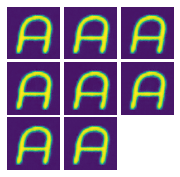

(8, 1, 64, 64)
[93/300][100/154]	Loss_D: 0.7020	Loss_G: 0.6857	D(x): 0.9988	D(G(z)): 0.5038 / 0.5037
label is ['A']


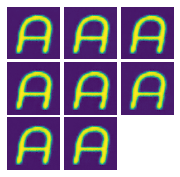

(8, 1, 64, 64)
[93/300][150/154]	Loss_D: 0.6969	Loss_G: 0.6914	D(x): 0.9981	D(G(z)): 0.5009 / 0.5009
label is ['A']


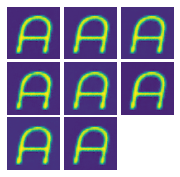

(8, 1, 64, 64)
[94/300][0/154]	Loss_D: 0.6948	Loss_G: 0.6917	D(x): 1.0000	D(G(z)): 0.5008 / 0.5007
label is ['A']


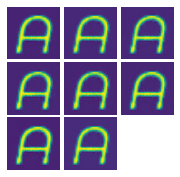

(8, 1, 64, 64)
[94/300][50/154]	Loss_D: 0.6929	Loss_G: 0.6935	D(x): 1.0000	D(G(z)): 0.4999 / 0.4998
label is ['A']


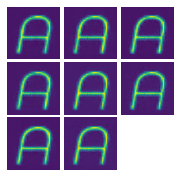

(8, 1, 64, 64)
[94/300][100/154]	Loss_D: 0.7018	Loss_G: 0.6857	D(x): 0.9989	D(G(z)): 0.5038 / 0.5037
label is ['A']


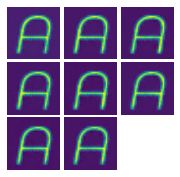

(8, 1, 64, 64)
[94/300][150/154]	Loss_D: 0.6985	Loss_G: 0.6897	D(x): 0.9982	D(G(z)): 0.5018 / 0.5017
label is ['A']


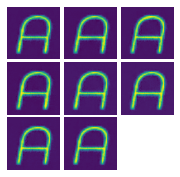

(8, 1, 64, 64)
[95/300][0/154]	Loss_D: 0.6963	Loss_G: 0.6901	D(x): 1.0000	D(G(z)): 0.5016 / 0.5015
label is ['A']


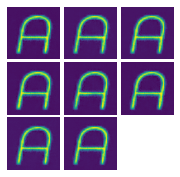

(8, 1, 64, 64)
[95/300][50/154]	Loss_D: 0.6928	Loss_G: 0.6936	D(x): 1.0000	D(G(z)): 0.4998 / 0.4998
label is ['A']


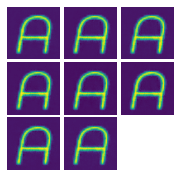

(8, 1, 64, 64)
[95/300][100/154]	Loss_D: 0.7012	Loss_G: 0.6871	D(x): 0.9981	D(G(z)): 0.5031 / 0.5030
label is ['A']


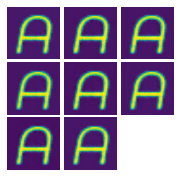

(8, 1, 64, 64)
[95/300][150/154]	Loss_D: 0.6969	Loss_G: 0.6917	D(x): 0.9978	D(G(z)): 0.5008 / 0.5007
label is ['A']


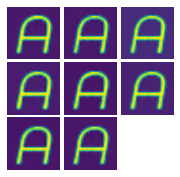

(8, 1, 64, 64)
[96/300][0/154]	Loss_D: 0.6944	Loss_G: 0.6920	D(x): 1.0000	D(G(z)): 0.5006 / 0.5006
label is ['A']


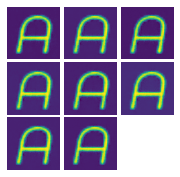

(8, 1, 64, 64)
[96/300][50/154]	Loss_D: 0.6910	Loss_G: 0.6954	D(x): 1.0000	D(G(z)): 0.4989 / 0.4989
label is ['A']


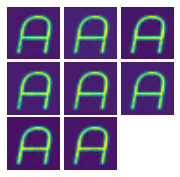

(8, 1, 64, 64)
[96/300][100/154]	Loss_D: 0.7003	Loss_G: 0.6876	D(x): 0.9985	D(G(z)): 0.5028 / 0.5028
label is ['A']


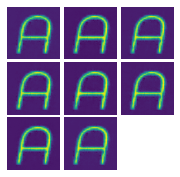

(8, 1, 64, 64)
[96/300][150/154]	Loss_D: 0.6978	Loss_G: 0.6904	D(x): 0.9982	D(G(z)): 0.5014 / 0.5014
label is ['A']


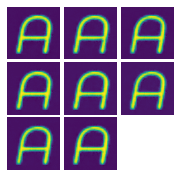

(8, 1, 64, 64)
[97/300][0/154]	Loss_D: 0.6957	Loss_G: 0.6907	D(x): 1.0000	D(G(z)): 0.5013 / 0.5012
label is ['A']


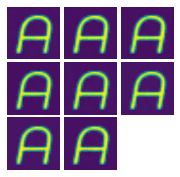

(8, 1, 64, 64)
[97/300][50/154]	Loss_D: 0.6918	Loss_G: 0.6946	D(x): 1.0000	D(G(z)): 0.4993 / 0.4993
label is ['A']


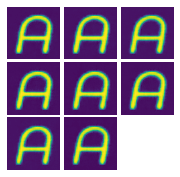

(8, 1, 64, 64)
[97/300][100/154]	Loss_D: 0.7033	Loss_G: 0.6844	D(x): 0.9990	D(G(z)): 0.5045 / 0.5044
label is ['A']


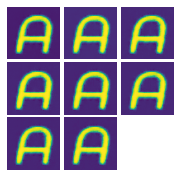

(8, 1, 64, 64)
[97/300][150/154]	Loss_D: 0.6941	Loss_G: 0.6938	D(x): 0.9985	D(G(z)): 0.4997 / 0.4997
label is ['A']


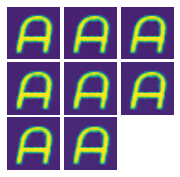

(8, 1, 64, 64)
[98/300][0/154]	Loss_D: 0.6922	Loss_G: 0.6943	D(x): 1.0000	D(G(z)): 0.4995 / 0.4994
label is ['A']


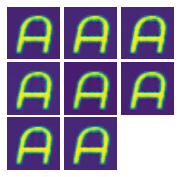

(8, 1, 64, 64)
[98/300][50/154]	Loss_D: 0.6931	Loss_G: 0.6933	D(x): 1.0000	D(G(z)): 0.5000 / 0.4999
label is ['A']


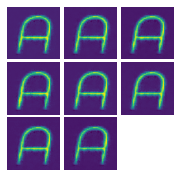

(8, 1, 64, 64)
[98/300][100/154]	Loss_D: 0.7026	Loss_G: 0.6851	D(x): 0.9988	D(G(z)): 0.5041 / 0.5041
label is ['A']


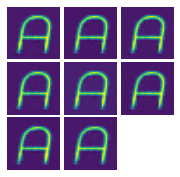

(8, 1, 64, 64)
[98/300][150/154]	Loss_D: 0.6993	Loss_G: 0.6882	D(x): 0.9989	D(G(z)): 0.5025 / 0.5025
label is ['A']


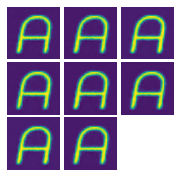

(8, 1, 64, 64)
[99/300][0/154]	Loss_D: 0.6982	Loss_G: 0.6883	D(x): 1.0000	D(G(z)): 0.5025 / 0.5024
label is ['A']


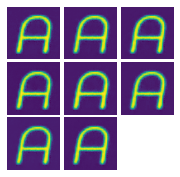

(8, 1, 64, 64)
[99/300][50/154]	Loss_D: 0.6941	Loss_G: 0.6923	D(x): 1.0000	D(G(z)): 0.5005 / 0.5004
label is ['A']


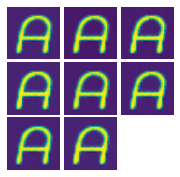

(8, 1, 64, 64)
[99/300][100/154]	Loss_D: 0.7017	Loss_G: 0.6866	D(x): 0.9982	D(G(z)): 0.5033 / 0.5033
label is ['A']


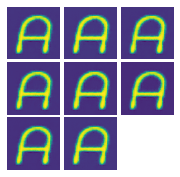

(8, 1, 64, 64)
[99/300][150/154]	Loss_D: 0.6966	Loss_G: 0.6913	D(x): 0.9985	D(G(z)): 0.5010 / 0.5009
label is ['A']


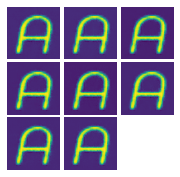

(8, 1, 64, 64)
[100/300][0/154]	Loss_D: 0.6949	Loss_G: 0.6916	D(x): 1.0000	D(G(z)): 0.5008 / 0.5008
label is ['A']


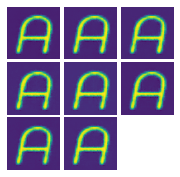

(8, 1, 64, 64)
[100/300][50/154]	Loss_D: 0.6924	Loss_G: 0.6940	D(x): 1.0000	D(G(z)): 0.4996 / 0.4996
label is ['A']


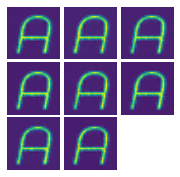

(8, 1, 64, 64)
[100/300][100/154]	Loss_D: 0.7014	Loss_G: 0.6868	D(x): 0.9982	D(G(z)): 0.5032 / 0.5032
label is ['A']


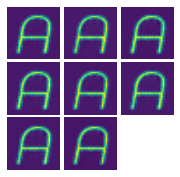

(8, 1, 64, 64)
[100/300][150/154]	Loss_D: 0.6977	Loss_G: 0.6903	D(x): 0.9984	D(G(z)): 0.5015 / 0.5014
label is ['A']


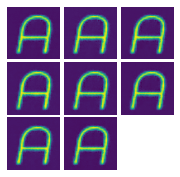

(8, 1, 64, 64)
[101/300][0/154]	Loss_D: 0.6959	Loss_G: 0.6905	D(x): 1.0000	D(G(z)): 0.5014 / 0.5013
label is ['A']


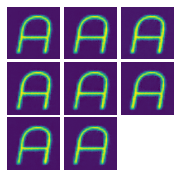

(8, 1, 64, 64)
[101/300][50/154]	Loss_D: 0.6926	Loss_G: 0.6938	D(x): 1.0000	D(G(z)): 0.4997 / 0.4997
label is ['A']


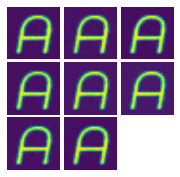

(8, 1, 64, 64)
[101/300][100/154]	Loss_D: 0.7009	Loss_G: 0.6877	D(x): 0.9979	D(G(z)): 0.5028 / 0.5028
label is ['A']


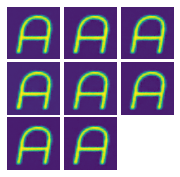

(8, 1, 64, 64)
[101/300][150/154]	Loss_D: 0.6962	Loss_G: 0.6919	D(x): 0.9983	D(G(z)): 0.5007 / 0.5006
label is ['A']


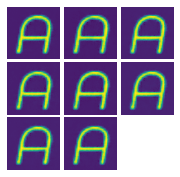

(8, 1, 64, 64)
[102/300][0/154]	Loss_D: 0.6942	Loss_G: 0.6922	D(x): 1.0000	D(G(z)): 0.5005 / 0.5005
label is ['A']


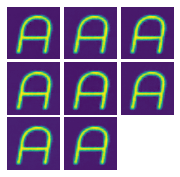

(8, 1, 64, 64)
[102/300][50/154]	Loss_D: 0.6916	Loss_G: 0.6948	D(x): 1.0000	D(G(z)): 0.4992 / 0.4992
label is ['A']


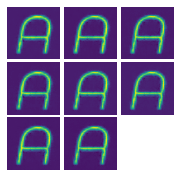

(8, 1, 64, 64)
[102/300][100/154]	Loss_D: 0.7003	Loss_G: 0.6880	D(x): 0.9981	D(G(z)): 0.5026 / 0.5026
label is ['A']


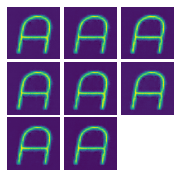

(8, 1, 64, 64)
[102/300][150/154]	Loss_D: 0.6968	Loss_G: 0.6914	D(x): 0.9982	D(G(z)): 0.5009 / 0.5009
label is ['A']


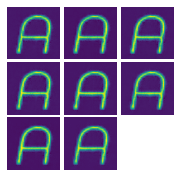

(8, 1, 64, 64)
[103/300][0/154]	Loss_D: 0.6947	Loss_G: 0.6916	D(x): 1.0000	D(G(z)): 0.5008 / 0.5007
label is ['A']


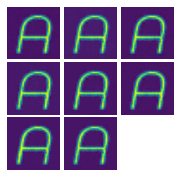

(8, 1, 64, 64)
[103/300][50/154]	Loss_D: 0.6930	Loss_G: 0.6934	D(x): 1.0000	D(G(z)): 0.4999 / 0.4999
label is ['A']


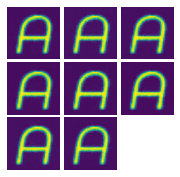

(8, 1, 64, 64)
[103/300][100/154]	Loss_D: 0.7016	Loss_G: 0.6880	D(x): 0.9969	D(G(z)): 0.5027 / 0.5026
label is ['A']


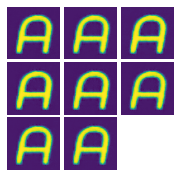

(8, 1, 64, 64)
[103/300][150/154]	Loss_D: 0.6962	Loss_G: 0.6928	D(x): 0.9974	D(G(z)): 0.5002 / 0.5002
label is ['A']


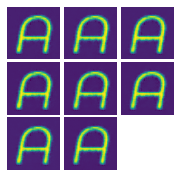

(8, 1, 64, 64)
[104/300][0/154]	Loss_D: 0.6935	Loss_G: 0.6929	D(x): 1.0000	D(G(z)): 0.5002 / 0.5001
label is ['A']


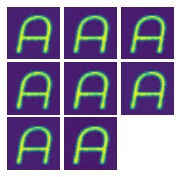

(8, 1, 64, 64)
[104/300][50/154]	Loss_D: 0.6911	Loss_G: 0.6953	D(x): 1.0000	D(G(z)): 0.4990 / 0.4989
label is ['A']


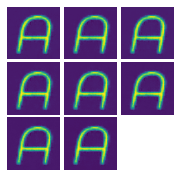

(8, 1, 64, 64)
[104/300][100/154]	Loss_D: 0.7017	Loss_G: 0.6857	D(x): 0.9991	D(G(z)): 0.5038 / 0.5037
label is ['A']


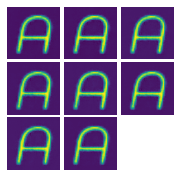

(8, 1, 64, 64)
[104/300][150/154]	Loss_D: 0.6991	Loss_G: 0.6883	D(x): 0.9991	D(G(z)): 0.5025 / 0.5024
label is ['A']


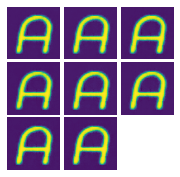

(8, 1, 64, 64)
[105/300][0/154]	Loss_D: 0.6978	Loss_G: 0.6886	D(x): 1.0000	D(G(z)): 0.5023 / 0.5023
label is ['A']


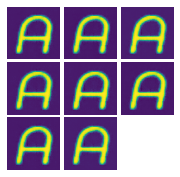

(8, 1, 64, 64)
[105/300][50/154]	Loss_D: 0.6917	Loss_G: 0.6948	D(x): 1.0000	D(G(z)): 0.4993 / 0.4992
label is ['A']


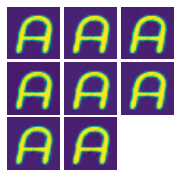

(8, 1, 64, 64)
[105/300][100/154]	Loss_D: 0.7021	Loss_G: 0.6850	D(x): 0.9993	D(G(z)): 0.5041 / 0.5041
label is ['A']


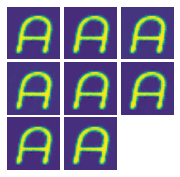

(8, 1, 64, 64)
[105/300][150/154]	Loss_D: 0.6973	Loss_G: 0.6901	D(x): 0.9991	D(G(z)): 0.5016 / 0.5015
label is ['A']


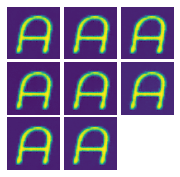

(8, 1, 64, 64)
[106/300][0/154]	Loss_D: 0.6961	Loss_G: 0.6903	D(x): 1.0000	D(G(z)): 0.5015 / 0.5014
label is ['A']


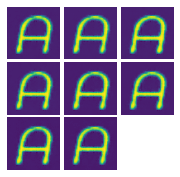

(8, 1, 64, 64)
[106/300][50/154]	Loss_D: 0.6928	Loss_G: 0.6936	D(x): 1.0000	D(G(z)): 0.4998 / 0.4998
label is ['A']


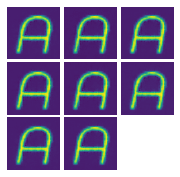

(8, 1, 64, 64)
[106/300][100/154]	Loss_D: 0.7013	Loss_G: 0.6860	D(x): 0.9991	D(G(z)): 0.5036 / 0.5036
label is ['A']


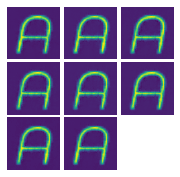

(8, 1, 64, 64)
[106/300][150/154]	Loss_D: 0.6980	Loss_G: 0.6896	D(x): 0.9988	D(G(z)): 0.5018 / 0.5018
label is ['A']


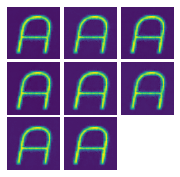

(8, 1, 64, 64)
[107/300][0/154]	Loss_D: 0.6965	Loss_G: 0.6899	D(x): 1.0000	D(G(z)): 0.5017 / 0.5016
label is ['A']


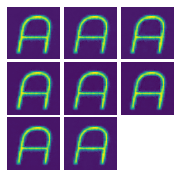

(8, 1, 64, 64)
[107/300][50/154]	Loss_D: 0.6936	Loss_G: 0.6928	D(x): 1.0000	D(G(z)): 0.5002 / 0.5002
label is ['A']


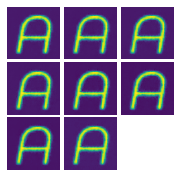

(8, 1, 64, 64)
[107/300][100/154]	Loss_D: 0.6995	Loss_G: 0.6885	D(x): 0.9984	D(G(z)): 0.5024 / 0.5023
label is ['A']


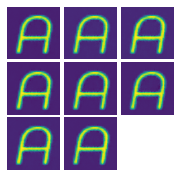

(8, 1, 64, 64)
[107/300][150/154]	Loss_D: 0.6958	Loss_G: 0.6921	D(x): 0.9985	D(G(z)): 0.5005 / 0.5005
label is ['A']


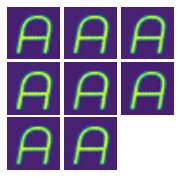

(8, 1, 64, 64)
[108/300][0/154]	Loss_D: 0.6940	Loss_G: 0.6924	D(x): 1.0000	D(G(z)): 0.5004 / 0.5004
label is ['A']


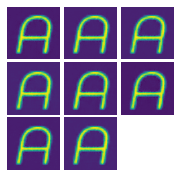

(8, 1, 64, 64)
[108/300][50/154]	Loss_D: 0.6916	Loss_G: 0.6948	D(x): 1.0000	D(G(z)): 0.4992 / 0.4992
label is ['A']


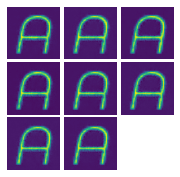

(8, 1, 64, 64)
[108/300][100/154]	Loss_D: 0.6991	Loss_G: 0.6889	D(x): 0.9983	D(G(z)): 0.5021 / 0.5021
label is ['A']


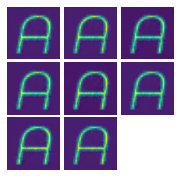

(8, 1, 64, 64)
[108/300][150/154]	Loss_D: 0.6961	Loss_G: 0.6918	D(x): 0.9985	D(G(z)): 0.5007 / 0.5007
label is ['A']


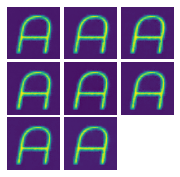

(8, 1, 64, 64)
[109/300][0/154]	Loss_D: 0.6945	Loss_G: 0.6919	D(x): 1.0000	D(G(z)): 0.5007 / 0.5006
label is ['A']


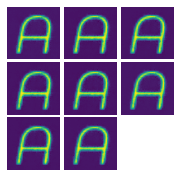

(8, 1, 64, 64)
[109/300][50/154]	Loss_D: 0.6927	Loss_G: 0.6937	D(x): 1.0000	D(G(z)): 0.4998 / 0.4997
label is ['A']


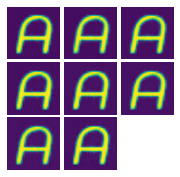

(8, 1, 64, 64)
[109/300][100/154]	Loss_D: 0.7004	Loss_G: 0.6878	D(x): 0.9983	D(G(z)): 0.5028 / 0.5027
label is ['A']


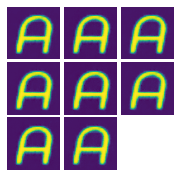

(8, 1, 64, 64)
[109/300][150/154]	Loss_D: 0.6936	Loss_G: 0.6944	D(x): 0.9985	D(G(z)): 0.4995 / 0.4994
label is ['A']


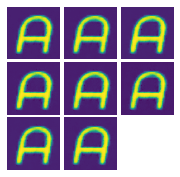

(8, 1, 64, 64)
[110/300][0/154]	Loss_D: 0.6917	Loss_G: 0.6948	D(x): 1.0000	D(G(z)): 0.4993 / 0.4992
label is ['A']


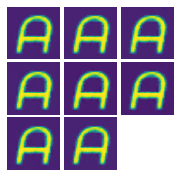

(8, 1, 64, 64)
[110/300][50/154]	Loss_D: 0.6920	Loss_G: 0.6944	D(x): 1.0000	D(G(z)): 0.4994 / 0.4994
label is ['A']


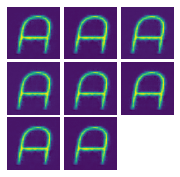

(8, 1, 64, 64)
[110/300][100/154]	Loss_D: 0.7012	Loss_G: 0.6869	D(x): 0.9984	D(G(z)): 0.5032 / 0.5031
label is ['A']


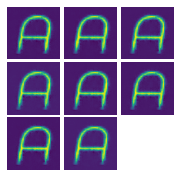

(8, 1, 64, 64)
[110/300][150/154]	Loss_D: 0.6989	Loss_G: 0.6885	D(x): 0.9990	D(G(z)): 0.5024 / 0.5023
label is ['A']


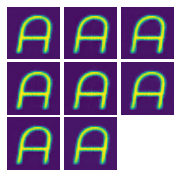

(8, 1, 64, 64)
[111/300][0/154]	Loss_D: 0.6977	Loss_G: 0.6887	D(x): 1.0000	D(G(z)): 0.5023 / 0.5022
label is ['A']


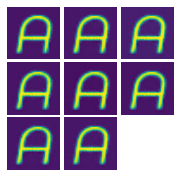

(8, 1, 64, 64)
[111/300][50/154]	Loss_D: 0.6934	Loss_G: 0.6930	D(x): 1.0000	D(G(z)): 0.5001 / 0.5001
label is ['A']


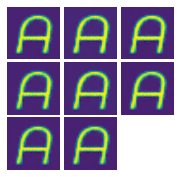

(8, 1, 64, 64)
[111/300][100/154]	Loss_D: 0.7010	Loss_G: 0.6869	D(x): 0.9985	D(G(z)): 0.5032 / 0.5032
label is ['A']


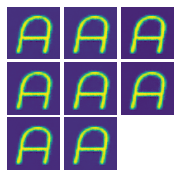

(8, 1, 64, 64)
[111/300][150/154]	Loss_D: 0.6964	Loss_G: 0.6909	D(x): 0.9991	D(G(z)): 0.5012 / 0.5011
label is ['A']


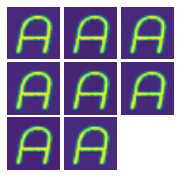

(8, 1, 64, 64)
[112/300][0/154]	Loss_D: 0.6952	Loss_G: 0.6912	D(x): 1.0000	D(G(z)): 0.5010 / 0.5010
label is ['A']


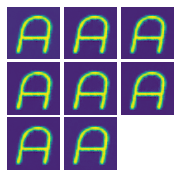

(8, 1, 64, 64)
[112/300][50/154]	Loss_D: 0.6932	Loss_G: 0.6932	D(x): 1.0000	D(G(z)): 0.5000 / 0.5000
label is ['A']


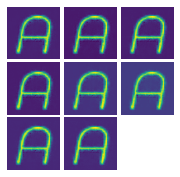

(8, 1, 64, 64)
[112/300][100/154]	Loss_D: 0.6998	Loss_G: 0.6884	D(x): 0.9982	D(G(z)): 0.5024 / 0.5024
label is ['A']


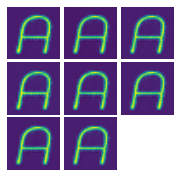

(8, 1, 64, 64)
[112/300][150/154]	Loss_D: 0.6962	Loss_G: 0.6916	D(x): 0.9986	D(G(z)): 0.5008 / 0.5008
label is ['A']


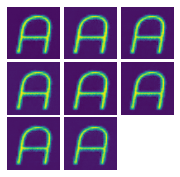

(8, 1, 64, 64)
[113/300][0/154]	Loss_D: 0.6947	Loss_G: 0.6917	D(x): 1.0000	D(G(z)): 0.5007 / 0.5007
label is ['A']


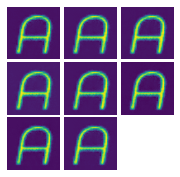

(8, 1, 64, 64)
[113/300][50/154]	Loss_D: 0.6919	Loss_G: 0.6945	D(x): 1.0000	D(G(z)): 0.4994 / 0.4993
label is ['A']


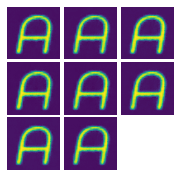

(8, 1, 64, 64)
[113/300][100/154]	Loss_D: 0.6999	Loss_G: 0.6885	D(x): 0.9981	D(G(z)): 0.5024 / 0.5023
label is ['A']


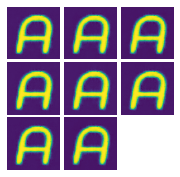

(8, 1, 64, 64)
[113/300][150/154]	Loss_D: 0.6935	Loss_G: 0.6948	D(x): 0.9982	D(G(z)): 0.4993 / 0.4992
label is ['A']


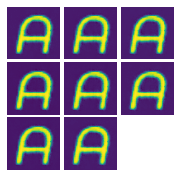

(8, 1, 64, 64)
[114/300][0/154]	Loss_D: 0.6916	Loss_G: 0.6949	D(x): 1.0000	D(G(z)): 0.4992 / 0.4991
label is ['A']


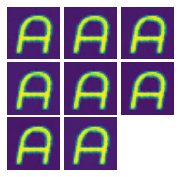

(8, 1, 64, 64)
[114/300][50/154]	Loss_D: 0.6931	Loss_G: 0.6933	D(x): 1.0000	D(G(z)): 0.5000 / 0.4999
label is ['A']


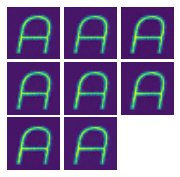

(8, 1, 64, 64)
[114/300][100/154]	Loss_D: 0.7008	Loss_G: 0.6867	D(x): 0.9989	D(G(z)): 0.5033 / 0.5032
label is ['A']


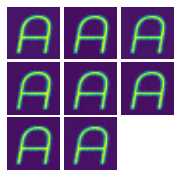

(8, 1, 64, 64)
[114/300][150/154]	Loss_D: 0.6980	Loss_G: 0.6894	D(x): 0.9991	D(G(z)): 0.5019 / 0.5019
label is ['A']


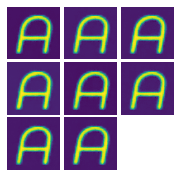

(8, 1, 64, 64)
[115/300][0/154]	Loss_D: 0.6967	Loss_G: 0.6897	D(x): 1.0000	D(G(z)): 0.5018 / 0.5017
label is ['A']


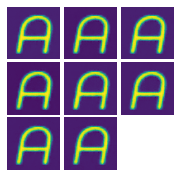

(8, 1, 64, 64)
[115/300][50/154]	Loss_D: 0.6922	Loss_G: 0.6942	D(x): 1.0000	D(G(z)): 0.4995 / 0.4995
label is ['A']


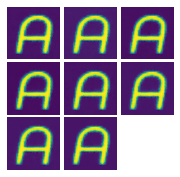

(8, 1, 64, 64)
[115/300][100/154]	Loss_D: 0.6999	Loss_G: 0.6873	D(x): 0.9993	D(G(z)): 0.5030 / 0.5029
label is ['A']


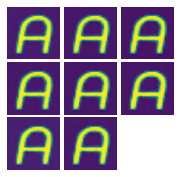

(8, 1, 64, 64)
[115/300][150/154]	Loss_D: 0.6978	Loss_G: 0.6894	D(x): 0.9992	D(G(z)): 0.5019 / 0.5019
label is ['A']


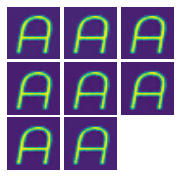

(8, 1, 64, 64)
[116/300][0/154]	Loss_D: 0.6969	Loss_G: 0.6896	D(x): 1.0000	D(G(z)): 0.5018 / 0.5018
label is ['A']


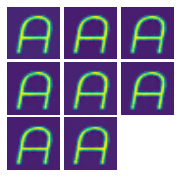

(8, 1, 64, 64)
[116/300][50/154]	Loss_D: 0.6944	Loss_G: 0.6920	D(x): 1.0000	D(G(z)): 0.5006 / 0.5006
label is ['A']


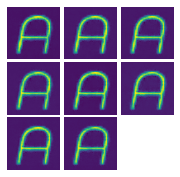

(8, 1, 64, 64)
[116/300][100/154]	Loss_D: 0.6995	Loss_G: 0.6882	D(x): 0.9987	D(G(z)): 0.5025 / 0.5025
label is ['A']


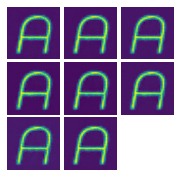

(8, 1, 64, 64)
[116/300][150/154]	Loss_D: 0.6967	Loss_G: 0.6911	D(x): 0.9986	D(G(z)): 0.5011 / 0.5010
label is ['A']


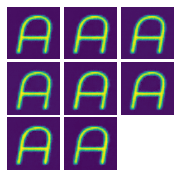

(8, 1, 64, 64)
[117/300][0/154]	Loss_D: 0.6951	Loss_G: 0.6913	D(x): 1.0000	D(G(z)): 0.5010 / 0.5009
label is ['A']


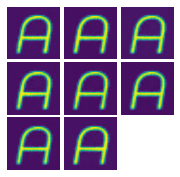

(8, 1, 64, 64)
[117/300][50/154]	Loss_D: 0.6918	Loss_G: 0.6946	D(x): 1.0000	D(G(z)): 0.4993 / 0.4993
label is ['A']


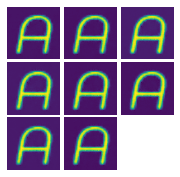

(8, 1, 64, 64)
[117/300][100/154]	Loss_D: 0.6992	Loss_G: 0.6882	D(x): 0.9990	D(G(z)): 0.5025 / 0.5025
label is ['A']


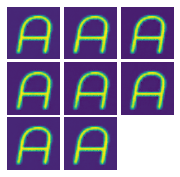

(8, 1, 64, 64)
[117/300][150/154]	Loss_D: 0.6959	Loss_G: 0.6916	D(x): 0.9989	D(G(z)): 0.5008 / 0.5008
label is ['A']


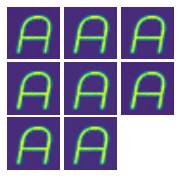

(8, 1, 64, 64)
[118/300][0/154]	Loss_D: 0.6946	Loss_G: 0.6918	D(x): 1.0000	D(G(z)): 0.5007 / 0.5007
label is ['A']


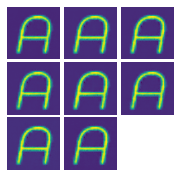

(8, 1, 64, 64)
[118/300][50/154]	Loss_D: 0.6924	Loss_G: 0.6939	D(x): 1.0000	D(G(z)): 0.4996 / 0.4996
label is ['A']


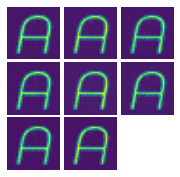

(8, 1, 64, 64)
[118/300][100/154]	Loss_D: 0.6985	Loss_G: 0.6895	D(x): 0.9983	D(G(z)): 0.5018 / 0.5018
label is ['A']


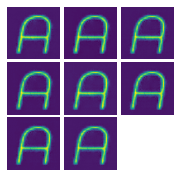

(8, 1, 64, 64)
[118/300][150/154]	Loss_D: 0.6954	Loss_G: 0.6925	D(x): 0.9984	D(G(z)): 0.5003 / 0.5003
label is ['A']


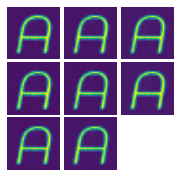

(8, 1, 64, 64)
[119/300][0/154]	Loss_D: 0.6937	Loss_G: 0.6927	D(x): 1.0000	D(G(z)): 0.5003 / 0.5002
label is ['A']


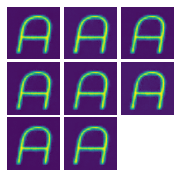

(8, 1, 64, 64)
[119/300][50/154]	Loss_D: 0.6928	Loss_G: 0.6936	D(x): 1.0000	D(G(z)): 0.4998 / 0.4998
label is ['A']


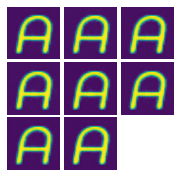

(8, 1, 64, 64)
[119/300][100/154]	Loss_D: 0.7009	Loss_G: 0.6872	D(x): 0.9984	D(G(z)): 0.5031 / 0.5030
label is ['A']


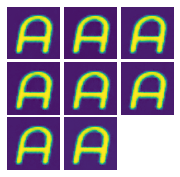

(8, 1, 64, 64)
[119/300][150/154]	Loss_D: 0.6947	Loss_G: 0.6932	D(x): 0.9986	D(G(z)): 0.5001 / 0.5000
label is ['A']


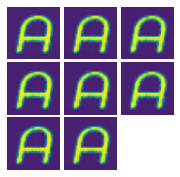

(8, 1, 64, 64)
[120/300][0/154]	Loss_D: 0.6931	Loss_G: 0.6933	D(x): 1.0000	D(G(z)): 0.5000 / 0.4999
label is ['A']


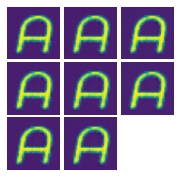

(8, 1, 64, 64)
[120/300][50/154]	Loss_D: 0.6920	Loss_G: 0.6944	D(x): 1.0000	D(G(z)): 0.4994 / 0.4994
label is ['A']


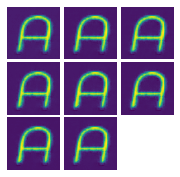

(8, 1, 64, 64)
[120/300][100/154]	Loss_D: 0.7000	Loss_G: 0.6875	D(x): 0.9990	D(G(z)): 0.5029 / 0.5028
label is ['A']


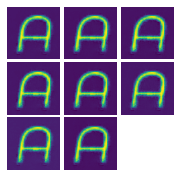

(8, 1, 64, 64)
[120/300][150/154]	Loss_D: 0.6974	Loss_G: 0.6899	D(x): 0.9991	D(G(z)): 0.5017 / 0.5016
label is ['A']


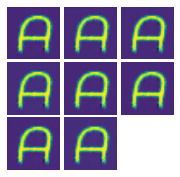

(8, 1, 64, 64)
[121/300][0/154]	Loss_D: 0.6963	Loss_G: 0.6901	D(x): 1.0000	D(G(z)): 0.5016 / 0.5015
label is ['A']


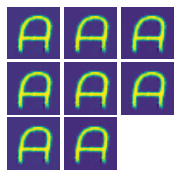

(8, 1, 64, 64)
[121/300][50/154]	Loss_D: 0.6934	Loss_G: 0.6931	D(x): 1.0000	D(G(z)): 0.5001 / 0.5000
label is ['A']


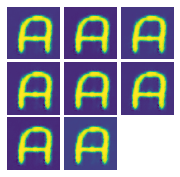

(8, 1, 64, 64)
[121/300][100/154]	Loss_D: 0.6987	Loss_G: 0.6893	D(x): 0.9985	D(G(z)): 0.5020 / 0.5019
label is ['A']


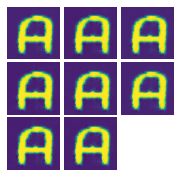

(8, 1, 64, 64)
[121/300][150/154]	Loss_D: 0.6903	Loss_G: 0.6980	D(x): 0.9982	D(G(z)): 0.4977 / 0.4976
label is ['A']


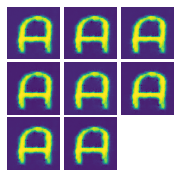

(8, 1, 64, 64)
[122/300][0/154]	Loss_D: 0.6886	Loss_G: 0.6979	D(x): 1.0000	D(G(z)): 0.4977 / 0.4976
label is ['A']


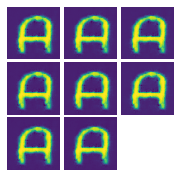

(8, 1, 64, 64)
[122/300][50/154]	Loss_D: 0.6929	Loss_G: 0.6937	D(x): 1.0000	D(G(z)): 0.4999 / 0.4997
label is ['A']


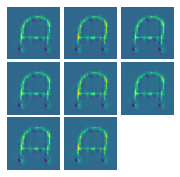

(8, 1, 64, 64)
[122/300][100/154]	Loss_D: 0.7008	Loss_G: 0.6898	D(x): 0.9959	D(G(z)): 0.5018 / 0.5017
label is ['A']


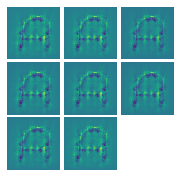

(8, 1, 64, 64)
[122/300][150/154]	Loss_D: 0.6977	Loss_G: 0.6902	D(x): 0.9985	D(G(z)): 0.5016 / 0.5015
label is ['A']


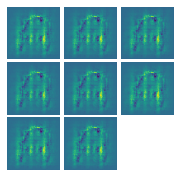

(8, 1, 64, 64)
[123/300][0/154]	Loss_D: 0.6964	Loss_G: 0.6901	D(x): 1.0000	D(G(z)): 0.5016 / 0.5015
label is ['A']


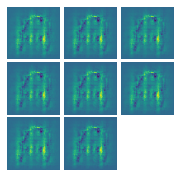

(8, 1, 64, 64)
[123/300][50/154]	Loss_D: 0.6955	Loss_G: 0.6910	D(x): 1.0000	D(G(z)): 0.5012 / 0.5011
label is ['A']


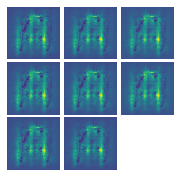

(8, 1, 64, 64)
[123/300][100/154]	Loss_D: 0.7187	Loss_G: 0.6910	D(x): 0.9778	D(G(z)): 0.5009 / 0.5011
label is ['A']


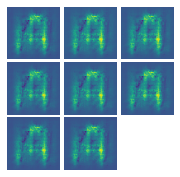

(8, 1, 64, 64)
[123/300][150/154]	Loss_D: 0.7001	Loss_G: 0.6916	D(x): 0.9947	D(G(z)): 0.5008 / 0.5008
label is ['A']


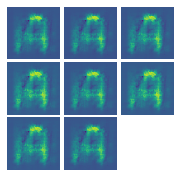

(8, 1, 64, 64)
[124/300][0/154]	Loss_D: 0.6953	Loss_G: 0.6915	D(x): 0.9996	D(G(z)): 0.5009 / 0.5008
label is ['A']


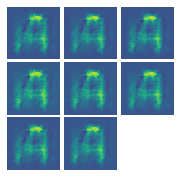

(8, 1, 64, 64)
[124/300][50/154]	Loss_D: 0.6947	Loss_G: 0.6920	D(x): 0.9998	D(G(z)): 0.5007 / 0.5006
label is ['A']


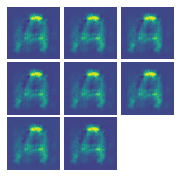

(8, 1, 64, 64)
[124/300][100/154]	Loss_D: 0.7023	Loss_G: 0.6867	D(x): 0.9968	D(G(z)): 0.5029 / 0.5032
label is ['A']


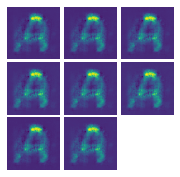

(8, 1, 64, 64)
[124/300][150/154]	Loss_D: 0.7003	Loss_G: 0.6899	D(x): 0.9962	D(G(z)): 0.5016 / 0.5016
label is ['A']


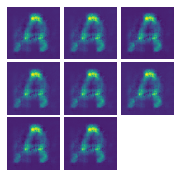

(8, 1, 64, 64)
[125/300][0/154]	Loss_D: 0.6966	Loss_G: 0.6902	D(x): 0.9996	D(G(z)): 0.5016 / 0.5015
label is ['A']


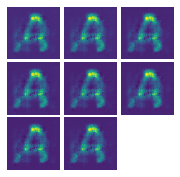

(8, 1, 64, 64)
[125/300][50/154]	Loss_D: 0.6950	Loss_G: 0.6919	D(x): 0.9996	D(G(z)): 0.5007 / 0.5006
label is ['A']


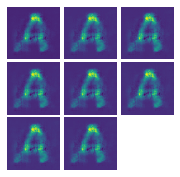

(8, 1, 64, 64)
[125/300][100/154]	Loss_D: 0.7026	Loss_G: 0.6900	D(x): 0.9935	D(G(z)): 0.5014 / 0.5016
label is ['A']


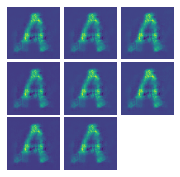

(8, 1, 64, 64)
[125/300][150/154]	Loss_D: 0.7017	Loss_G: 0.6903	D(x): 0.9943	D(G(z)): 0.5014 / 0.5014
label is ['A']


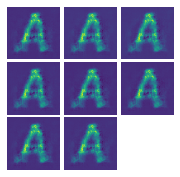

(8, 1, 64, 64)
[126/300][0/154]	Loss_D: 0.6967	Loss_G: 0.6902	D(x): 0.9996	D(G(z)): 0.5016 / 0.5015
label is ['A']


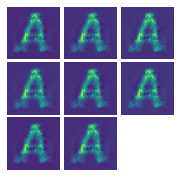

(8, 1, 64, 64)
[126/300][50/154]	Loss_D: 0.6960	Loss_G: 0.6909	D(x): 0.9996	D(G(z)): 0.5012 / 0.5011
label is ['A']


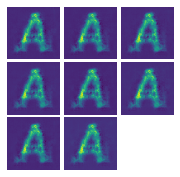

(8, 1, 64, 64)
[126/300][100/154]	Loss_D: 0.7008	Loss_G: 0.6882	D(x): 0.9969	D(G(z)): 0.5023 / 0.5025
label is ['A']


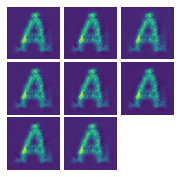

(8, 1, 64, 64)
[126/300][150/154]	Loss_D: 0.6976	Loss_G: 0.6908	D(x): 0.9979	D(G(z)): 0.5012 / 0.5012
label is ['A']


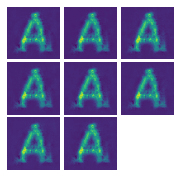

(8, 1, 64, 64)
[127/300][0/154]	Loss_D: 0.6959	Loss_G: 0.6910	D(x): 0.9995	D(G(z)): 0.5011 / 0.5011
label is ['A']


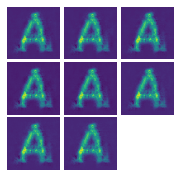

(8, 1, 64, 64)
[127/300][50/154]	Loss_D: 0.6956	Loss_G: 0.6917	D(x): 0.9991	D(G(z)): 0.5008 / 0.5007
label is ['A']


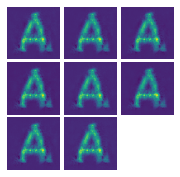

(8, 1, 64, 64)
[127/300][100/154]	Loss_D: 0.6983	Loss_G: 0.6920	D(x): 0.9961	D(G(z)): 0.5006 / 0.5006
label is ['A']


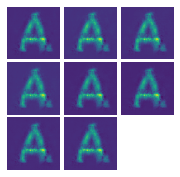

(8, 1, 64, 64)
[127/300][150/154]	Loss_D: 0.6953	Loss_G: 0.6916	D(x): 0.9995	D(G(z)): 0.5008 / 0.5008
label is ['A']


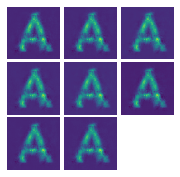

(8, 1, 64, 64)
[128/300][0/154]	Loss_D: 0.6951	Loss_G: 0.6918	D(x): 0.9996	D(G(z)): 0.5008 / 0.5007
label is ['A']


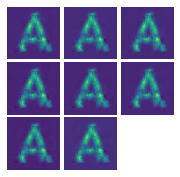

(8, 1, 64, 64)
[128/300][50/154]	Loss_D: 0.6953	Loss_G: 0.6920	D(x): 0.9991	D(G(z)): 0.5006 / 0.5006
label is ['A']


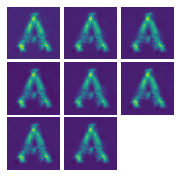

(8, 1, 64, 64)
[128/300][100/154]	Loss_D: 0.6944	Loss_G: 0.6934	D(x): 0.9987	D(G(z)): 0.5000 / 0.4999
label is ['A']


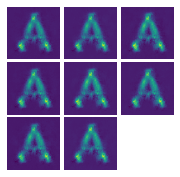

(8, 1, 64, 64)
[128/300][150/154]	Loss_D: 0.6935	Loss_G: 0.6941	D(x): 0.9990	D(G(z)): 0.4997 / 0.4995
label is ['A']


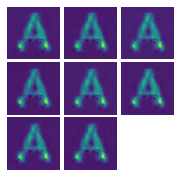

(8, 1, 64, 64)
[129/300][0/154]	Loss_D: 0.6951	Loss_G: 0.6914	D(x): 0.9995	D(G(z)): 0.5007 / 0.5009
label is ['A']


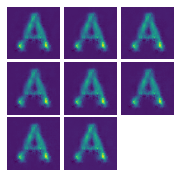

(8, 1, 64, 64)
[129/300][50/154]	Loss_D: 0.6944	Loss_G: 0.6931	D(x): 0.9991	D(G(z)): 0.5002 / 0.5000
label is ['A']


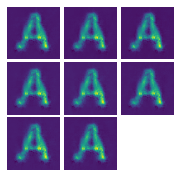

(8, 1, 64, 64)
[129/300][100/154]	Loss_D: 0.6943	Loss_G: 0.6931	D(x): 0.9996	D(G(z)): 0.5004 / 0.5000
label is ['A']


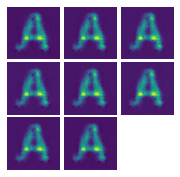

(8, 1, 64, 64)
[129/300][150/154]	Loss_D: 0.6928	Loss_G: 0.6946	D(x): 0.9994	D(G(z)): 0.4995 / 0.4993
label is ['A']


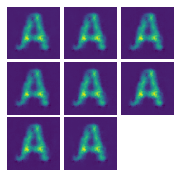

(8, 1, 64, 64)
[130/300][0/154]	Loss_D: 0.6964	Loss_G: 0.6898	D(x): 0.9999	D(G(z)): 0.5016 / 0.5017
label is ['A']


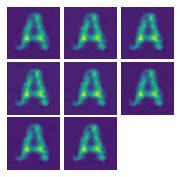

(8, 1, 64, 64)
[130/300][50/154]	Loss_D: 0.6928	Loss_G: 0.6947	D(x): 0.9991	D(G(z)): 0.4994 / 0.4992
label is ['A']


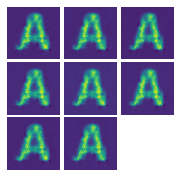

(8, 1, 64, 64)
[130/300][100/154]	Loss_D: 0.6972	Loss_G: 0.6932	D(x): 0.9942	D(G(z)): 0.4991 / 0.5000
label is ['A']


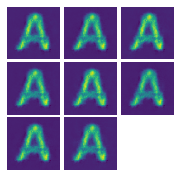

(8, 1, 64, 64)
[130/300][150/154]	Loss_D: 0.6927	Loss_G: 0.6945	D(x): 0.9997	D(G(z)): 0.4996 / 0.4993
label is ['A']


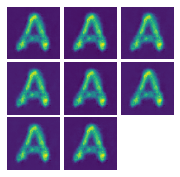

(8, 1, 64, 64)
[131/300][0/154]	Loss_D: 0.6951	Loss_G: 0.6913	D(x): 0.9999	D(G(z)): 0.5009 / 0.5009
label is ['A']


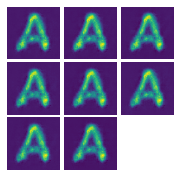

(8, 1, 64, 64)
[131/300][50/154]	Loss_D: 0.6947	Loss_G: 0.6925	D(x): 0.9999	D(G(z)): 0.5007 / 0.5003
label is ['A']


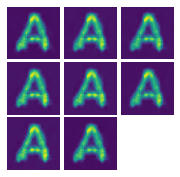

(8, 1, 64, 64)
[131/300][100/154]	Loss_D: 0.6938	Loss_G: 0.6943	D(x): 0.9988	D(G(z)): 0.4997 / 0.4994
label is ['A']


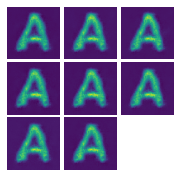

(8, 1, 64, 64)
[131/300][150/154]	Loss_D: 0.6995	Loss_G: 0.6876	D(x): 1.0000	D(G(z)): 0.5032 / 0.5028
label is ['A']


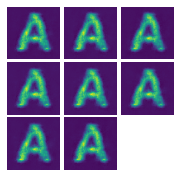

(8, 1, 64, 64)
[132/300][0/154]	Loss_D: 0.6967	Loss_G: 0.6904	D(x): 1.0000	D(G(z)): 0.5018 / 0.5014
label is ['A']


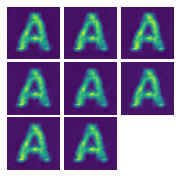

(8, 1, 64, 64)
[132/300][50/154]	Loss_D: 0.6965	Loss_G: 0.6906	D(x): 1.0000	D(G(z)): 0.5017 / 0.5013
label is ['A']


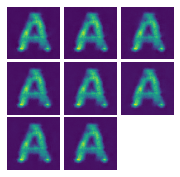

(8, 1, 64, 64)
[132/300][100/154]	Loss_D: 0.6932	Loss_G: 0.6947	D(x): 0.9981	D(G(z)): 0.4991 / 0.4992
label is ['A']


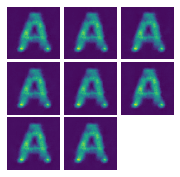

(8, 1, 64, 64)
[132/300][150/154]	Loss_D: 0.6958	Loss_G: 0.6912	D(x): 1.0000	D(G(z)): 0.5013 / 0.5010
label is ['A']


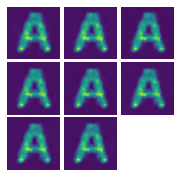

(8, 1, 64, 64)
[133/300][0/154]	Loss_D: 0.6929	Loss_G: 0.6943	D(x): 1.0000	D(G(z)): 0.4999 / 0.4994
label is ['A']


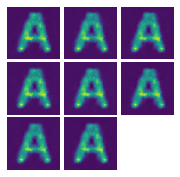

(8, 1, 64, 64)
[133/300][50/154]	Loss_D: 0.7288	Loss_G: 0.6598	D(x): 1.0000	D(G(z)): 0.5175 / 0.5170
label is ['A']


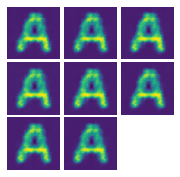

(8, 1, 64, 64)
[133/300][100/154]	Loss_D: 0.6965	Loss_G: 0.6907	D(x): 0.9999	D(G(z)): 0.5016 / 0.5012
label is ['A']


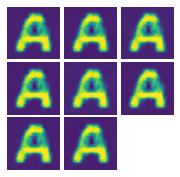

(8, 1, 64, 64)
[133/300][150/154]	Loss_D: 0.6866	Loss_G: 0.7010	D(x): 0.9997	D(G(z)): 0.4965 / 0.4961
label is ['A']


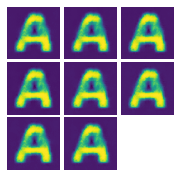

(8, 1, 64, 64)
[134/300][0/154]	Loss_D: 0.6832	Loss_G: 0.7041	D(x): 1.0000	D(G(z)): 0.4950 / 0.4945
label is ['A']


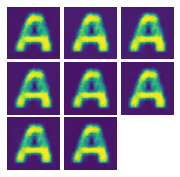

(8, 1, 64, 64)
[134/300][50/154]	Loss_D: 0.6913	Loss_G: 0.6960	D(x): 0.9998	D(G(z)): 0.4989 / 0.4986
label is ['A']


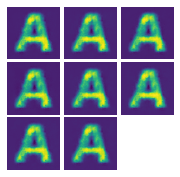

(8, 1, 64, 64)
[134/300][100/154]	Loss_D: 0.7009	Loss_G: 0.6852	D(x): 0.9999	D(G(z)): 0.5038 / 0.5040
label is ['A']


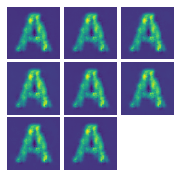

(8, 1, 64, 64)
[134/300][150/154]	Loss_D: 0.6945	Loss_G: 0.6924	D(x): 0.9998	D(G(z)): 0.5006 / 0.5004
label is ['A']


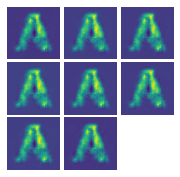

(8, 1, 64, 64)
[135/300][0/154]	Loss_D: 0.6947	Loss_G: 0.6920	D(x): 1.0000	D(G(z)): 0.5007 / 0.5006
label is ['A']


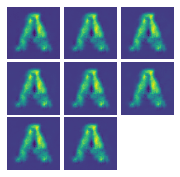

(8, 1, 64, 64)
[135/300][50/154]	Loss_D: 0.6962	Loss_G: 0.6907	D(x): 0.9998	D(G(z)): 0.5014 / 0.5012
label is ['A']


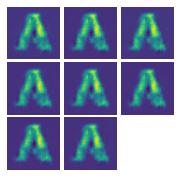

(8, 1, 64, 64)
[135/300][100/154]	Loss_D: 0.6970	Loss_G: 0.6928	D(x): 0.9964	D(G(z)): 0.5001 / 0.5002
label is ['A']


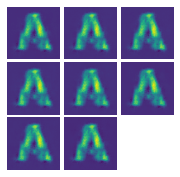

(8, 1, 64, 64)
[135/300][150/154]	Loss_D: 0.6934	Loss_G: 0.6935	D(x): 0.9998	D(G(z)): 0.5000 / 0.4998
label is ['A']


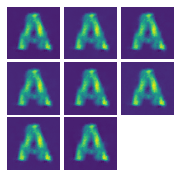

(8, 1, 64, 64)
[136/300][0/154]	Loss_D: 0.6921	Loss_G: 0.6947	D(x): 0.9998	D(G(z)): 0.4994 / 0.4992
label is ['A']


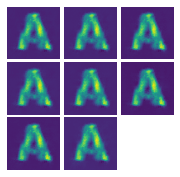

(8, 1, 64, 64)
[136/300][50/154]	Loss_D: 0.6938	Loss_G: 0.6931	D(x): 1.0000	D(G(z)): 0.5003 / 0.5000
label is ['A']


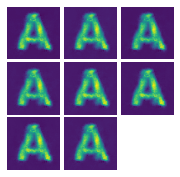

(8, 1, 64, 64)
[136/300][100/154]	Loss_D: 0.6968	Loss_G: 0.6902	D(x): 0.9999	D(G(z)): 0.5018 / 0.5015
label is ['A']


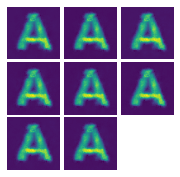

(8, 1, 64, 64)
[136/300][150/154]	Loss_D: 0.7086	Loss_G: 0.6786	D(x): 1.0000	D(G(z)): 0.5077 / 0.5073
label is ['A']


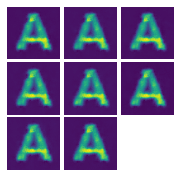

(8, 1, 64, 64)
[137/300][0/154]	Loss_D: 0.7064	Loss_G: 0.6808	D(x): 1.0000	D(G(z)): 0.5066 / 0.5062
label is ['A']


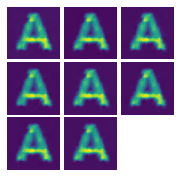

(8, 1, 64, 64)
[137/300][50/154]	Loss_D: 0.6901	Loss_G: 0.6972	D(x): 0.9995	D(G(z)): 0.4982 / 0.4980
label is ['A']


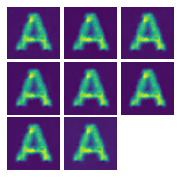

(8, 1, 64, 64)
[137/300][100/154]	Loss_D: 0.6978	Loss_G: 0.6894	D(x): 0.9997	D(G(z)): 0.5022 / 0.5019
label is ['A']


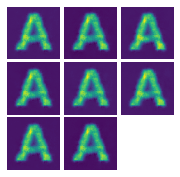

(8, 1, 64, 64)
[137/300][150/154]	Loss_D: 0.7053	Loss_G: 0.6817	D(x): 1.0000	D(G(z)): 0.5060 / 0.5057
label is ['A']


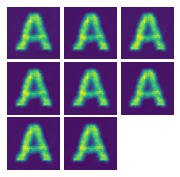

(8, 1, 64, 64)
[138/300][0/154]	Loss_D: 0.7033	Loss_G: 0.6836	D(x): 1.0000	D(G(z)): 0.5051 / 0.5048
label is ['A']


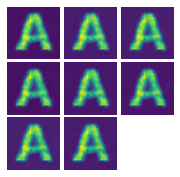

(8, 1, 64, 64)
[138/300][50/154]	Loss_D: 0.6950	Loss_G: 0.6918	D(x): 1.0000	D(G(z)): 0.5009 / 0.5007
label is ['A']


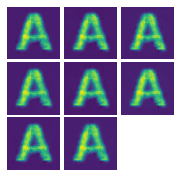

(8, 1, 64, 64)
[138/300][100/154]	Loss_D: 0.7134	Loss_G: 0.6917	D(x): 0.9783	D(G(z)): 0.4988 / 0.5007
label is ['A']


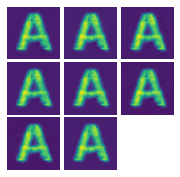

(8, 1, 64, 64)
[138/300][150/154]	Loss_D: 0.6946	Loss_G: 0.6924	D(x): 0.9999	D(G(z)): 0.5007 / 0.5004
label is ['A']


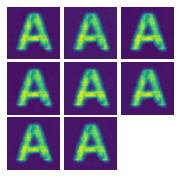

(8, 1, 64, 64)
[139/300][0/154]	Loss_D: 0.6923	Loss_G: 0.6947	D(x): 1.0000	D(G(z)): 0.4995 / 0.4992
label is ['A']


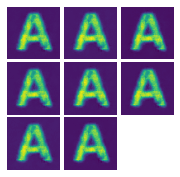

(8, 1, 64, 64)
[139/300][50/154]	Loss_D: 0.7017	Loss_G: 0.6852	D(x): 1.0000	D(G(z)): 0.5043 / 0.5040
label is ['A']


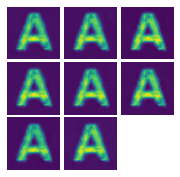

(8, 1, 64, 64)
[139/300][100/154]	Loss_D: 0.7053	Loss_G: 0.6818	D(x): 1.0000	D(G(z)): 0.5060 / 0.5057
label is ['A']


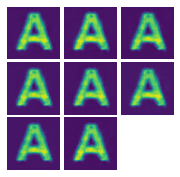

(8, 1, 64, 64)
[139/300][150/154]	Loss_D: 0.6930	Loss_G: 0.6940	D(x): 1.0000	D(G(z)): 0.4999 / 0.4996
label is ['A']


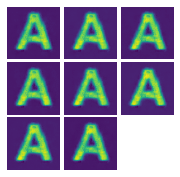

(8, 1, 64, 64)
[140/300][0/154]	Loss_D: 0.6909	Loss_G: 0.6960	D(x): 1.0000	D(G(z)): 0.4989 / 0.4986
label is ['A']


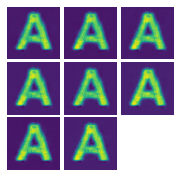

(8, 1, 64, 64)
[140/300][50/154]	Loss_D: 0.6935	Loss_G: 0.6933	D(x): 1.0000	D(G(z)): 0.5002 / 0.4999
label is ['A']


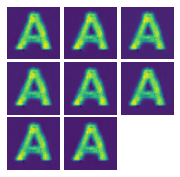

(8, 1, 64, 64)
[140/300][100/154]	Loss_D: 0.7082	Loss_G: 0.6789	D(x): 1.0000	D(G(z)): 0.5075 / 0.5072
label is ['A']


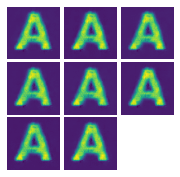

(8, 1, 64, 64)
[140/300][150/154]	Loss_D: 0.7036	Loss_G: 0.6833	D(x): 1.0000	D(G(z)): 0.5052 / 0.5049
label is ['A']


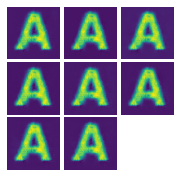

(8, 1, 64, 64)
[141/300][0/154]	Loss_D: 0.7016	Loss_G: 0.6853	D(x): 1.0000	D(G(z)): 0.5042 / 0.5039
label is ['A']


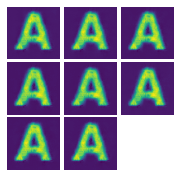

(8, 1, 64, 64)
[141/300][50/154]	Loss_D: 0.7002	Loss_G: 0.6866	D(x): 1.0000	D(G(z)): 0.5035 / 0.5033
label is ['A']


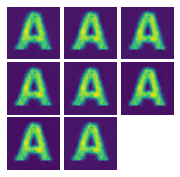

(8, 1, 64, 64)
[141/300][100/154]	Loss_D: 0.6985	Loss_G: 0.6934	D(x): 0.9941	D(G(z)): 0.4997 / 0.4999
label is ['A']


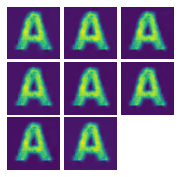

(8, 1, 64, 64)
[141/300][150/154]	Loss_D: 0.6993	Loss_G: 0.6876	D(x): 1.0000	D(G(z)): 0.5030 / 0.5028
label is ['A']


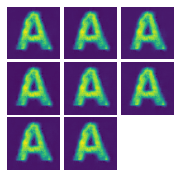

(8, 1, 64, 64)
[142/300][0/154]	Loss_D: 0.6975	Loss_G: 0.6894	D(x): 1.0000	D(G(z)): 0.5021 / 0.5019
label is ['A']


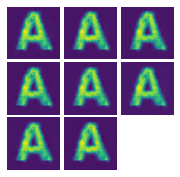

(8, 1, 64, 64)
[142/300][50/154]	Loss_D: 0.6977	Loss_G: 0.6892	D(x): 1.0000	D(G(z)): 0.5023 / 0.5020
label is ['A']


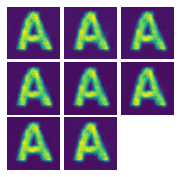

(8, 1, 64, 64)
[142/300][100/154]	Loss_D: 0.7076	Loss_G: 0.6795	D(x): 1.0000	D(G(z)): 0.5072 / 0.5069
label is ['A']


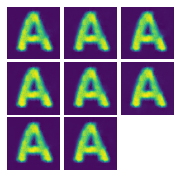

(8, 1, 64, 64)
[142/300][150/154]	Loss_D: 0.6906	Loss_G: 0.6964	D(x): 1.0000	D(G(z)): 0.4987 / 0.4984
label is ['A']


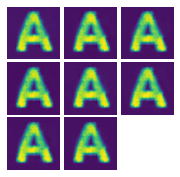

(8, 1, 64, 64)
[143/300][0/154]	Loss_D: 0.6884	Loss_G: 0.6986	D(x): 1.0000	D(G(z)): 0.4976 / 0.4973
label is ['A']


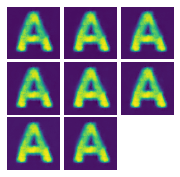

(8, 1, 64, 64)
[143/300][50/154]	Loss_D: 0.6972	Loss_G: 0.6897	D(x): 1.0000	D(G(z)): 0.5020 / 0.5017
label is ['A']


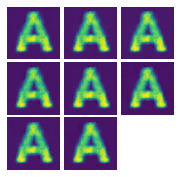

(8, 1, 64, 64)
[143/300][100/154]	Loss_D: 0.6959	Loss_G: 0.6910	D(x): 1.0000	D(G(z)): 0.5014 / 0.5011
label is ['A']


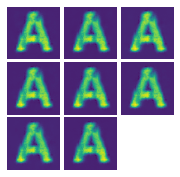

(8, 1, 64, 64)
[143/300][150/154]	Loss_D: 0.6929	Loss_G: 0.6939	D(x): 1.0000	D(G(z)): 0.4999 / 0.4996
label is ['A']


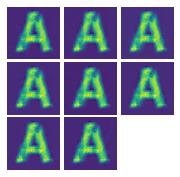

(8, 1, 64, 64)
[144/300][0/154]	Loss_D: 0.6916	Loss_G: 0.6952	D(x): 1.0000	D(G(z)): 0.4992 / 0.4990
label is ['A']


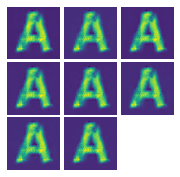

(8, 1, 64, 64)
[144/300][50/154]	Loss_D: 0.6925	Loss_G: 0.6943	D(x): 1.0000	D(G(z)): 0.4997 / 0.4994
label is ['A']


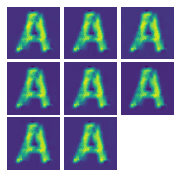

(8, 1, 64, 64)
[144/300][100/154]	Loss_D: 0.6951	Loss_G: 0.6978	D(x): 0.9929	D(G(z)): 0.4974 / 0.4977
label is ['A']


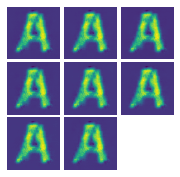

(8, 1, 64, 64)
[144/300][150/154]	Loss_D: 0.6936	Loss_G: 0.6933	D(x): 1.0000	D(G(z)): 0.5002 / 0.4999
label is ['A']


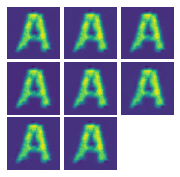

(8, 1, 64, 64)
[145/300][0/154]	Loss_D: 0.6916	Loss_G: 0.6953	D(x): 1.0000	D(G(z)): 0.4992 / 0.4989
label is ['A']


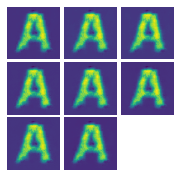

(8, 1, 64, 64)
[145/300][50/154]	Loss_D: 0.7119	Loss_G: 0.6752	D(x): 1.0000	D(G(z)): 0.5093 / 0.5091
label is ['A']


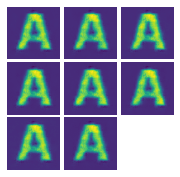

(8, 1, 64, 64)
[145/300][100/154]	Loss_D: 0.7419	Loss_G: 0.6876	D(x): 0.9532	D(G(z)): 0.4989 / 0.5028
label is ['A']


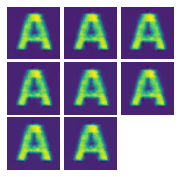

(8, 1, 64, 64)
[145/300][150/154]	Loss_D: 0.6935	Loss_G: 0.6936	D(x): 0.9999	D(G(z)): 0.5001 / 0.4998
label is ['A']


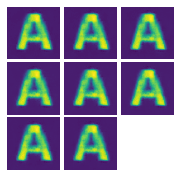

(8, 1, 64, 64)
[146/300][0/154]	Loss_D: 0.6913	Loss_G: 0.6956	D(x): 1.0000	D(G(z)): 0.4991 / 0.4988
label is ['A']


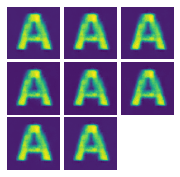

(8, 1, 64, 64)
[146/300][50/154]	Loss_D: 0.7009	Loss_G: 0.6861	D(x): 1.0000	D(G(z)): 0.5039 / 0.5036
label is ['A']


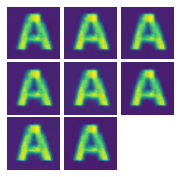

(8, 1, 64, 64)
[146/300][100/154]	Loss_D: 0.6989	Loss_G: 0.6882	D(x): 0.9999	D(G(z)): 0.5028 / 0.5025
label is ['A']


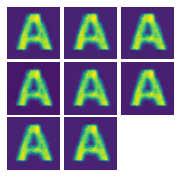

(8, 1, 64, 64)
[146/300][150/154]	Loss_D: 0.6984	Loss_G: 0.6886	D(x): 1.0000	D(G(z)): 0.5026 / 0.5023
label is ['A']


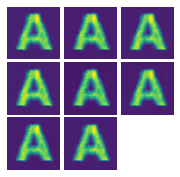

(8, 1, 64, 64)
[147/300][0/154]	Loss_D: 0.6963	Loss_G: 0.6907	D(x): 1.0000	D(G(z)): 0.5016 / 0.5012
label is ['A']


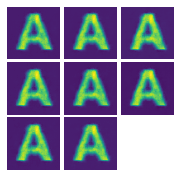

(8, 1, 64, 64)
[147/300][50/154]	Loss_D: 0.6945	Loss_G: 0.6924	D(x): 1.0000	D(G(z)): 0.5007 / 0.5003
label is ['A']


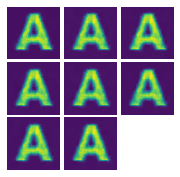

(8, 1, 64, 64)
[147/300][100/154]	Loss_D: 0.7062	Loss_G: 0.6941	D(x): 0.9843	D(G(z)): 0.4984 / 0.4995
label is ['A']


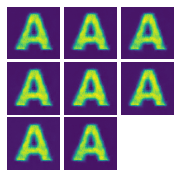

(8, 1, 64, 64)
[147/300][150/154]	Loss_D: 0.6896	Loss_G: 0.6973	D(x): 1.0000	D(G(z)): 0.4982 / 0.4979
label is ['A']


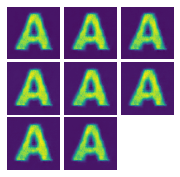

(8, 1, 64, 64)
[148/300][0/154]	Loss_D: 0.6878	Loss_G: 0.6992	D(x): 1.0000	D(G(z)): 0.4973 / 0.4970
label is ['A']


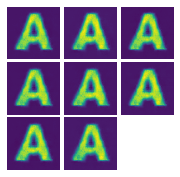

(8, 1, 64, 64)
[148/300][50/154]	Loss_D: 0.6899	Loss_G: 0.6971	D(x): 1.0000	D(G(z)): 0.4984 / 0.4980
label is ['A']


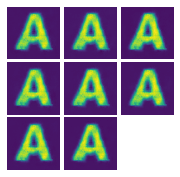

(8, 1, 64, 64)
[148/300][100/154]	Loss_D: 0.7107	Loss_G: 0.6955	D(x): 0.9784	D(G(z)): 0.4971 / 0.4988
label is ['A']


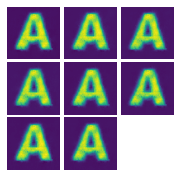

(8, 1, 64, 64)
[148/300][150/154]	Loss_D: 0.7113	Loss_G: 0.6760	D(x): 1.0000	D(G(z)): 0.5090 / 0.5086
label is ['A']


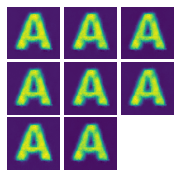

(8, 1, 64, 64)
[149/300][0/154]	Loss_D: 0.7088	Loss_G: 0.6784	D(x): 1.0000	D(G(z)): 0.5078 / 0.5074
label is ['A']


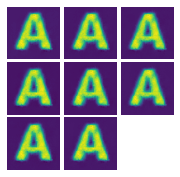

(8, 1, 64, 64)
[149/300][50/154]	Loss_D: 0.6906	Loss_G: 0.6963	D(x): 1.0000	D(G(z)): 0.4987 / 0.4984
label is ['A']


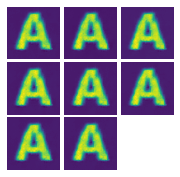

(8, 1, 64, 64)
[149/300][100/154]	Loss_D: 0.7022	Loss_G: 0.6847	D(x): 1.0000	D(G(z)): 0.5045 / 0.5042
label is ['A']


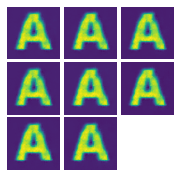

(8, 1, 64, 64)
[149/300][150/154]	Loss_D: 0.6929	Loss_G: 0.6939	D(x): 1.0000	D(G(z)): 0.4999 / 0.4996
label is ['A']


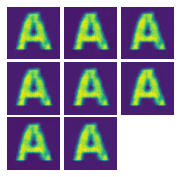

(8, 1, 64, 64)
[150/300][0/154]	Loss_D: 0.6916	Loss_G: 0.6952	D(x): 1.0000	D(G(z)): 0.4992 / 0.4990
label is ['A']


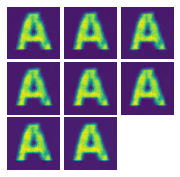

(8, 1, 64, 64)
[150/300][50/154]	Loss_D: 0.6958	Loss_G: 0.6909	D(x): 1.0000	D(G(z)): 0.5013 / 0.5011
label is ['A']


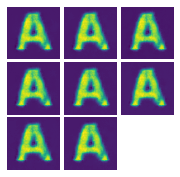

(8, 1, 64, 64)
[150/300][100/154]	Loss_D: 0.6930	Loss_G: 0.6946	D(x): 0.9991	D(G(z)): 0.4995 / 0.4993
label is ['A']


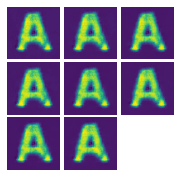

(8, 1, 64, 64)
[150/300][150/154]	Loss_D: 0.6913	Loss_G: 0.6958	D(x): 0.9999	D(G(z)): 0.4990 / 0.4987
label is ['A']


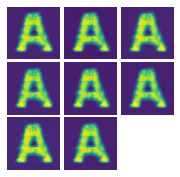

(8, 1, 64, 64)
[151/300][0/154]	Loss_D: 0.6891	Loss_G: 0.6979	D(x): 1.0000	D(G(z)): 0.4980 / 0.4976
label is ['A']


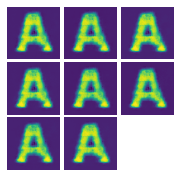

(8, 1, 64, 64)
[151/300][50/154]	Loss_D: 0.6912	Loss_G: 0.6957	D(x): 0.9999	D(G(z)): 0.4990 / 0.4987
label is ['A']


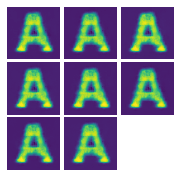

(8, 1, 64, 64)
[151/300][100/154]	Loss_D: 0.6962	Loss_G: 0.6908	D(x): 1.0000	D(G(z)): 0.5015 / 0.5012
label is ['A']


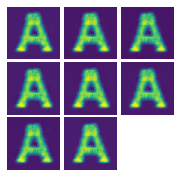

(8, 1, 64, 64)
[151/300][150/154]	Loss_D: 0.6891	Loss_G: 0.6978	D(x): 1.0000	D(G(z)): 0.4980 / 0.4977
label is ['A']


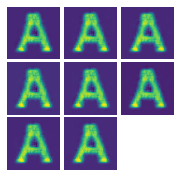

(8, 1, 64, 64)
[152/300][0/154]	Loss_D: 0.6879	Loss_G: 0.6990	D(x): 1.0000	D(G(z)): 0.4974 / 0.4971
label is ['A']


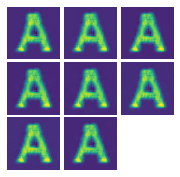

(8, 1, 64, 64)
[152/300][50/154]	Loss_D: 0.6937	Loss_G: 0.6933	D(x): 0.9999	D(G(z)): 0.5002 / 0.4999
label is ['A']


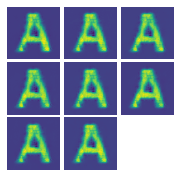

(8, 1, 64, 64)
[152/300][100/154]	Loss_D: 0.6924	Loss_G: 0.6950	D(x): 0.9994	D(G(z)): 0.4994 / 0.4991
label is ['A']


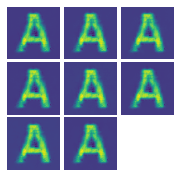

(8, 1, 64, 64)
[152/300][150/154]	Loss_D: 0.6883	Loss_G: 0.6987	D(x): 0.9999	D(G(z)): 0.4975 / 0.4972
label is ['A']


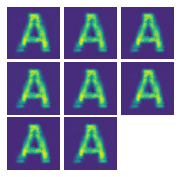

(8, 1, 64, 64)
[153/300][0/154]	Loss_D: 0.6899	Loss_G: 0.6968	D(x): 0.9999	D(G(z)): 0.4983 / 0.4982
label is ['A']


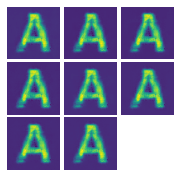

(8, 1, 64, 64)
[153/300][50/154]	Loss_D: 0.6958	Loss_G: 0.6913	D(x): 1.0000	D(G(z)): 0.5013 / 0.5009
label is ['A']


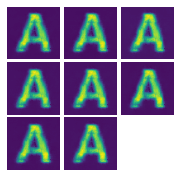

(8, 1, 64, 64)
[153/300][100/154]	Loss_D: 0.6920	Loss_G: 0.6975	D(x): 0.9973	D(G(z)): 0.4981 / 0.4978
label is ['A']


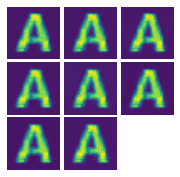

(8, 1, 64, 64)
[153/300][150/154]	Loss_D: 0.7269	Loss_G: 0.6612	D(x): 1.0000	D(G(z)): 0.5166 / 0.5162
label is ['A']


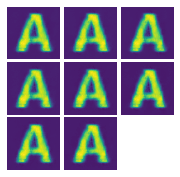

(8, 1, 64, 64)
[154/300][0/154]	Loss_D: 0.7251	Loss_G: 0.6629	D(x): 1.0000	D(G(z)): 0.5157 / 0.5154
label is ['A']


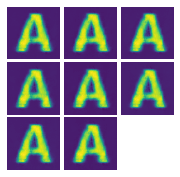

(8, 1, 64, 64)
[154/300][50/154]	Loss_D: 0.6992	Loss_G: 0.6881	D(x): 0.9995	D(G(z)): 0.5028 / 0.5025
label is ['A']


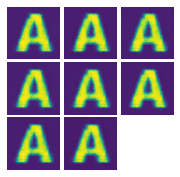

(8, 1, 64, 64)
[154/300][100/154]	Loss_D: 0.6926	Loss_G: 0.6946	D(x): 0.9997	D(G(z)): 0.4996 / 0.4993
label is ['A']


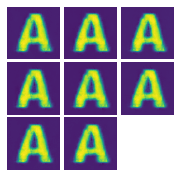

(8, 1, 64, 64)
[154/300][150/154]	Loss_D: 0.6938	Loss_G: 0.6930	D(x): 1.0000	D(G(z)): 0.5003 / 0.5001
label is ['A']


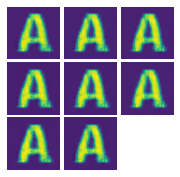

(8, 1, 64, 64)
[155/300][0/154]	Loss_D: 0.6933	Loss_G: 0.6935	D(x): 1.0000	D(G(z)): 0.5000 / 0.4998
label is ['A']


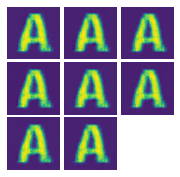

(8, 1, 64, 64)
[155/300][50/154]	Loss_D: 0.7042	Loss_G: 0.6906	D(x): 0.9910	D(G(z)): 0.5010 / 0.5013
label is ['A']


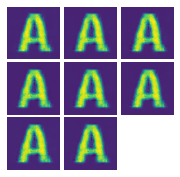

(8, 1, 64, 64)
[155/300][100/154]	Loss_D: 0.6965	Loss_G: 0.6904	D(x): 0.9999	D(G(z)): 0.5016 / 0.5014
label is ['A']


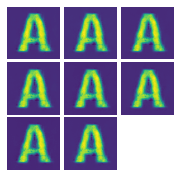

(8, 1, 64, 64)
[155/300][150/154]	Loss_D: 0.6939	Loss_G: 0.6928	D(x): 1.0000	D(G(z)): 0.5004 / 0.5002
label is ['A']


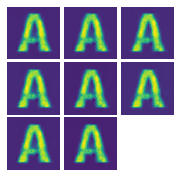

(8, 1, 64, 64)
[156/300][0/154]	Loss_D: 0.6936	Loss_G: 0.6933	D(x): 0.9998	D(G(z)): 0.5001 / 0.4999
label is ['A']


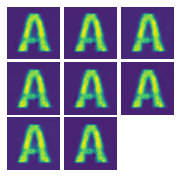

(8, 1, 64, 64)
[156/300][50/154]	Loss_D: 0.6955	Loss_G: 0.6918	D(x): 0.9993	D(G(z)): 0.5008 / 0.5007
label is ['A']


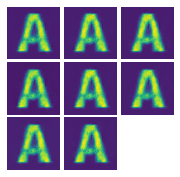

(8, 1, 64, 64)
[156/300][100/154]	Loss_D: 0.7006	Loss_G: 0.6863	D(x): 1.0000	D(G(z)): 0.5037 / 0.5034
label is ['A']


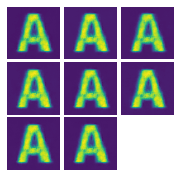

(8, 1, 64, 64)
[156/300][150/154]	Loss_D: 0.6937	Loss_G: 0.6931	D(x): 1.0000	D(G(z)): 0.5003 / 0.5000
label is ['A']


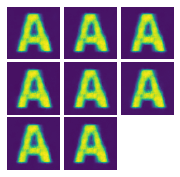

(8, 1, 64, 64)
[157/300][0/154]	Loss_D: 0.6930	Loss_G: 0.6939	D(x): 0.9999	D(G(z)): 0.4999 / 0.4996
label is ['A']


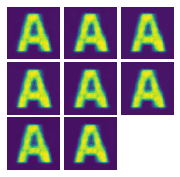

(8, 1, 64, 64)
[157/300][50/154]	Loss_D: 0.7225	Loss_G: 0.6648	D(x): 1.0000	D(G(z)): 0.5144 / 0.5144
label is ['A']


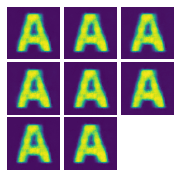

(8, 1, 64, 64)
[157/300][100/154]	Loss_D: 0.7007	Loss_G: 0.6861	D(x): 1.0000	D(G(z)): 0.5037 / 0.5035
label is ['A']


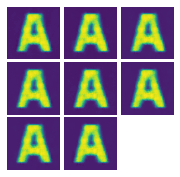

(8, 1, 64, 64)
[157/300][150/154]	Loss_D: 0.7027	Loss_G: 0.6842	D(x): 1.0000	D(G(z)): 0.5047 / 0.5045
label is ['A']


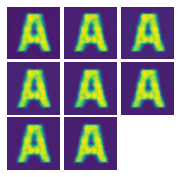

(8, 1, 64, 64)
[158/300][0/154]	Loss_D: 0.7013	Loss_G: 0.6856	D(x): 1.0000	D(G(z)): 0.5040 / 0.5038
label is ['A']


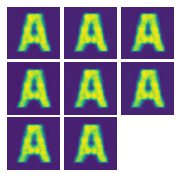

(8, 1, 64, 64)
[158/300][50/154]	Loss_D: 0.7054	Loss_G: 0.6812	D(x): 1.0000	D(G(z)): 0.5061 / 0.5060
label is ['A']


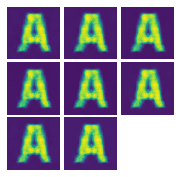

(8, 1, 64, 64)
[158/300][100/154]	Loss_D: 0.7086	Loss_G: 0.6783	D(x): 1.0000	D(G(z)): 0.5077 / 0.5075
label is ['A']


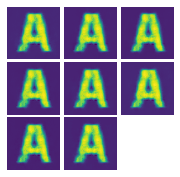

(8, 1, 64, 64)
[158/300][150/154]	Loss_D: 0.6972	Loss_G: 0.6895	D(x): 1.0000	D(G(z)): 0.5020 / 0.5018
label is ['A']


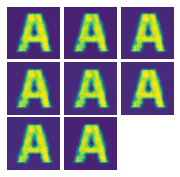

(8, 1, 64, 64)
[159/300][0/154]	Loss_D: 0.6963	Loss_G: 0.6904	D(x): 0.9999	D(G(z)): 0.5015 / 0.5014
label is ['A']


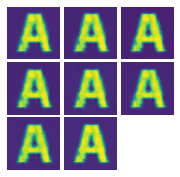

(8, 1, 64, 64)
[159/300][50/154]	Loss_D: 0.7144	Loss_G: 0.6724	D(x): 1.0000	D(G(z)): 0.5105 / 0.5105
label is ['A']


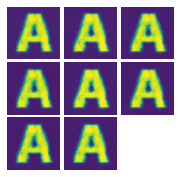

(8, 1, 64, 64)
[159/300][100/154]	Loss_D: 0.6975	Loss_G: 0.6893	D(x): 0.9999	D(G(z)): 0.5021 / 0.5019
label is ['A']


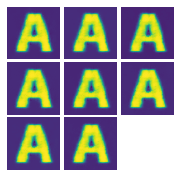

(8, 1, 64, 64)
[159/300][150/154]	Loss_D: 0.6923	Loss_G: 0.6945	D(x): 1.0000	D(G(z)): 0.4995 / 0.4993
label is ['A']


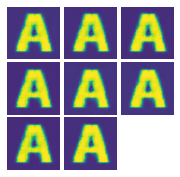

(8, 1, 64, 64)
[160/300][0/154]	Loss_D: 0.6908	Loss_G: 0.6960	D(x): 1.0000	D(G(z)): 0.4988 / 0.4986
label is ['A']


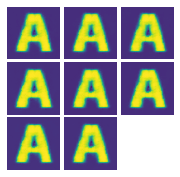

(8, 1, 64, 64)
[160/300][50/154]	Loss_D: 0.7012	Loss_G: 0.6854	D(x): 0.9999	D(G(z)): 0.5040 / 0.5039
label is ['A']


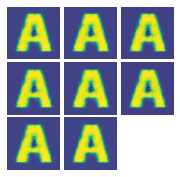

(8, 1, 64, 64)
[160/300][100/154]	Loss_D: 0.7081	Loss_G: 0.6789	D(x): 1.0000	D(G(z)): 0.5074 / 0.5072
label is ['A']


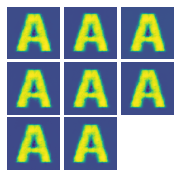

(8, 1, 64, 64)
[160/300][150/154]	Loss_D: 0.6939	Loss_G: 0.6928	D(x): 1.0000	D(G(z)): 0.5004 / 0.5002
label is ['A']


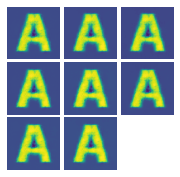

(8, 1, 64, 64)
[161/300][0/154]	Loss_D: 0.6928	Loss_G: 0.6940	D(x): 1.0000	D(G(z)): 0.4998 / 0.4996
label is ['A']


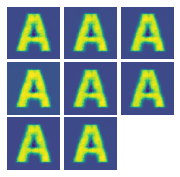

(8, 1, 64, 64)
[161/300][50/154]	Loss_D: 0.6989	Loss_G: 0.6885	D(x): 0.9991	D(G(z)): 0.5024 / 0.5023
label is ['A']


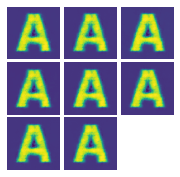

(8, 1, 64, 64)
[161/300][100/154]	Loss_D: 0.7093	Loss_G: 0.6777	D(x): 1.0000	D(G(z)): 0.5080 / 0.5078
label is ['A']


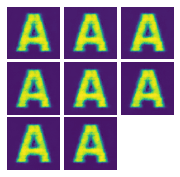

(8, 1, 64, 64)
[161/300][150/154]	Loss_D: 0.6954	Loss_G: 0.6912	D(x): 1.0000	D(G(z)): 0.5011 / 0.5010
label is ['A']


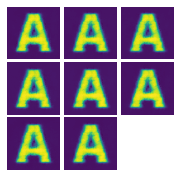

(8, 1, 64, 64)
[162/300][0/154]	Loss_D: 0.6945	Loss_G: 0.6922	D(x): 0.9999	D(G(z)): 0.5006 / 0.5005
label is ['A']


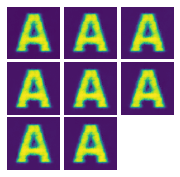

(8, 1, 64, 64)
[162/300][50/154]	Loss_D: 0.6992	Loss_G: 0.6899	D(x): 0.9971	D(G(z)): 0.5016 / 0.5016
label is ['A']


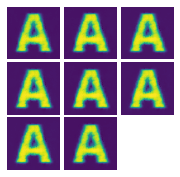

(8, 1, 64, 64)
[162/300][100/154]	Loss_D: 0.7133	Loss_G: 0.6737	D(x): 1.0000	D(G(z)): 0.5100 / 0.5098
label is ['A']


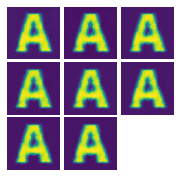

(8, 1, 64, 64)
[162/300][150/154]	Loss_D: 0.6994	Loss_G: 0.6872	D(x): 1.0000	D(G(z)): 0.5031 / 0.5030
label is ['A']


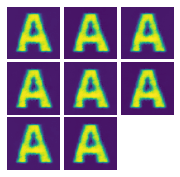

(8, 1, 64, 64)
[163/300][0/154]	Loss_D: 0.6984	Loss_G: 0.6883	D(x): 1.0000	D(G(z)): 0.5026 / 0.5025
label is ['A']


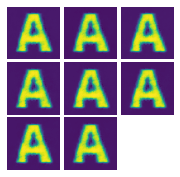

(8, 1, 64, 64)
[163/300][50/154]	Loss_D: 0.6962	Loss_G: 0.6923	D(x): 0.9978	D(G(z)): 0.5004 / 0.5004
label is ['A']


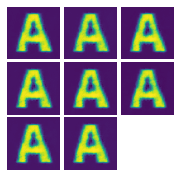

(8, 1, 64, 64)
[163/300][100/154]	Loss_D: 0.7037	Loss_G: 0.6830	D(x): 1.0000	D(G(z)): 0.5052 / 0.5051
label is ['A']


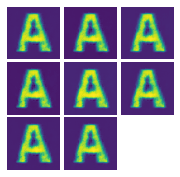

(8, 1, 64, 64)
[163/300][150/154]	Loss_D: 0.6930	Loss_G: 0.6936	D(x): 1.0000	D(G(z)): 0.4999 / 0.4998
label is ['A']


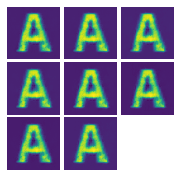

(8, 1, 64, 64)
[164/300][0/154]	Loss_D: 0.6925	Loss_G: 0.6942	D(x): 0.9999	D(G(z)): 0.4996 / 0.4995
label is ['A']


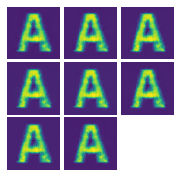

(8, 1, 64, 64)
[164/300][50/154]	Loss_D: 0.6933	Loss_G: 0.6936	D(x): 0.9995	D(G(z)): 0.4998 / 0.4998
label is ['A']


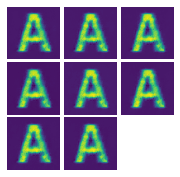

(8, 1, 64, 64)
[164/300][100/154]	Loss_D: 0.6957	Loss_G: 0.6912	D(x): 0.9998	D(G(z)): 0.5012 / 0.5010
label is ['A']


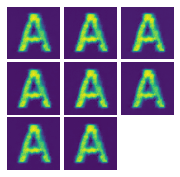

(8, 1, 64, 64)
[164/300][150/154]	Loss_D: 0.6928	Loss_G: 0.6940	D(x): 0.9999	D(G(z)): 0.4998 / 0.4996
label is ['A']


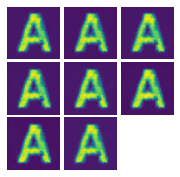

(8, 1, 64, 64)
[165/300][0/154]	Loss_D: 0.6933	Loss_G: 0.6937	D(x): 0.9997	D(G(z)): 0.4999 / 0.4997
label is ['A']


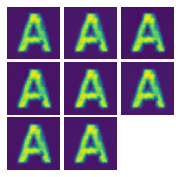

(8, 1, 64, 64)
[165/300][50/154]	Loss_D: 0.6964	Loss_G: 0.6912	D(x): 0.9990	D(G(z)): 0.5011 / 0.5010
label is ['A']


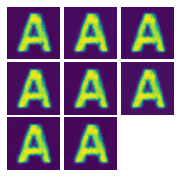

(8, 1, 64, 64)
[165/300][100/154]	Loss_D: 0.6967	Loss_G: 0.6903	D(x): 0.9999	D(G(z)): 0.5017 / 0.5014
label is ['A']


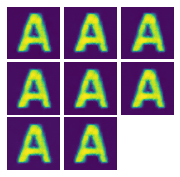

(8, 1, 64, 64)
[165/300][150/154]	Loss_D: 0.6973	Loss_G: 0.6896	D(x): 1.0000	D(G(z)): 0.5021 / 0.5018
label is ['A']


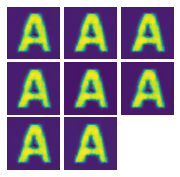

(8, 1, 64, 64)
[166/300][0/154]	Loss_D: 0.6957	Loss_G: 0.6912	D(x): 0.9999	D(G(z)): 0.5012 / 0.5010
label is ['A']


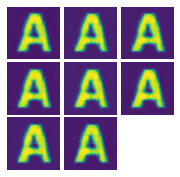

(8, 1, 64, 64)
[166/300][50/154]	Loss_D: 0.6986	Loss_G: 0.6922	D(x): 0.9953	D(G(z)): 0.5004 / 0.5005
label is ['A']


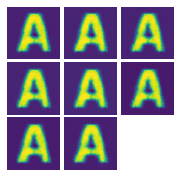

(8, 1, 64, 64)
[166/300][100/154]	Loss_D: 0.7172	Loss_G: 0.6702	D(x): 1.0000	D(G(z)): 0.5119 / 0.5116
label is ['A']


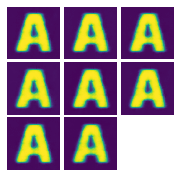

(8, 1, 64, 64)
[166/300][150/154]	Loss_D: 0.6968	Loss_G: 0.6900	D(x): 1.0000	D(G(z)): 0.5018 / 0.5016
label is ['A']


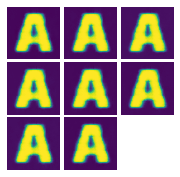

(8, 1, 64, 64)
[167/300][0/154]	Loss_D: 0.6954	Loss_G: 0.6915	D(x): 1.0000	D(G(z)): 0.5011 / 0.5008
label is ['A']


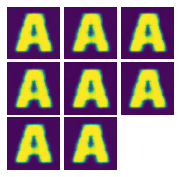

(8, 1, 64, 64)
[167/300][50/154]	Loss_D: 0.6985	Loss_G: 0.6904	D(x): 0.9975	D(G(z)): 0.5014 / 0.5014
label is ['A']


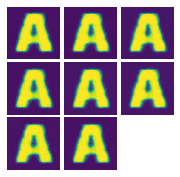

(8, 1, 64, 64)
[167/300][100/154]	Loss_D: 0.7108	Loss_G: 0.6764	D(x): 1.0000	D(G(z)): 0.5087 / 0.5085
label is ['A']


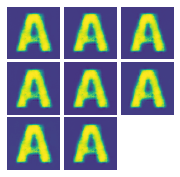

(8, 1, 64, 64)
[167/300][150/154]	Loss_D: 0.6999	Loss_G: 0.6869	D(x): 1.0000	D(G(z)): 0.5033 / 0.5031
label is ['A']


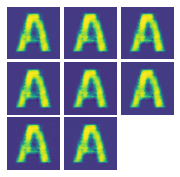

(8, 1, 64, 64)
[168/300][0/154]	Loss_D: 0.6990	Loss_G: 0.6878	D(x): 1.0000	D(G(z)): 0.5029 / 0.5027
label is ['A']


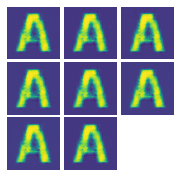

(8, 1, 64, 64)
[168/300][50/154]	Loss_D: 0.7064	Loss_G: 0.6877	D(x): 0.9921	D(G(z)): 0.5026 / 0.5027
label is ['A']


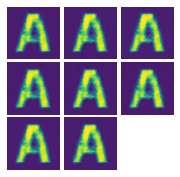

(8, 1, 64, 64)
[168/300][100/154]	Loss_D: 0.6989	Loss_G: 0.6882	D(x): 0.9996	D(G(z)): 0.5026 / 0.5025
label is ['A']


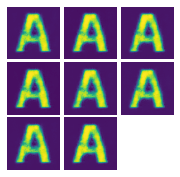

(8, 1, 64, 64)
[168/300][150/154]	Loss_D: 0.6932	Loss_G: 0.6936	D(x): 0.9999	D(G(z)): 0.5000 / 0.4998
label is ['A']


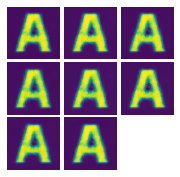

(8, 1, 64, 64)
[169/300][0/154]	Loss_D: 0.6923	Loss_G: 0.6945	D(x): 0.9999	D(G(z)): 0.4995 / 0.4993
label is ['A']


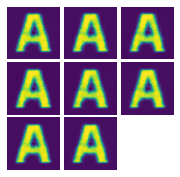

(8, 1, 64, 64)
[169/300][50/154]	Loss_D: 0.6985	Loss_G: 0.6884	D(x): 0.9996	D(G(z)): 0.5025 / 0.5024
label is ['A']


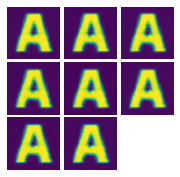

(8, 1, 64, 64)
[169/300][100/154]	Loss_D: 0.7077	Loss_G: 0.6794	D(x): 0.9999	D(G(z)): 0.5072 / 0.5069
label is ['A']


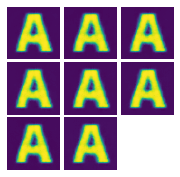

(8, 1, 64, 64)
[169/300][150/154]	Loss_D: 0.6943	Loss_G: 0.6924	D(x): 1.0000	D(G(z)): 0.5006 / 0.5004
label is ['A']


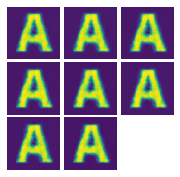

(8, 1, 64, 64)
[170/300][0/154]	Loss_D: 0.6930	Loss_G: 0.6937	D(x): 1.0000	D(G(z)): 0.4999 / 0.4997
label is ['A']


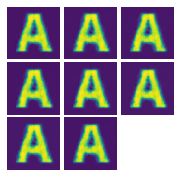

(8, 1, 64, 64)
[170/300][50/154]	Loss_D: 0.6990	Loss_G: 0.6879	D(x): 0.9997	D(G(z)): 0.5027 / 0.5026
label is ['A']


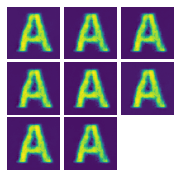

(8, 1, 64, 64)
[170/300][100/154]	Loss_D: 0.6985	Loss_G: 0.6887	D(x): 0.9996	D(G(z)): 0.5025 / 0.5022
label is ['A']


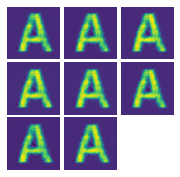

(8, 1, 64, 64)
[170/300][150/154]	Loss_D: 0.6931	Loss_G: 0.6938	D(x): 0.9999	D(G(z)): 0.4999 / 0.4997
label is ['A']


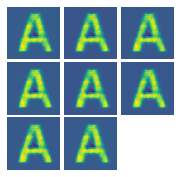

(8, 1, 64, 64)
[171/300][0/154]	Loss_D: 0.6933	Loss_G: 0.6934	D(x): 0.9999	D(G(z)): 0.5000 / 0.4999
label is ['A']


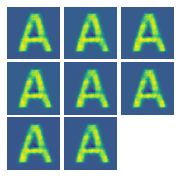

(8, 1, 64, 64)
[171/300][50/154]	Loss_D: 0.6953	Loss_G: 0.6937	D(x): 0.9974	D(G(z)): 0.4998 / 0.4997
label is ['A']


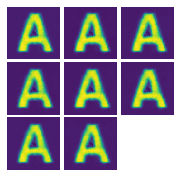

(8, 1, 64, 64)
[171/300][100/154]	Loss_D: 0.6940	Loss_G: 0.6928	D(x): 0.9994	D(G(z)): 0.5001 / 0.5002
label is ['A']


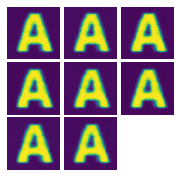

(8, 1, 64, 64)
[171/300][150/154]	Loss_D: 0.6949	Loss_G: 0.6920	D(x): 1.0000	D(G(z)): 0.5009 / 0.5006
label is ['A']


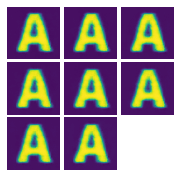

(8, 1, 64, 64)
[172/300][0/154]	Loss_D: 0.6932	Loss_G: 0.6936	D(x): 1.0000	D(G(z)): 0.5000 / 0.4998
label is ['A']


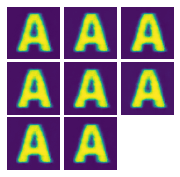

(8, 1, 64, 64)
[172/300][50/154]	Loss_D: 0.7336	Loss_G: 0.6876	D(x): 0.9636	D(G(z)): 0.5005 / 0.5028
label is ['A']


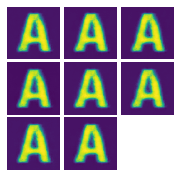

(8, 1, 64, 64)
[172/300][100/154]	Loss_D: 0.6972	Loss_G: 0.6897	D(x): 0.9999	D(G(z)): 0.5020 / 0.5017
label is ['A']


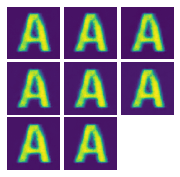

(8, 1, 64, 64)
[172/300][150/154]	Loss_D: 0.6943	Loss_G: 0.6925	D(x): 1.0000	D(G(z)): 0.5006 / 0.5003
label is ['A']


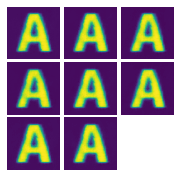

(8, 1, 64, 64)
[173/300][0/154]	Loss_D: 0.6957	Loss_G: 0.6909	D(x): 1.0000	D(G(z)): 0.5013 / 0.5011
label is ['A']


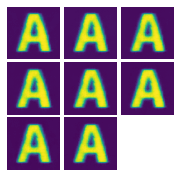

(8, 1, 64, 64)
[173/300][50/154]	Loss_D: 0.7253	Loss_G: 0.6622	D(x): 1.0000	D(G(z)): 0.5158 / 0.5157
label is ['A']


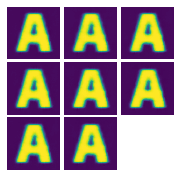

(8, 1, 64, 64)
[173/300][100/154]	Loss_D: 0.7017	Loss_G: 0.6851	D(x): 1.0000	D(G(z)): 0.5043 / 0.5041
label is ['A']


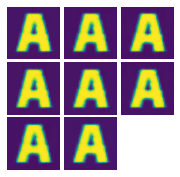

(8, 1, 64, 64)
[173/300][150/154]	Loss_D: 0.6985	Loss_G: 0.6883	D(x): 1.0000	D(G(z)): 0.5027 / 0.5024
label is ['A']


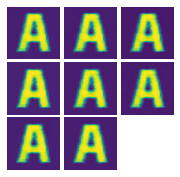

(8, 1, 64, 64)
[174/300][0/154]	Loss_D: 0.6976	Loss_G: 0.6891	D(x): 1.0000	D(G(z)): 0.5022 / 0.5020
label is ['A']


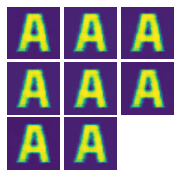

(8, 1, 64, 64)
[174/300][50/154]	Loss_D: 0.7023	Loss_G: 0.6848	D(x): 0.9994	D(G(z)): 0.5043 / 0.5042
label is ['A']


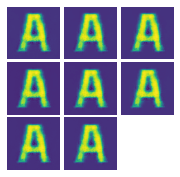

(8, 1, 64, 64)
[174/300][100/154]	Loss_D: 0.6947	Loss_G: 0.6920	D(x): 0.9999	D(G(z)): 0.5007 / 0.5006
label is ['A']


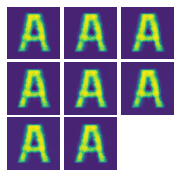

(8, 1, 64, 64)
[174/300][150/154]	Loss_D: 0.6937	Loss_G: 0.6930	D(x): 1.0000	D(G(z)): 0.5003 / 0.5001
label is ['A']


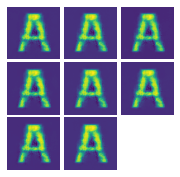

(8, 1, 64, 64)
[175/300][0/154]	Loss_D: 0.6938	Loss_G: 0.6934	D(x): 0.9995	D(G(z)): 0.5001 / 0.4999
label is ['A']


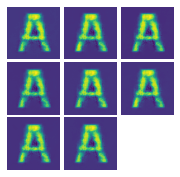

(8, 1, 64, 64)
[175/300][50/154]	Loss_D: 0.6931	Loss_G: 0.6940	D(x): 0.9996	D(G(z)): 0.4998 / 0.4996
label is ['A']


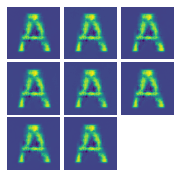

(8, 1, 64, 64)
[175/300][100/154]	Loss_D: 0.6927	Loss_G: 0.6950	D(x): 0.9991	D(G(z)): 0.4993 / 0.4991
label is ['A']


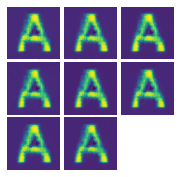

(8, 1, 64, 64)
[175/300][150/154]	Loss_D: 0.6984	Loss_G: 0.6890	D(x): 0.9996	D(G(z)): 0.5024 / 0.5021
label is ['A']


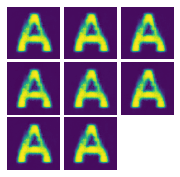

(8, 1, 64, 64)
[176/300][0/154]	Loss_D: 0.6966	Loss_G: 0.6907	D(x): 0.9996	D(G(z)): 0.5015 / 0.5012
label is ['A']


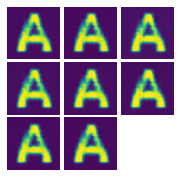

(8, 1, 64, 64)
[176/300][50/154]	Loss_D: 0.6947	Loss_G: 0.6925	D(x): 0.9997	D(G(z)): 0.5006 / 0.5003
label is ['A']


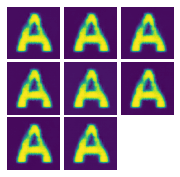

(8, 1, 64, 64)
[176/300][100/154]	Loss_D: 0.6909	Loss_G: 0.6963	D(x): 0.9998	D(G(z)): 0.4988 / 0.4984
label is ['A']


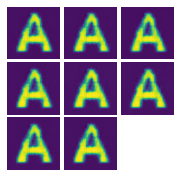

(8, 1, 64, 64)
[176/300][150/154]	Loss_D: 0.7008	Loss_G: 0.6862	D(x): 0.9999	D(G(z)): 0.5038 / 0.5035
label is ['A']


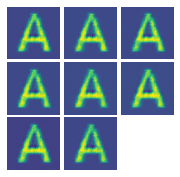

(8, 1, 64, 64)
[177/300][0/154]	Loss_D: 0.6990	Loss_G: 0.6881	D(x): 0.9999	D(G(z)): 0.5029 / 0.5025
label is ['A']


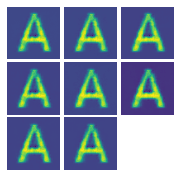

(8, 1, 64, 64)
[177/300][50/154]	Loss_D: 0.6944	Loss_G: 0.6923	D(x): 1.0000	D(G(z)): 0.5006 / 0.5004
label is ['A']


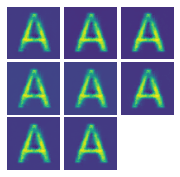

(8, 1, 64, 64)
[177/300][100/154]	Loss_D: 0.6974	Loss_G: 0.6900	D(x): 0.9995	D(G(z)): 0.5019 / 0.5016
label is ['A']


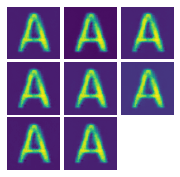

(8, 1, 64, 64)
[177/300][150/154]	Loss_D: 0.6949	Loss_G: 0.6921	D(x): 0.9999	D(G(z)): 0.5009 / 0.5005
label is ['A']


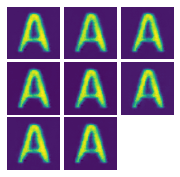

(8, 1, 64, 64)
[178/300][0/154]	Loss_D: 0.6933	Loss_G: 0.6937	D(x): 0.9999	D(G(z)): 0.5001 / 0.4997
label is ['A']


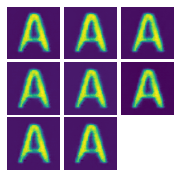

(8, 1, 64, 64)
[178/300][50/154]	Loss_D: 0.6941	Loss_G: 0.6925	D(x): 0.9999	D(G(z)): 0.5004 / 0.5003
label is ['A']


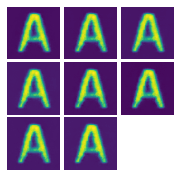

(8, 1, 64, 64)
[178/300][100/154]	Loss_D: 0.6927	Loss_G: 0.6954	D(x): 0.9988	D(G(z)): 0.4992 / 0.4989
label is ['A']


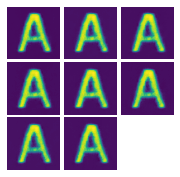

(8, 1, 64, 64)
[178/300][150/154]	Loss_D: 0.7056	Loss_G: 0.6816	D(x): 1.0000	D(G(z)): 0.5062 / 0.5058
label is ['A']


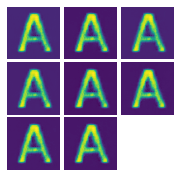

(8, 1, 64, 64)
[179/300][0/154]	Loss_D: 0.7035	Loss_G: 0.6837	D(x): 1.0000	D(G(z)): 0.5051 / 0.5047
label is ['A']


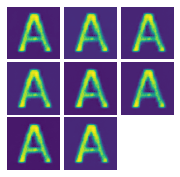

(8, 1, 64, 64)
[179/300][50/154]	Loss_D: 0.6955	Loss_G: 0.6912	D(x): 1.0000	D(G(z)): 0.5011 / 0.5010
label is ['A']


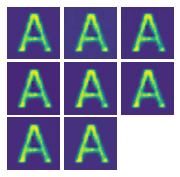

(8, 1, 64, 64)
[179/300][100/154]	Loss_D: 0.6969	Loss_G: 0.6902	D(x): 0.9999	D(G(z)): 0.5018 / 0.5015
label is ['A']


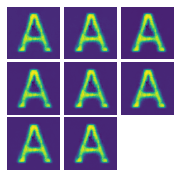

(8, 1, 64, 64)
[179/300][150/154]	Loss_D: 0.7073	Loss_G: 0.6799	D(x): 1.0000	D(G(z)): 0.5070 / 0.5067
label is ['A']


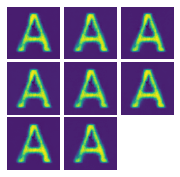

(8, 1, 64, 64)
[180/300][0/154]	Loss_D: 0.7049	Loss_G: 0.6822	D(x): 1.0000	D(G(z)): 0.5058 / 0.5055
label is ['A']


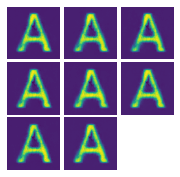

(8, 1, 64, 64)
[180/300][50/154]	Loss_D: 0.6942	Loss_G: 0.6920	D(x): 1.0000	D(G(z)): 0.5005 / 0.5006
label is ['A']


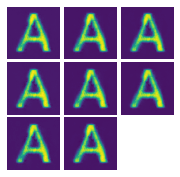

(8, 1, 64, 64)
[180/300][100/154]	Loss_D: 0.6929	Loss_G: 0.6942	D(x): 0.9998	D(G(z)): 0.4998 / 0.4995
label is ['A']


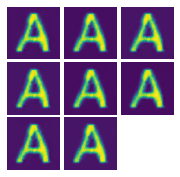

(8, 1, 64, 64)
[180/300][150/154]	Loss_D: 0.7109	Loss_G: 0.6764	D(x): 1.0000	D(G(z)): 0.5088 / 0.5084
label is ['A']


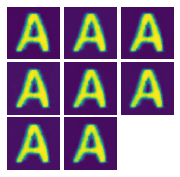

(8, 1, 64, 64)
[181/300][0/154]	Loss_D: 0.7084	Loss_G: 0.6788	D(x): 1.0000	D(G(z)): 0.5076 / 0.5072
label is ['A']


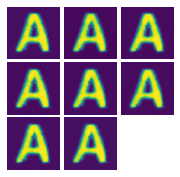

(8, 1, 64, 64)
[181/300][50/154]	Loss_D: 0.6964	Loss_G: 0.6909	D(x): 0.9997	D(G(z)): 0.5015 / 0.5011
label is ['A']


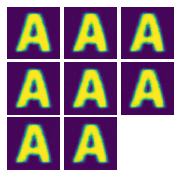

(8, 1, 64, 64)
[181/300][100/154]	Loss_D: 0.7344	Loss_G: 0.6546	D(x): 1.0000	D(G(z)): 0.5202 / 0.5196
label is ['A']


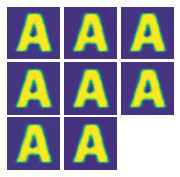

(8, 1, 64, 64)
[181/300][150/154]	Loss_D: 0.7025	Loss_G: 0.6845	D(x): 1.0000	D(G(z)): 0.5046 / 0.5044
label is ['A']


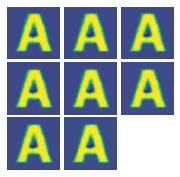

(8, 1, 64, 64)
[182/300][0/154]	Loss_D: 0.7005	Loss_G: 0.6864	D(x): 1.0000	D(G(z)): 0.5037 / 0.5034
label is ['A']


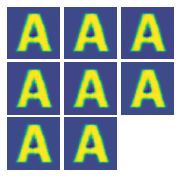

(8, 1, 64, 64)
[182/300][50/154]	Loss_D: 0.7037	Loss_G: 0.6868	D(x): 0.9961	D(G(z)): 0.5033 / 0.5032
label is ['A']


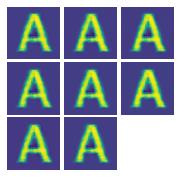

(8, 1, 64, 64)
[182/300][100/154]	Loss_D: 0.6989	Loss_G: 0.6881	D(x): 0.9998	D(G(z)): 0.5028 / 0.5025
label is ['A']


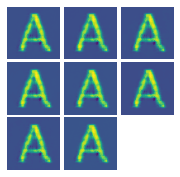

(8, 1, 64, 64)
[182/300][150/154]	Loss_D: 0.6949	Loss_G: 0.6919	D(x): 0.9999	D(G(z)): 0.5008 / 0.5006
label is ['A']


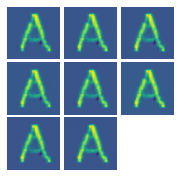

(8, 1, 64, 64)
[183/300][0/154]	Loss_D: 0.6946	Loss_G: 0.6923	D(x): 0.9997	D(G(z)): 0.5006 / 0.5004
label is ['A']


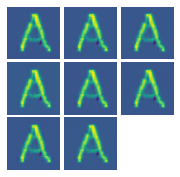

(8, 1, 64, 64)
[183/300][50/154]	Loss_D: 0.6974	Loss_G: 0.6875	D(x): 0.9999	D(G(z)): 0.5021 / 0.5028
label is ['A']


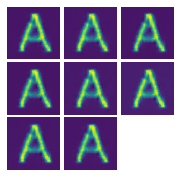

(8, 1, 64, 64)
[183/300][100/154]	Loss_D: 0.7014	Loss_G: 0.6855	D(x): 0.9999	D(G(z)): 0.5041 / 0.5038
label is ['A']


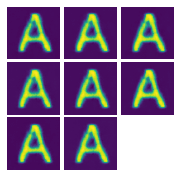

(8, 1, 64, 64)
[183/300][150/154]	Loss_D: 0.6939	Loss_G: 0.6930	D(x): 0.9999	D(G(z)): 0.5003 / 0.5001
label is ['A']


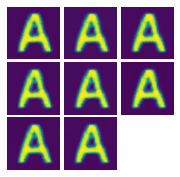

(8, 1, 64, 64)
[184/300][0/154]	Loss_D: 0.6927	Loss_G: 0.6942	D(x): 0.9998	D(G(z)): 0.4997 / 0.4995
label is ['A']


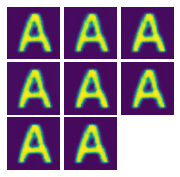

(8, 1, 64, 64)
[184/300][50/154]	Loss_D: 0.6937	Loss_G: 0.6932	D(x): 0.9996	D(G(z)): 0.5001 / 0.5000
label is ['A']


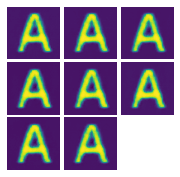

(8, 1, 64, 64)
[184/300][100/154]	Loss_D: 0.6973	Loss_G: 0.6900	D(x): 0.9998	D(G(z)): 0.5019 / 0.5016
label is ['A']


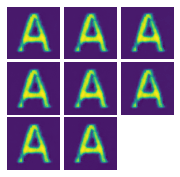

(8, 1, 64, 64)
[184/300][150/154]	Loss_D: 0.6938	Loss_G: 0.6931	D(x): 0.9999	D(G(z)): 0.5003 / 0.5000
label is ['A']


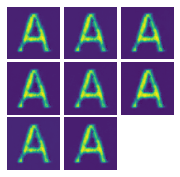

(8, 1, 64, 64)
[185/300][0/154]	Loss_D: 0.6930	Loss_G: 0.6941	D(x): 0.9997	D(G(z)): 0.4998 / 0.4995
label is ['A']


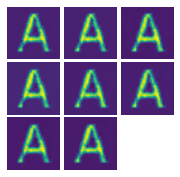

(8, 1, 64, 64)
[185/300][50/154]	Loss_D: 0.6953	Loss_G: 0.6910	D(x): 1.0000	D(G(z)): 0.5011 / 0.5011
label is ['A']


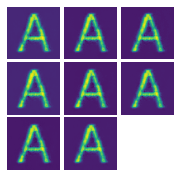

(8, 1, 64, 64)
[185/300][100/154]	Loss_D: 0.6938	Loss_G: 0.6937	D(x): 0.9996	D(G(z)): 0.5001 / 0.4997
label is ['A']


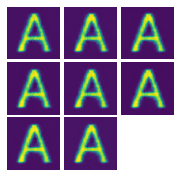

(8, 1, 64, 64)
[185/300][150/154]	Loss_D: 0.7003	Loss_G: 0.6870	D(x): 1.0000	D(G(z)): 0.5035 / 0.5031
label is ['A']


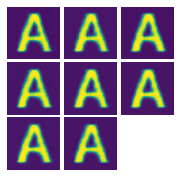

(8, 1, 64, 64)
[186/300][0/154]	Loss_D: 0.6973	Loss_G: 0.6900	D(x): 1.0000	D(G(z)): 0.5021 / 0.5016
label is ['A']


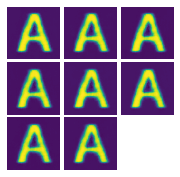

(8, 1, 64, 64)
[186/300][50/154]	Loss_D: 0.6976	Loss_G: 0.6896	D(x): 1.0000	D(G(z)): 0.5022 / 0.5018
label is ['A']


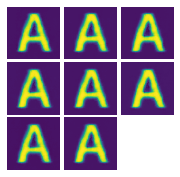

(8, 1, 64, 64)
[186/300][100/154]	Loss_D: 0.6955	Loss_G: 0.6919	D(x): 0.9999	D(G(z)): 0.5012 / 0.5006
label is ['A']


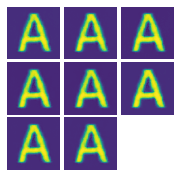

(8, 1, 64, 64)
[186/300][150/154]	Loss_D: 0.7171	Loss_G: 0.6706	D(x): 1.0000	D(G(z)): 0.5118 / 0.5114
label is ['A']


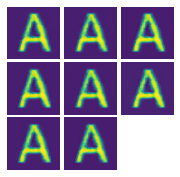

(8, 1, 64, 64)
[187/300][0/154]	Loss_D: 0.7143	Loss_G: 0.6732	D(x): 1.0000	D(G(z)): 0.5105 / 0.5101
label is ['A']


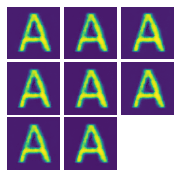

(8, 1, 64, 64)
[187/300][50/154]	Loss_D: 0.6944	Loss_G: 0.6922	D(x): 0.9999	D(G(z)): 0.5006 / 0.5005
label is ['A']


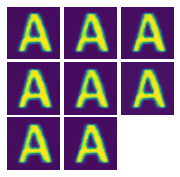

(8, 1, 64, 64)
[187/300][100/154]	Loss_D: 0.6927	Loss_G: 0.6947	D(x): 0.9997	D(G(z)): 0.4996 / 0.4992
label is ['A']


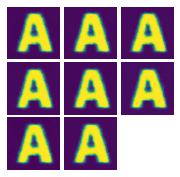

(8, 1, 64, 64)
[187/300][150/154]	Loss_D: 0.6995	Loss_G: 0.6875	D(x): 1.0000	D(G(z)): 0.5032 / 0.5029
label is ['A']


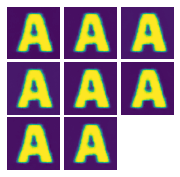

(8, 1, 64, 64)
[188/300][0/154]	Loss_D: 0.6973	Loss_G: 0.6896	D(x): 1.0000	D(G(z)): 0.5021 / 0.5018
label is ['A']


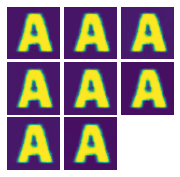

(8, 1, 64, 64)
[188/300][50/154]	Loss_D: 0.7065	Loss_G: 0.6851	D(x): 0.9947	D(G(z)): 0.5040 / 0.5041
label is ['A']


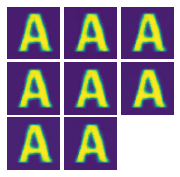

(8, 1, 64, 64)
[188/300][100/154]	Loss_D: 0.6978	Loss_G: 0.6891	D(x): 1.0000	D(G(z)): 0.5023 / 0.5020
label is ['A']


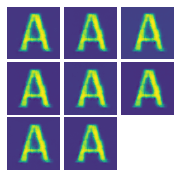

(8, 1, 64, 64)
[188/300][150/154]	Loss_D: 0.6947	Loss_G: 0.6922	D(x): 0.9999	D(G(z)): 0.5007 / 0.5004
label is ['A']


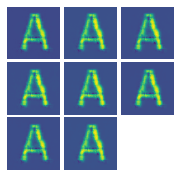

(8, 1, 64, 64)
[189/300][0/154]	Loss_D: 0.6941	Loss_G: 0.6929	D(x): 0.9998	D(G(z)): 0.5004 / 0.5001
label is ['A']


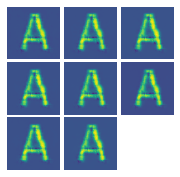

(8, 1, 64, 64)
[189/300][50/154]	Loss_D: 0.6920	Loss_G: 0.6928	D(x): 0.9999	D(G(z)): 0.4994 / 0.5002
label is ['A']


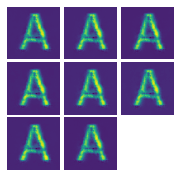

(8, 1, 64, 64)
[189/300][100/154]	Loss_D: 0.6963	Loss_G: 0.6906	D(x): 0.9998	D(G(z)): 0.5015 / 0.5013
label is ['A']


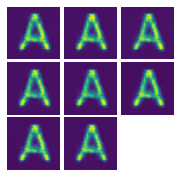

(8, 1, 64, 64)
[189/300][150/154]	Loss_D: 0.6949	Loss_G: 0.6919	D(x): 0.9998	D(G(z)): 0.5008 / 0.5006
label is ['A']


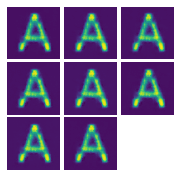

(8, 1, 64, 64)
[190/300][0/154]	Loss_D: 0.6970	Loss_G: 0.6902	D(x): 0.9992	D(G(z)): 0.5015 / 0.5015
label is ['A']


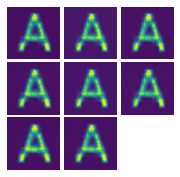

(8, 1, 64, 64)
[190/300][50/154]	Loss_D: 0.6950	Loss_G: 0.6919	D(x): 0.9999	D(G(z)): 0.5008 / 0.5006
label is ['A']


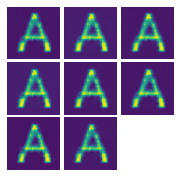

(8, 1, 64, 64)
[190/300][100/154]	Loss_D: 0.6981	Loss_G: 0.6889	D(x): 0.9999	D(G(z)): 0.5024 / 0.5021
label is ['A']


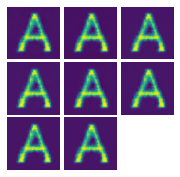

(8, 1, 64, 64)
[190/300][150/154]	Loss_D: 0.6950	Loss_G: 0.6973	D(x): 0.9940	D(G(z)): 0.4979 / 0.4979
label is ['A']


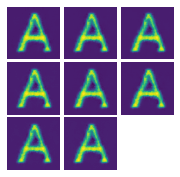

(8, 1, 64, 64)
[191/300][0/154]	Loss_D: 0.7025	Loss_G: 0.6946	D(x): 0.9884	D(G(z)): 0.4988 / 0.4993
label is ['A']


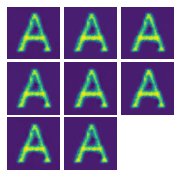

(8, 1, 64, 64)
[191/300][50/154]	Loss_D: 0.7036	Loss_G: 0.6834	D(x): 1.0000	D(G(z)): 0.5052 / 0.5049
label is ['A']


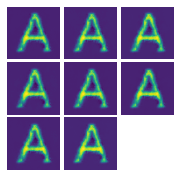

(8, 1, 64, 64)
[191/300][100/154]	Loss_D: 0.6967	Loss_G: 0.6903	D(x): 0.9999	D(G(z)): 0.5018 / 0.5014
label is ['A']


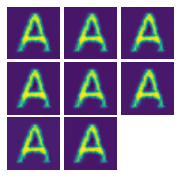

(8, 1, 64, 64)
[191/300][150/154]	Loss_D: 0.6939	Loss_G: 0.6935	D(x): 0.9998	D(G(z)): 0.5002 / 0.4998
label is ['A']


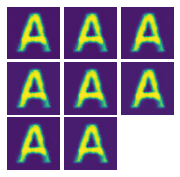

(8, 1, 64, 64)
[192/300][0/154]	Loss_D: 0.6930	Loss_G: 0.6944	D(x): 0.9995	D(G(z)): 0.4997 / 0.4994
label is ['A']


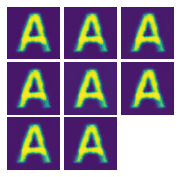

(8, 1, 64, 64)
[192/300][50/154]	Loss_D: 0.6919	Loss_G: 0.6971	D(x): 0.9979	D(G(z)): 0.4983 / 0.4980
label is ['A']


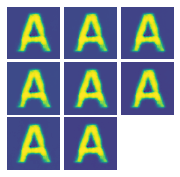

(8, 1, 64, 64)
[192/300][100/154]	Loss_D: 0.6880	Loss_G: 0.6997	D(x): 0.9996	D(G(z)): 0.4972 / 0.4967
label is ['A']


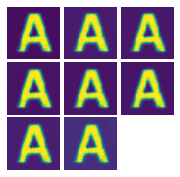

(8, 1, 64, 64)
[192/300][150/154]	Loss_D: 0.6896	Loss_G: 0.6978	D(x): 1.0000	D(G(z)): 0.4982 / 0.4977
label is ['A']


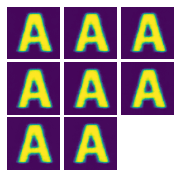

(8, 1, 64, 64)
[193/300][0/154]	Loss_D: 0.6979	Loss_G: 0.6887	D(x): 1.0000	D(G(z)): 0.5024 / 0.5022
label is ['A']


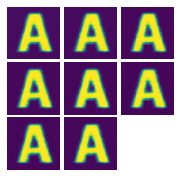

(8, 1, 64, 64)
[193/300][50/154]	Loss_D: 0.7389	Loss_G: 0.6495	D(x): 1.0000	D(G(z)): 0.5224 / 0.5223
label is ['A']


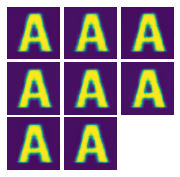

(8, 1, 64, 64)
[193/300][100/154]	Loss_D: 0.7136	Loss_G: 0.6736	D(x): 1.0000	D(G(z)): 0.5101 / 0.5099
label is ['A']


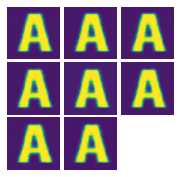

(8, 1, 64, 64)
[193/300][150/154]	Loss_D: 0.6973	Loss_G: 0.6895	D(x): 1.0000	D(G(z)): 0.5021 / 0.5018
label is ['A']


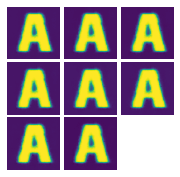

(8, 1, 64, 64)
[194/300][0/154]	Loss_D: 0.6968	Loss_G: 0.6900	D(x): 0.9999	D(G(z)): 0.5018 / 0.5016
label is ['A']


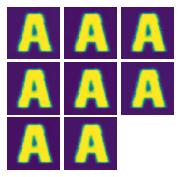

(8, 1, 64, 64)
[194/300][50/154]	Loss_D: 0.7084	Loss_G: 0.6784	D(x): 1.0000	D(G(z)): 0.5076 / 0.5074
label is ['A']


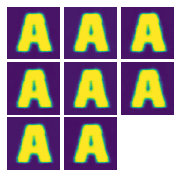

(8, 1, 64, 64)
[194/300][100/154]	Loss_D: 0.6872	Loss_G: 0.6995	D(x): 1.0000	D(G(z)): 0.4970 / 0.4968
label is ['A']


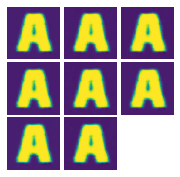

(8, 1, 64, 64)
[194/300][150/154]	Loss_D: 0.7103	Loss_G: 0.6769	D(x): 1.0000	D(G(z)): 0.5085 / 0.5082
label is ['A']


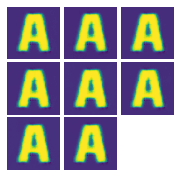

(8, 1, 64, 64)
[195/300][0/154]	Loss_D: 0.7093	Loss_G: 0.6778	D(x): 1.0000	D(G(z)): 0.5080 / 0.5077
label is ['A']


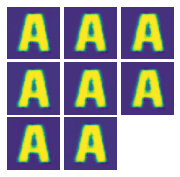

(8, 1, 64, 64)
[195/300][50/154]	Loss_D: 0.7089	Loss_G: 0.6836	D(x): 0.9939	D(G(z)): 0.5048 / 0.5048
label is ['A']


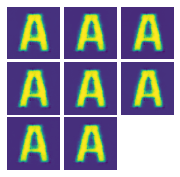

(8, 1, 64, 64)
[195/300][100/154]	Loss_D: 0.7012	Loss_G: 0.6858	D(x): 0.9999	D(G(z)): 0.5039 / 0.5037
label is ['A']


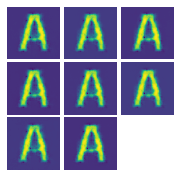

(8, 1, 64, 64)
[195/300][150/154]	Loss_D: 0.6947	Loss_G: 0.6929	D(x): 0.9998	D(G(z)): 0.5007 / 0.5001
label is ['A']


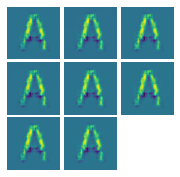

(8, 1, 64, 64)
[196/300][0/154]	Loss_D: 0.6925	Loss_G: 0.6958	D(x): 0.9990	D(G(z)): 0.4992 / 0.4987
label is ['A']


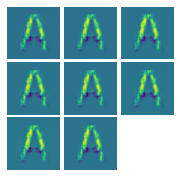

(8, 1, 64, 64)
[196/300][50/154]	Loss_D: 0.6895	Loss_G: 0.6976	D(x): 0.9995	D(G(z)): 0.4979 / 0.4978
label is ['A']


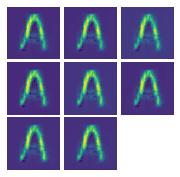

(8, 1, 64, 64)
[196/300][100/154]	Loss_D: 0.6889	Loss_G: 0.6986	D(x): 0.9992	D(G(z)): 0.4974 / 0.4973
label is ['A']


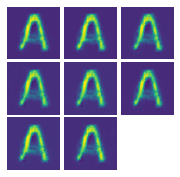

(8, 1, 64, 64)
[196/300][150/154]	Loss_D: 0.6910	Loss_G: 0.6959	D(x): 0.9997	D(G(z)): 0.4988 / 0.4986
label is ['A']


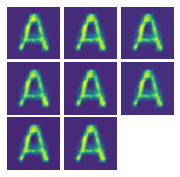

(8, 1, 64, 64)
[197/300][0/154]	Loss_D: 0.6903	Loss_G: 0.6968	D(x): 0.9997	D(G(z)): 0.4984 / 0.4982
label is ['A']


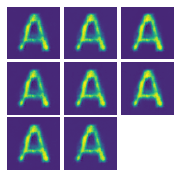

(8, 1, 64, 64)
[197/300][50/154]	Loss_D: 0.6918	Loss_G: 0.6945	D(x): 0.9997	D(G(z)): 0.4992 / 0.4993
label is ['A']


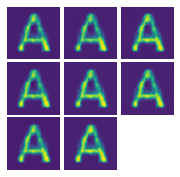

(8, 1, 64, 64)
[197/300][100/154]	Loss_D: 0.6972	Loss_G: 0.6901	D(x): 0.9996	D(G(z)): 0.5018 / 0.5015
label is ['A']


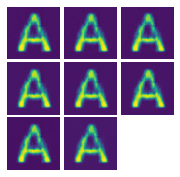

(8, 1, 64, 64)
[197/300][150/154]	Loss_D: 0.6947	Loss_G: 0.6923	D(x): 1.0000	D(G(z)): 0.5007 / 0.5004
label is ['A']


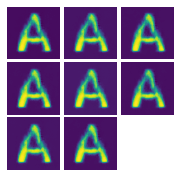

(8, 1, 64, 64)
[198/300][0/154]	Loss_D: 0.6930	Loss_G: 0.6940	D(x): 1.0000	D(G(z)): 0.4999 / 0.4996
label is ['A']


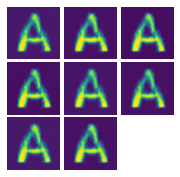

(8, 1, 64, 64)
[198/300][50/154]	Loss_D: 0.6916	Loss_G: 0.6955	D(x): 0.9998	D(G(z)): 0.4992 / 0.4988
label is ['A']


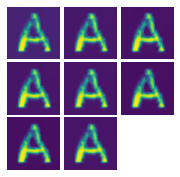

(8, 1, 64, 64)
[198/300][100/154]	Loss_D: 0.6892	Loss_G: 0.6989	D(x): 0.9988	D(G(z)): 0.4974 / 0.4972
label is ['A']


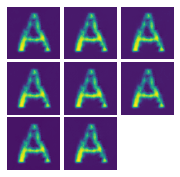

(8, 1, 64, 64)
[198/300][150/154]	Loss_D: 0.6970	Loss_G: 0.6899	D(x): 0.9999	D(G(z)): 0.5019 / 0.5016
label is ['A']


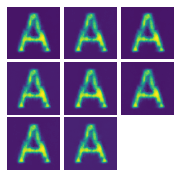

(8, 1, 64, 64)
[199/300][0/154]	Loss_D: 0.6960	Loss_G: 0.6909	D(x): 1.0000	D(G(z)): 0.5014 / 0.5011
label is ['A']


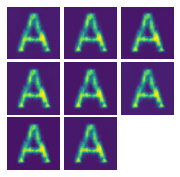

(8, 1, 64, 64)
[199/300][50/154]	Loss_D: 0.6981	Loss_G: 0.6873	D(x): 0.9999	D(G(z)): 0.5024 / 0.5029
label is ['A']


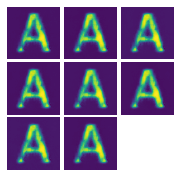

(8, 1, 64, 64)
[199/300][100/154]	Loss_D: 0.7045	Loss_G: 0.6828	D(x): 0.9998	D(G(z)): 0.5056 / 0.5052
label is ['A']


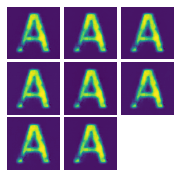

(8, 1, 64, 64)
[199/300][150/154]	Loss_D: 0.6984	Loss_G: 0.6887	D(x): 1.0000	D(G(z)): 0.5026 / 0.5022
label is ['A']


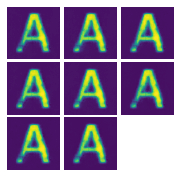

(8, 1, 64, 64)
[200/300][0/154]	Loss_D: 0.6956	Loss_G: 0.6914	D(x): 0.9999	D(G(z)): 0.5012 / 0.5009
label is ['A']


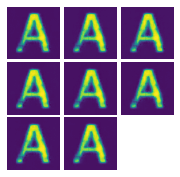

(8, 1, 64, 64)
[200/300][50/154]	Loss_D: 0.6924	Loss_G: 0.6949	D(x): 0.9996	D(G(z)): 0.4994 / 0.4991
label is ['A']


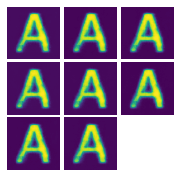

(8, 1, 64, 64)
[200/300][100/154]	Loss_D: 0.6919	Loss_G: 0.6955	D(x): 0.9998	D(G(z)): 0.4993 / 0.4988
label is ['A']


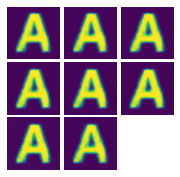

(8, 1, 64, 64)
[200/300][150/154]	Loss_D: 0.6868	Loss_G: 0.7006	D(x): 1.0000	D(G(z)): 0.4968 / 0.4963
label is ['A']


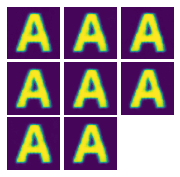

(8, 1, 64, 64)
[201/300][0/154]	Loss_D: 0.6840	Loss_G: 0.7039	D(x): 0.9994	D(G(z)): 0.4951 / 0.4947
label is ['A']


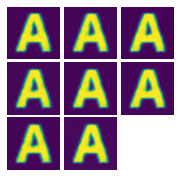

(8, 1, 64, 64)
[201/300][50/154]	Loss_D: 0.7010	Loss_G: 0.6860	D(x): 1.0000	D(G(z)): 0.5039 / 0.5036
label is ['A']


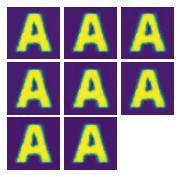

(8, 1, 64, 64)
[201/300][100/154]	Loss_D: 0.7340	Loss_G: 0.6548	D(x): 1.0000	D(G(z)): 0.5200 / 0.5195
label is ['A']


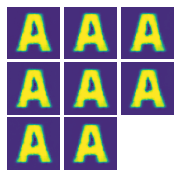

(8, 1, 64, 64)
[201/300][150/154]	Loss_D: 0.7024	Loss_G: 0.6846	D(x): 1.0000	D(G(z)): 0.5046 / 0.5043
label is ['A']


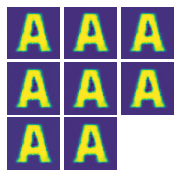

(8, 1, 64, 64)
[202/300][0/154]	Loss_D: 0.7010	Loss_G: 0.6860	D(x): 1.0000	D(G(z)): 0.5039 / 0.5036
label is ['A']


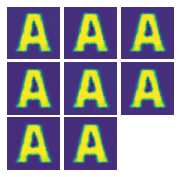

(8, 1, 64, 64)
[202/300][50/154]	Loss_D: 0.7019	Loss_G: 0.6853	D(x): 0.9998	D(G(z)): 0.5042 / 0.5040
label is ['A']


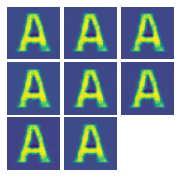

(8, 1, 64, 64)
[202/300][100/154]	Loss_D: 0.6942	Loss_G: 0.6928	D(x): 0.9999	D(G(z)): 0.5005 / 0.5002
label is ['A']


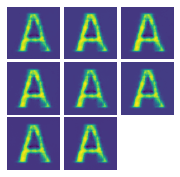

(8, 1, 64, 64)
[202/300][150/154]	Loss_D: 0.6957	Loss_G: 0.6911	D(x): 1.0000	D(G(z)): 0.5013 / 0.5010
label is ['A']


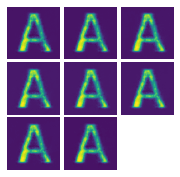

(8, 1, 64, 64)
[203/300][0/154]	Loss_D: 0.6946	Loss_G: 0.6924	D(x): 0.9999	D(G(z)): 0.5007 / 0.5004
label is ['A']


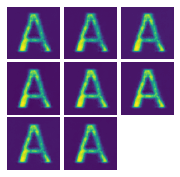

(8, 1, 64, 64)
[203/300][50/154]	Loss_D: 0.6941	Loss_G: 0.6924	D(x): 0.9996	D(G(z)): 0.5003 / 0.5004
label is ['A']


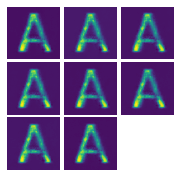

(8, 1, 64, 64)
[203/300][100/154]	Loss_D: 0.6924	Loss_G: 0.6949	D(x): 0.9995	D(G(z)): 0.4994 / 0.4991
label is ['A']


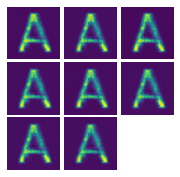

(8, 1, 64, 64)
[203/300][150/154]	Loss_D: 0.6938	Loss_G: 0.6929	D(x): 1.0000	D(G(z)): 0.5003 / 0.5001
label is ['A']


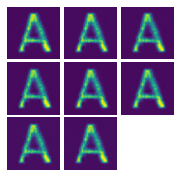

(8, 1, 64, 64)
[204/300][0/154]	Loss_D: 0.6926	Loss_G: 0.6942	D(x): 0.9999	D(G(z)): 0.4997 / 0.4995
label is ['A']


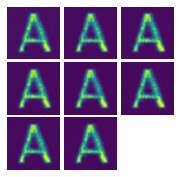

(8, 1, 64, 64)
[204/300][50/154]	Loss_D: 0.6970	Loss_G: 0.6865	D(x): 1.0000	D(G(z)): 0.5019 / 0.5033
label is ['A']


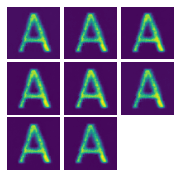

(8, 1, 64, 64)
[204/300][100/154]	Loss_D: 0.7147	Loss_G: 0.6725	D(x): 1.0000	D(G(z)): 0.5107 / 0.5104
label is ['A']


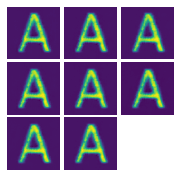

(8, 1, 64, 64)
[204/300][150/154]	Loss_D: 0.6968	Loss_G: 0.6900	D(x): 1.0000	D(G(z)): 0.5018 / 0.5016
label is ['A']


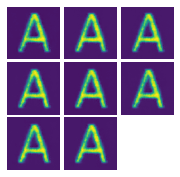

(8, 1, 64, 64)
[205/300][0/154]	Loss_D: 0.6970	Loss_G: 0.6897	D(x): 0.9999	D(G(z)): 0.5019 / 0.5017
label is ['A']


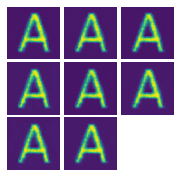

(8, 1, 64, 64)
[205/300][50/154]	Loss_D: 0.6990	Loss_G: 0.6878	D(x): 1.0000	D(G(z)): 0.5029 / 0.5027
label is ['A']


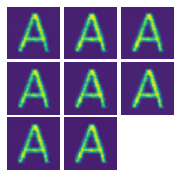

(8, 1, 64, 64)
[205/300][100/154]	Loss_D: 0.6968	Loss_G: 0.6902	D(x): 0.9998	D(G(z)): 0.5017 / 0.5015
label is ['A']


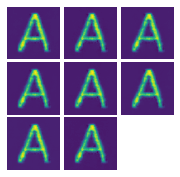

(8, 1, 64, 64)
[205/300][150/154]	Loss_D: 0.6957	Loss_G: 0.6917	D(x): 0.9991	D(G(z)): 0.5008 / 0.5007
label is ['A']


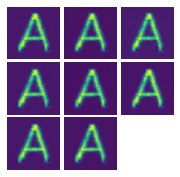

(8, 1, 64, 64)
[206/300][0/154]	Loss_D: 0.6945	Loss_G: 0.6926	D(x): 0.9996	D(G(z)): 0.5005 / 0.5003
label is ['A']


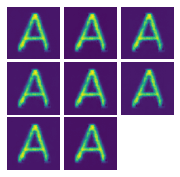

(8, 1, 64, 64)
[206/300][50/154]	Loss_D: 0.6915	Loss_G: 0.6951	D(x): 1.0000	D(G(z)): 0.4992 / 0.4990
label is ['A']


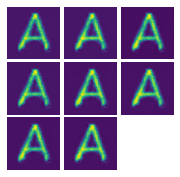

(8, 1, 64, 64)
[206/300][100/154]	Loss_D: 0.6918	Loss_G: 0.6960	D(x): 0.9988	D(G(z)): 0.4987 / 0.4986
label is ['A']


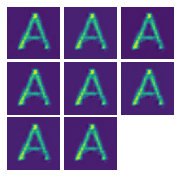

(8, 1, 64, 64)
[206/300][150/154]	Loss_D: 0.6962	Loss_G: 0.6967	D(x): 0.9933	D(G(z)): 0.4981 / 0.4982
label is ['A']


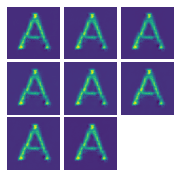

(8, 1, 64, 64)
[207/300][0/154]	Loss_D: 0.6909	Loss_G: 0.6969	D(x): 0.9987	D(G(z)): 0.4982 / 0.4981
label is ['A']


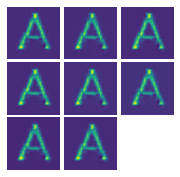

(8, 1, 64, 64)
[207/300][50/154]	Loss_D: 0.6885	Loss_G: 0.6981	D(x): 1.0000	D(G(z)): 0.4977 / 0.4975
label is ['A']


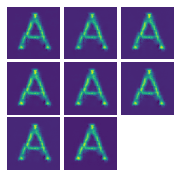

(8, 1, 64, 64)
[207/300][100/154]	Loss_D: 0.6972	Loss_G: 0.6896	D(x): 0.9999	D(G(z)): 0.5020 / 0.5018
label is ['A']


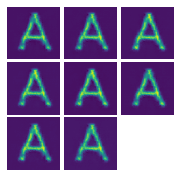

(8, 1, 64, 64)
[207/300][150/154]	Loss_D: 0.6982	Loss_G: 0.6966	D(x): 0.9913	D(G(z)): 0.4981 / 0.4983
label is ['A']


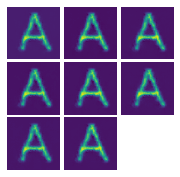

(8, 1, 64, 64)
[208/300][0/154]	Loss_D: 0.6930	Loss_G: 0.6938	D(x): 0.9990	D(G(z)): 0.4994 / 0.4997
label is ['A']


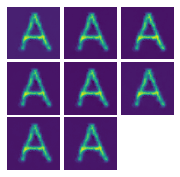

(8, 1, 64, 64)
[208/300][50/154]	Loss_D: 0.6911	Loss_G: 0.6955	D(x): 1.0000	D(G(z)): 0.4990 / 0.4988
label is ['A']


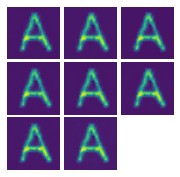

(8, 1, 64, 64)
[208/300][100/154]	Loss_D: 0.7401	Loss_G: 0.6487	D(x): 1.0000	D(G(z)): 0.5230 / 0.5227
label is ['A']


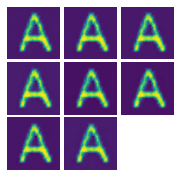

(8, 1, 64, 64)
[208/300][150/154]	Loss_D: 0.7301	Loss_G: 0.6579	D(x): 1.0000	D(G(z)): 0.5181 / 0.5179
label is ['A']


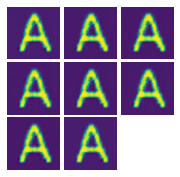

(8, 1, 64, 64)
[209/300][0/154]	Loss_D: 0.7288	Loss_G: 0.6591	D(x): 1.0000	D(G(z)): 0.5175 / 0.5173
label is ['A']


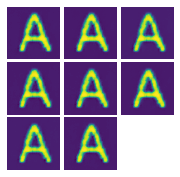

(8, 1, 64, 64)
[209/300][50/154]	Loss_D: 0.7164	Loss_G: 0.6708	D(x): 1.0000	D(G(z)): 0.5115 / 0.5113
label is ['A']


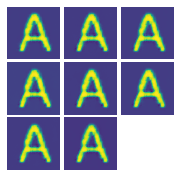

(8, 1, 64, 64)
[209/300][100/154]	Loss_D: 0.7049	Loss_G: 0.6820	D(x): 0.9998	D(G(z)): 0.5058 / 0.5056
label is ['A']


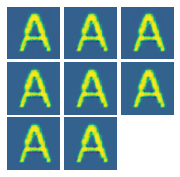

(8, 1, 64, 64)
[209/300][150/154]	Loss_D: 0.6998	Loss_G: 0.6877	D(x): 0.9991	D(G(z)): 0.5029 / 0.5027
label is ['A']


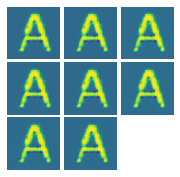

(8, 1, 64, 64)
[210/300][0/154]	Loss_D: 0.6994	Loss_G: 0.6882	D(x): 0.9989	D(G(z)): 0.5026 / 0.5025
label is ['A']


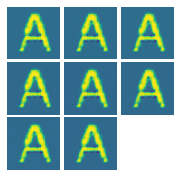

(8, 1, 64, 64)
[210/300][50/154]	Loss_D: 0.6964	Loss_G: 0.6902	D(x): 0.9999	D(G(z)): 0.5016 / 0.5015
label is ['A']


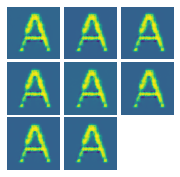

(8, 1, 64, 64)
[210/300][100/154]	Loss_D: 0.6940	Loss_G: 0.6929	D(x): 0.9997	D(G(z)): 0.5003 / 0.5001
label is ['A']


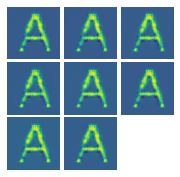

(8, 1, 64, 64)
[210/300][150/154]	Loss_D: 0.6983	Loss_G: 0.6900	D(x): 0.9985	D(G(z)): 0.5018 / 0.5016
label is ['A']


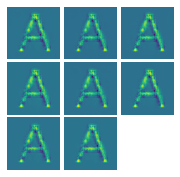

(8, 1, 64, 64)
[211/300][0/154]	Loss_D: 0.6989	Loss_G: 0.6904	D(x): 0.9976	D(G(z)): 0.5017 / 0.5014
label is ['A']


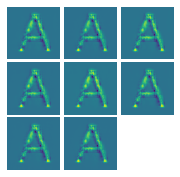

(8, 1, 64, 64)
[211/300][50/154]	Loss_D: 0.6850	Loss_G: 0.7017	D(x): 1.0000	D(G(z)): 0.4959 / 0.4957
label is ['A']


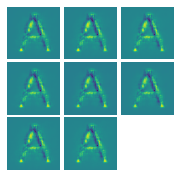

(8, 1, 64, 64)
[211/300][100/154]	Loss_D: 0.6915	Loss_G: 0.6949	D(x): 1.0000	D(G(z)): 0.4991 / 0.4991
label is ['A']


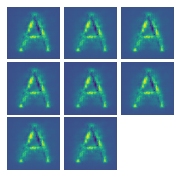

(8, 1, 64, 64)
[211/300][150/154]	Loss_D: 0.6938	Loss_G: 0.6938	D(x): 0.9987	D(G(z)): 0.4997 / 0.4997
label is ['A']


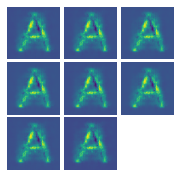

(8, 1, 64, 64)
[212/300][0/154]	Loss_D: 0.6937	Loss_G: 0.6937	D(x): 0.9989	D(G(z)): 0.4997 / 0.4997
label is ['A']


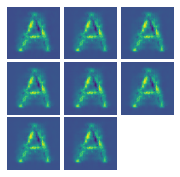

(8, 1, 64, 64)
[212/300][50/154]	Loss_D: 0.6937	Loss_G: 0.6927	D(x): 1.0000	D(G(z)): 0.5003 / 0.5002
label is ['A']


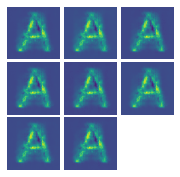

(8, 1, 64, 64)
[212/300][100/154]	Loss_D: 0.6932	Loss_G: 0.6932	D(x): 0.9999	D(G(z)): 0.5000 / 0.5000
label is ['A']


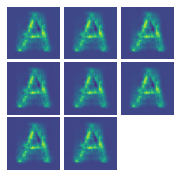

(8, 1, 64, 64)
[212/300][150/154]	Loss_D: 0.6940	Loss_G: 0.6946	D(x): 0.9978	D(G(z)): 0.4993 / 0.4993
label is ['A']


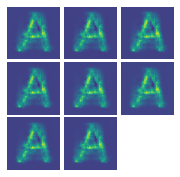

(8, 1, 64, 64)
[213/300][0/154]	Loss_D: 0.6932	Loss_G: 0.6946	D(x): 0.9985	D(G(z)): 0.4993 / 0.4993
label is ['A']


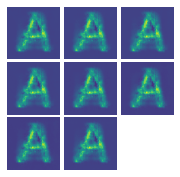

(8, 1, 64, 64)
[213/300][50/154]	Loss_D: 0.6923	Loss_G: 0.6945	D(x): 0.9996	D(G(z)): 0.4994 / 0.4993
label is ['A']


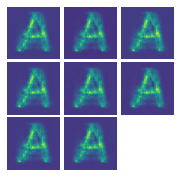

(8, 1, 64, 64)
[213/300][100/154]	Loss_D: 0.6912	Loss_G: 0.6953	D(x): 0.9998	D(G(z)): 0.4989 / 0.4989
label is ['A']


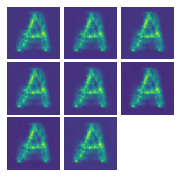

(8, 1, 64, 64)
[213/300][150/154]	Loss_D: 0.6927	Loss_G: 0.6949	D(x): 0.9987	D(G(z)): 0.4991 / 0.4991
label is ['A']


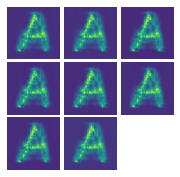

(8, 1, 64, 64)
[214/300][0/154]	Loss_D: 0.6918	Loss_G: 0.6950	D(x): 0.9995	D(G(z)): 0.4991 / 0.4991
label is ['A']


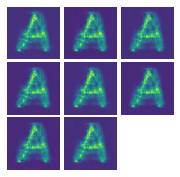

(8, 1, 64, 64)
[214/300][50/154]	Loss_D: 0.6922	Loss_G: 0.6952	D(x): 0.9989	D(G(z)): 0.4990 / 0.4990
label is ['A']


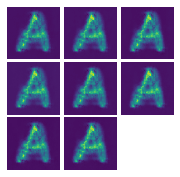

(8, 1, 64, 64)
[214/300][100/154]	Loss_D: 0.6911	Loss_G: 0.6954	D(x): 0.9998	D(G(z)): 0.4989 / 0.4989
label is ['A']


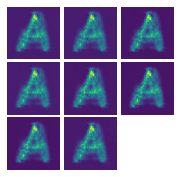

(8, 1, 64, 64)
[214/300][150/154]	Loss_D: 0.6927	Loss_G: 0.6943	D(x): 0.9994	D(G(z)): 0.4994 / 0.4994
label is ['A']


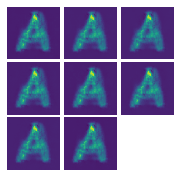

(8, 1, 64, 64)
[215/300][0/154]	Loss_D: 0.6924	Loss_G: 0.6942	D(x): 0.9997	D(G(z)): 0.4995 / 0.4995
label is ['A']


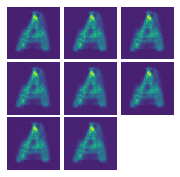

(8, 1, 64, 64)
[215/300][50/154]	Loss_D: 0.6929	Loss_G: 0.6949	D(x): 0.9985	D(G(z)): 0.4991 / 0.4991
label is ['A']


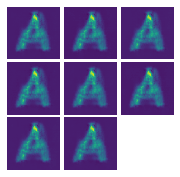

(8, 1, 64, 64)
[215/300][100/154]	Loss_D: 0.6922	Loss_G: 0.6946	D(x): 0.9995	D(G(z)): 0.4993 / 0.4993
label is ['A']


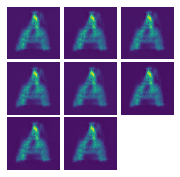

(8, 1, 64, 64)
[215/300][150/154]	Loss_D: 0.6938	Loss_G: 0.6932	D(x): 0.9993	D(G(z)): 0.5000 / 0.4999
label is ['A']


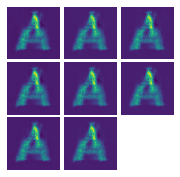

(8, 1, 64, 64)
[216/300][0/154]	Loss_D: 0.6938	Loss_G: 0.6929	D(x): 0.9996	D(G(z)): 0.5001 / 0.5001
label is ['A']


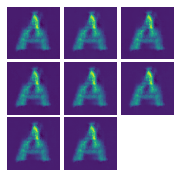

(8, 1, 64, 64)
[216/300][50/154]	Loss_D: 0.6935	Loss_G: 0.6937	D(x): 0.9992	D(G(z)): 0.4997 / 0.4997
label is ['A']


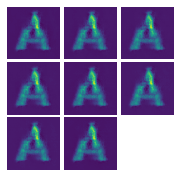

(8, 1, 64, 64)
[216/300][100/154]	Loss_D: 0.6928	Loss_G: 0.6940	D(x): 0.9995	D(G(z)): 0.4996 / 0.4996
label is ['A']


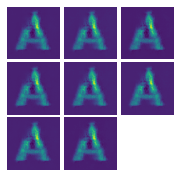

(8, 1, 64, 64)
[216/300][150/154]	Loss_D: 0.6932	Loss_G: 0.6940	D(x): 0.9992	D(G(z)): 0.4996 / 0.4996
label is ['A']


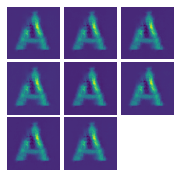

(8, 1, 64, 64)
[217/300][0/154]	Loss_D: 0.6929	Loss_G: 0.6939	D(x): 0.9994	D(G(z)): 0.4996 / 0.4996
label is ['A']


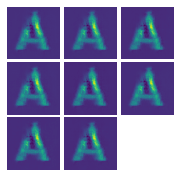

(8, 1, 64, 64)
[217/300][50/154]	Loss_D: 0.6952	Loss_G: 0.6912	D(x): 1.0000	D(G(z)): 0.5010 / 0.5010
label is ['A']


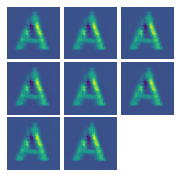

(8, 1, 64, 64)
[217/300][100/154]	Loss_D: 0.6912	Loss_G: 0.6954	D(x): 0.9999	D(G(z)): 0.4989 / 0.4989
label is ['A']


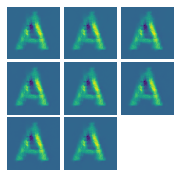

(8, 1, 64, 64)
[217/300][150/154]	Loss_D: 0.6900	Loss_G: 0.6966	D(x): 0.9998	D(G(z)): 0.4983 / 0.4983
label is ['A']


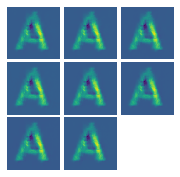

(8, 1, 64, 64)
[218/300][0/154]	Loss_D: 0.6919	Loss_G: 0.6965	D(x): 0.9979	D(G(z)): 0.4983 / 0.4983
label is ['A']


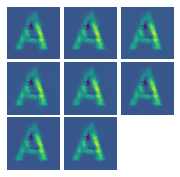

(8, 1, 64, 64)
[218/300][50/154]	Loss_D: 0.6919	Loss_G: 0.6952	D(x): 0.9993	D(G(z)): 0.4990 / 0.4990
label is ['A']


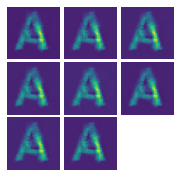

(8, 1, 64, 64)
[218/300][100/154]	Loss_D: 0.6935	Loss_G: 0.6930	D(x): 1.0000	D(G(z)): 0.5002 / 0.5001
label is ['A']


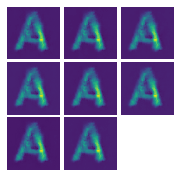

(8, 1, 64, 64)
[218/300][150/154]	Loss_D: 0.6904	Loss_G: 0.6961	D(x): 1.0000	D(G(z)): 0.4986 / 0.4985
label is ['A']


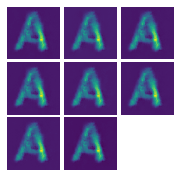

(8, 1, 64, 64)
[219/300][0/154]	Loss_D: 0.6909	Loss_G: 0.6966	D(x): 0.9990	D(G(z)): 0.4983 / 0.4983
label is ['A']


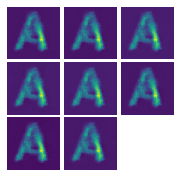

(8, 1, 64, 64)
[219/300][50/154]	Loss_D: 0.6955	Loss_G: 0.6954	D(x): 0.9951	D(G(z)): 0.4987 / 0.4989
label is ['A']


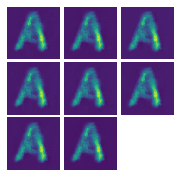

(8, 1, 64, 64)
[219/300][100/154]	Loss_D: 0.6908	Loss_G: 0.6958	D(x): 0.9998	D(G(z)): 0.4987 / 0.4987
label is ['A']


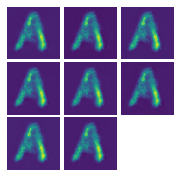

(8, 1, 64, 64)
[219/300][150/154]	Loss_D: 0.6899	Loss_G: 0.6964	D(x): 1.0000	D(G(z)): 0.4984 / 0.4984
label is ['A']


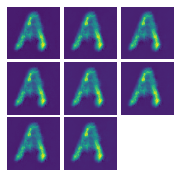

(8, 1, 64, 64)
[220/300][0/154]	Loss_D: 0.6933	Loss_G: 0.6967	D(x): 0.9960	D(G(z)): 0.4981 / 0.4982
label is ['A']


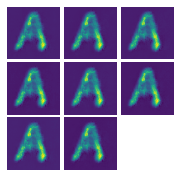

(8, 1, 64, 64)
[220/300][50/154]	Loss_D: 0.6935	Loss_G: 0.6930	D(x): 1.0000	D(G(z)): 0.5002 / 0.5001
label is ['A']


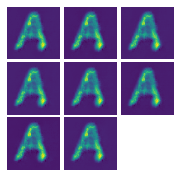

(8, 1, 64, 64)
[220/300][100/154]	Loss_D: 0.6904	Loss_G: 0.6961	D(x): 0.9998	D(G(z)): 0.4985 / 0.4985
label is ['A']


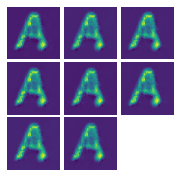

(8, 1, 64, 64)
[220/300][150/154]	Loss_D: 0.6901	Loss_G: 0.6963	D(x): 1.0000	D(G(z)): 0.4985 / 0.4984
label is ['A']


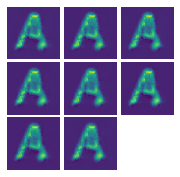

(8, 1, 64, 64)
[221/300][0/154]	Loss_D: 0.6997	Loss_G: 0.6959	D(x): 0.9898	D(G(z)): 0.4981 / 0.4986
label is ['A']


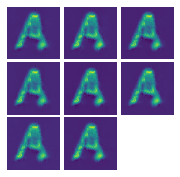

(8, 1, 64, 64)
[221/300][50/154]	Loss_D: 0.6910	Loss_G: 0.6959	D(x): 0.9996	D(G(z)): 0.4987 / 0.4986
label is ['A']


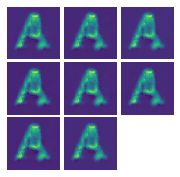

(8, 1, 64, 64)
[221/300][100/154]	Loss_D: 0.6902	Loss_G: 0.6966	D(x): 0.9996	D(G(z)): 0.4983 / 0.4983
label is ['A']


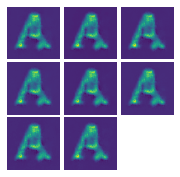

(8, 1, 64, 64)
[221/300][150/154]	Loss_D: 0.6923	Loss_G: 0.6943	D(x): 1.0000	D(G(z)): 0.4996 / 0.4994
label is ['A']


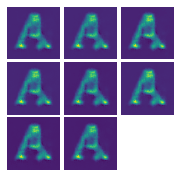

(8, 1, 64, 64)
[222/300][0/154]	Loss_D: 0.6919	Loss_G: 0.6953	D(x): 0.9993	D(G(z)): 0.4990 / 0.4989
label is ['A']


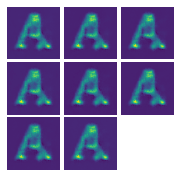

(8, 1, 64, 64)
[222/300][50/154]	Loss_D: 0.6889	Loss_G: 0.6977	D(x): 1.0000	D(G(z)): 0.4978 / 0.4977
label is ['A']


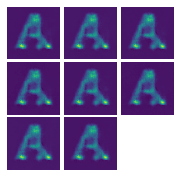

(8, 1, 64, 64)
[222/300][100/154]	Loss_D: 0.6936	Loss_G: 0.6930	D(x): 1.0000	D(G(z)): 0.5002 / 0.5001
label is ['A']


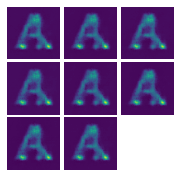

(8, 1, 64, 64)
[222/300][150/154]	Loss_D: 0.6904	Loss_G: 0.6962	D(x): 0.9999	D(G(z)): 0.4986 / 0.4985
label is ['A']


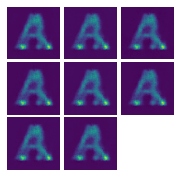

(8, 1, 64, 64)
[223/300][0/154]	Loss_D: 0.6899	Loss_G: 0.6969	D(x): 0.9998	D(G(z)): 0.4982 / 0.4981
label is ['A']


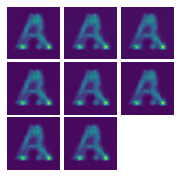

(8, 1, 64, 64)
[223/300][50/154]	Loss_D: 0.7248	Loss_G: 0.6628	D(x): 1.0000	D(G(z)): 0.5156 / 0.5154
label is ['A']


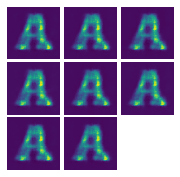

(8, 1, 64, 64)
[223/300][100/154]	Loss_D: 0.7271	Loss_G: 0.6611	D(x): 1.0000	D(G(z)): 0.5167 / 0.5163
label is ['A']


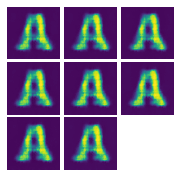

(8, 1, 64, 64)
[223/300][150/154]	Loss_D: 0.7006	Loss_G: 0.6865	D(x): 0.9999	D(G(z)): 0.5037 / 0.5033
label is ['A']


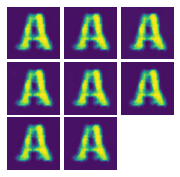

(8, 1, 64, 64)
[224/300][0/154]	Loss_D: 0.6981	Loss_G: 0.6889	D(x): 1.0000	D(G(z)): 0.5025 / 0.5021
label is ['A']


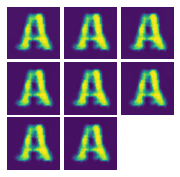

(8, 1, 64, 64)
[224/300][50/154]	Loss_D: 0.6931	Loss_G: 0.6943	D(x): 0.9994	D(G(z)): 0.4997 / 0.4994
label is ['A']


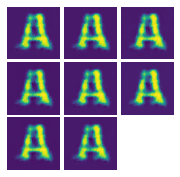

(8, 1, 64, 64)
[224/300][100/154]	Loss_D: 0.7547	Loss_G: 0.6940	D(x): 0.9411	D(G(z)): 0.4961 / 0.4996
label is ['A']


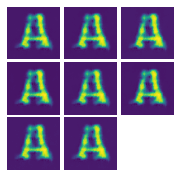

(8, 1, 64, 64)
[224/300][150/154]	Loss_D: 0.6860	Loss_G: 0.7009	D(x): 1.0000	D(G(z)): 0.4964 / 0.4962
label is ['A']


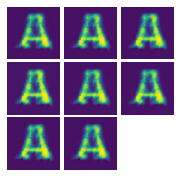

(8, 1, 64, 64)
[225/300][0/154]	Loss_D: 0.6848	Loss_G: 0.7021	D(x): 1.0000	D(G(z)): 0.4958 / 0.4955
label is ['A']


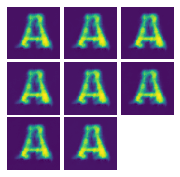

(8, 1, 64, 64)
[225/300][50/154]	Loss_D: 0.6861	Loss_G: 0.7009	D(x): 0.9998	D(G(z)): 0.4964 / 0.4961
label is ['A']


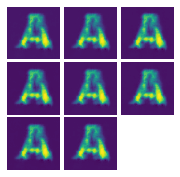

(8, 1, 64, 64)
[225/300][100/154]	Loss_D: 0.6915	Loss_G: 0.6955	D(x): 0.9999	D(G(z)): 0.4991 / 0.4988
label is ['A']


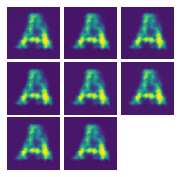

(8, 1, 64, 64)
[225/300][150/154]	Loss_D: 0.6835	Loss_G: 0.7037	D(x): 0.9998	D(G(z)): 0.4951 / 0.4948
label is ['A']


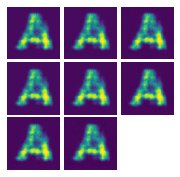

(8, 1, 64, 64)
[226/300][0/154]	Loss_D: 0.6831	Loss_G: 0.7038	D(x): 1.0000	D(G(z)): 0.4949 / 0.4947
label is ['A']


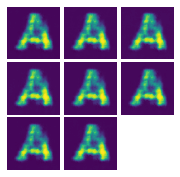

(8, 1, 64, 64)
[226/300][50/154]	Loss_D: 0.6850	Loss_G: 0.7025	D(x): 0.9986	D(G(z)): 0.4952 / 0.4953
label is ['A']


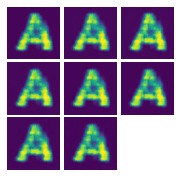

(8, 1, 64, 64)
[226/300][100/154]	Loss_D: 0.7090	Loss_G: 0.6784	D(x): 1.0000	D(G(z)): 0.5079 / 0.5074
label is ['A']


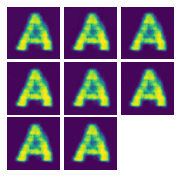

(8, 1, 64, 64)
[226/300][150/154]	Loss_D: 0.6807	Loss_G: 0.7063	D(x): 1.0000	D(G(z)): 0.4937 / 0.4934
label is ['A']


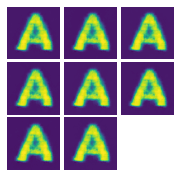

(8, 1, 64, 64)
[227/300][0/154]	Loss_D: 0.6781	Loss_G: 0.7094	D(x): 1.0000	D(G(z)): 0.4924 / 0.4920
label is ['A']


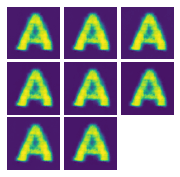

(8, 1, 64, 64)
[227/300][50/154]	Loss_D: 0.6975	Loss_G: 0.6895	D(x): 1.0000	D(G(z)): 0.5022 / 0.5018
label is ['A']


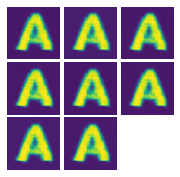

(8, 1, 64, 64)
[227/300][100/154]	Loss_D: 0.6929	Loss_G: 0.6941	D(x): 1.0000	D(G(z)): 0.4998 / 0.4995
label is ['A']


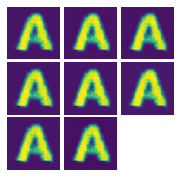

(8, 1, 64, 64)
[227/300][150/154]	Loss_D: 0.7055	Loss_G: 0.6816	D(x): 1.0000	D(G(z)): 0.5061 / 0.5058
label is ['A']


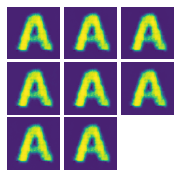

(8, 1, 64, 64)
[228/300][0/154]	Loss_D: 0.7038	Loss_G: 0.6832	D(x): 1.0000	D(G(z)): 0.5053 / 0.5050
label is ['A']


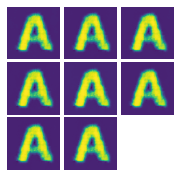

(8, 1, 64, 64)
[228/300][50/154]	Loss_D: 0.6989	Loss_G: 0.6881	D(x): 0.9996	D(G(z)): 0.5027 / 0.5025
label is ['A']


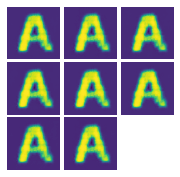

(8, 1, 64, 64)
[228/300][100/154]	Loss_D: 0.6953	Loss_G: 0.6945	D(x): 0.9967	D(G(z)): 0.4994 / 0.4993
label is ['A']


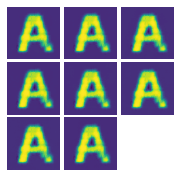

(8, 1, 64, 64)
[228/300][150/154]	Loss_D: 0.6929	Loss_G: 0.6942	D(x): 0.9999	D(G(z)): 0.4998 / 0.4995
label is ['A']


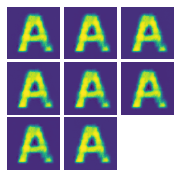

(8, 1, 64, 64)
[229/300][0/154]	Loss_D: 0.6906	Loss_G: 0.6963	D(x): 1.0000	D(G(z)): 0.4987 / 0.4984
label is ['A']


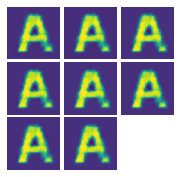

(8, 1, 64, 64)
[229/300][50/154]	Loss_D: 0.7048	Loss_G: 0.6822	D(x): 1.0000	D(G(z)): 0.5058 / 0.5055
label is ['A']


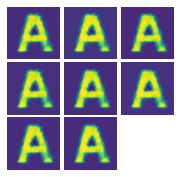

(8, 1, 64, 64)
[229/300][100/154]	Loss_D: 0.6937	Loss_G: 0.6951	D(x): 0.9979	D(G(z)): 0.4992 / 0.4990
label is ['A']


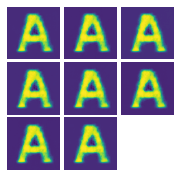

(8, 1, 64, 64)
[229/300][150/154]	Loss_D: 0.6950	Loss_G: 0.6920	D(x): 0.9999	D(G(z)): 0.5008 / 0.5005
label is ['A']


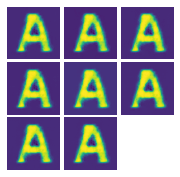

(8, 1, 64, 64)
[230/300][0/154]	Loss_D: 0.6932	Loss_G: 0.6937	D(x): 1.0000	D(G(z)): 0.5000 / 0.4997
label is ['A']


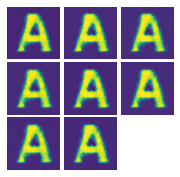

(8, 1, 64, 64)
[230/300][50/154]	Loss_D: 0.6960	Loss_G: 0.6921	D(x): 0.9986	D(G(z)): 0.5007 / 0.5005
label is ['A']


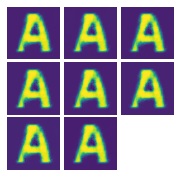

(8, 1, 64, 64)
[230/300][100/154]	Loss_D: 0.6905	Loss_G: 0.6967	D(x): 0.9997	D(G(z)): 0.4985 / 0.4982
label is ['A']


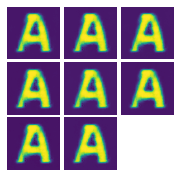

(8, 1, 64, 64)
[230/300][150/154]	Loss_D: 0.7055	Loss_G: 0.6816	D(x): 1.0000	D(G(z)): 0.5061 / 0.5058
label is ['A']


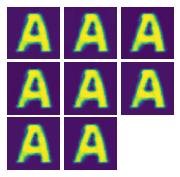

(8, 1, 64, 64)
[231/300][0/154]	Loss_D: 0.7029	Loss_G: 0.6842	D(x): 1.0000	D(G(z)): 0.5048 / 0.5045
label is ['A']


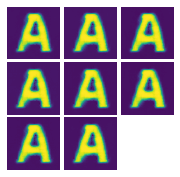

(8, 1, 64, 64)
[231/300][50/154]	Loss_D: 0.6969	Loss_G: 0.6913	D(x): 0.9984	D(G(z)): 0.5011 / 0.5009
label is ['A']


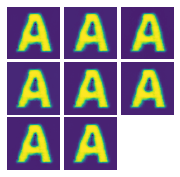

(8, 1, 64, 64)
[231/300][100/154]	Loss_D: 0.6934	Loss_G: 0.6938	D(x): 0.9998	D(G(z)): 0.5000 / 0.4997
label is ['A']


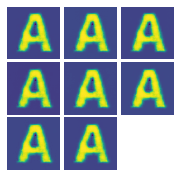

(8, 1, 64, 64)
[231/300][150/154]	Loss_D: 0.7043	Loss_G: 0.6828	D(x): 1.0000	D(G(z)): 0.5055 / 0.5052
label is ['A']


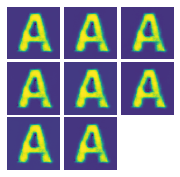

(8, 1, 64, 64)
[232/300][0/154]	Loss_D: 0.7024	Loss_G: 0.6846	D(x): 1.0000	D(G(z)): 0.5046 / 0.5043
label is ['A']


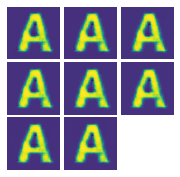

(8, 1, 64, 64)
[232/300][50/154]	Loss_D: 0.7002	Loss_G: 0.6902	D(x): 0.9960	D(G(z)): 0.5015 / 0.5015
label is ['A']


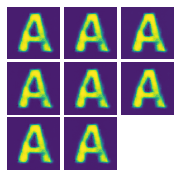

(8, 1, 64, 64)
[232/300][100/154]	Loss_D: 0.6922	Loss_G: 0.6953	D(x): 0.9994	D(G(z)): 0.4992 / 0.4989
label is ['A']


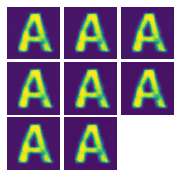

(8, 1, 64, 64)
[232/300][150/154]	Loss_D: 0.7060	Loss_G: 0.6810	D(x): 1.0000	D(G(z)): 0.5064 / 0.5061
label is ['A']


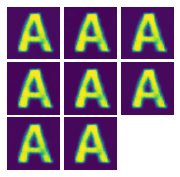

(8, 1, 64, 64)
[233/300][0/154]	Loss_D: 0.7040	Loss_G: 0.6830	D(x): 1.0000	D(G(z)): 0.5054 / 0.5051
label is ['A']


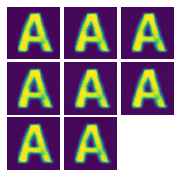

(8, 1, 64, 64)
[233/300][50/154]	Loss_D: 0.6991	Loss_G: 0.6904	D(x): 0.9969	D(G(z)): 0.5014 / 0.5014
label is ['A']


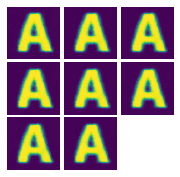

(8, 1, 64, 64)
[233/300][100/154]	Loss_D: 0.7007	Loss_G: 0.6863	D(x): 1.0000	D(G(z)): 0.5037 / 0.5034
label is ['A']


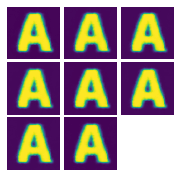

(8, 1, 64, 64)
[233/300][150/154]	Loss_D: 0.7000	Loss_G: 0.6870	D(x): 1.0000	D(G(z)): 0.5034 / 0.5031
label is ['A']


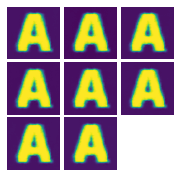

(8, 1, 64, 64)
[234/300][0/154]	Loss_D: 0.6977	Loss_G: 0.6893	D(x): 1.0000	D(G(z)): 0.5023 / 0.5019
label is ['A']


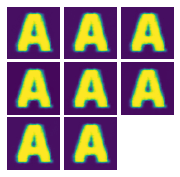

(8, 1, 64, 64)
[234/300][50/154]	Loss_D: 0.7040	Loss_G: 0.6944	D(x): 0.9871	D(G(z)): 0.4987 / 0.4994
label is ['A']


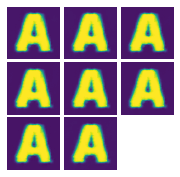

(8, 1, 64, 64)
[234/300][100/154]	Loss_D: 0.7256	Loss_G: 0.6625	D(x): 1.0000	D(G(z)): 0.5159 / 0.5156
label is ['A']


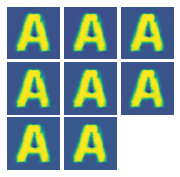

(8, 1, 64, 64)
[234/300][150/154]	Loss_D: 0.7060	Loss_G: 0.6812	D(x): 1.0000	D(G(z)): 0.5064 / 0.5060
label is ['A']


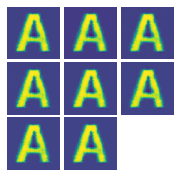

(8, 1, 64, 64)
[235/300][0/154]	Loss_D: 0.7042	Loss_G: 0.6830	D(x): 1.0000	D(G(z)): 0.5055 / 0.5051
label is ['A']


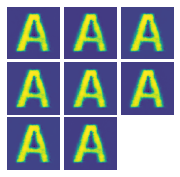

(8, 1, 64, 64)
[235/300][50/154]	Loss_D: 0.7046	Loss_G: 0.6887	D(x): 0.9929	D(G(z)): 0.5022 / 0.5022
label is ['A']


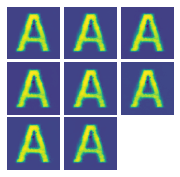

(8, 1, 64, 64)
[235/300][100/154]	Loss_D: 0.6924	Loss_G: 0.6948	D(x): 0.9998	D(G(z)): 0.4995 / 0.4992
label is ['A']


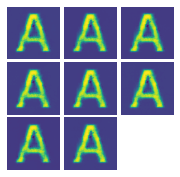

(8, 1, 64, 64)
[235/300][150/154]	Loss_D: 0.6956	Loss_G: 0.6914	D(x): 1.0000	D(G(z)): 0.5012 / 0.5009
label is ['A']


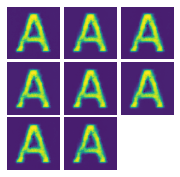

(8, 1, 64, 64)
[236/300][0/154]	Loss_D: 0.6934	Loss_G: 0.6935	D(x): 1.0000	D(G(z)): 0.5001 / 0.4998
label is ['A']


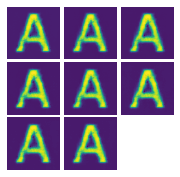

(8, 1, 64, 64)
[236/300][50/154]	Loss_D: 0.7028	Loss_G: 0.6842	D(x): 1.0000	D(G(z)): 0.5048 / 0.5045
label is ['A']


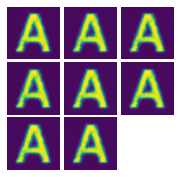

(8, 1, 64, 64)
[236/300][100/154]	Loss_D: 0.6949	Loss_G: 0.6921	D(x): 0.9999	D(G(z)): 0.5008 / 0.5005
label is ['A']


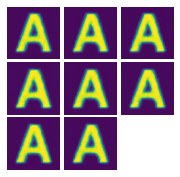

(8, 1, 64, 64)
[236/300][150/154]	Loss_D: 0.6894	Loss_G: 0.6975	D(x): 1.0000	D(G(z)): 0.4981 / 0.4978
label is ['A']


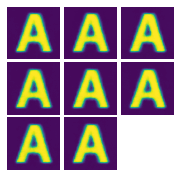

(8, 1, 64, 64)
[237/300][0/154]	Loss_D: 0.6893	Loss_G: 0.6978	D(x): 0.9997	D(G(z)): 0.4979 / 0.4977
label is ['A']


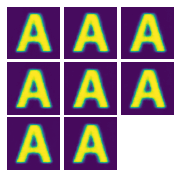

(8, 1, 64, 64)
[237/300][50/154]	Loss_D: 0.6966	Loss_G: 0.6912	D(x): 0.9988	D(G(z)): 0.5012 / 0.5010
label is ['A']


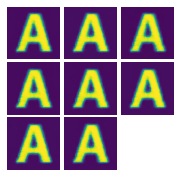

(8, 1, 64, 64)
[237/300][100/154]	Loss_D: 0.7009	Loss_G: 0.6861	D(x): 1.0000	D(G(z)): 0.5039 / 0.5036
label is ['A']


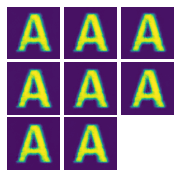

(8, 1, 64, 64)
[237/300][150/154]	Loss_D: 0.7017	Loss_G: 0.6853	D(x): 1.0000	D(G(z)): 0.5043 / 0.5039
label is ['A']


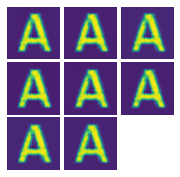

(8, 1, 64, 64)
[238/300][0/154]	Loss_D: 0.6997	Loss_G: 0.6874	D(x): 1.0000	D(G(z)): 0.5032 / 0.5029
label is ['A']


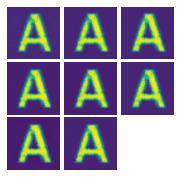

(8, 1, 64, 64)
[238/300][50/154]	Loss_D: 0.6981	Loss_G: 0.6890	D(x): 0.9998	D(G(z)): 0.5024 / 0.5021
label is ['A']


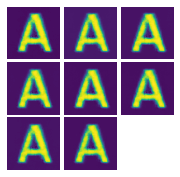

(8, 1, 64, 64)
[238/300][100/154]	Loss_D: 0.6984	Loss_G: 0.6886	D(x): 1.0000	D(G(z)): 0.5026 / 0.5023
label is ['A']


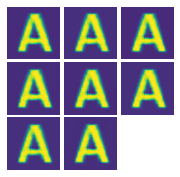

(8, 1, 64, 64)
[238/300][150/154]	Loss_D: 0.6898	Loss_G: 0.6971	D(x): 1.0000	D(G(z)): 0.4983 / 0.4980
label is ['A']


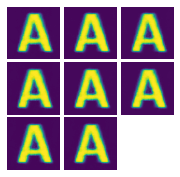

(8, 1, 64, 64)
[239/300][0/154]	Loss_D: 0.6988	Loss_G: 0.6874	D(x): 1.0000	D(G(z)): 0.5028 / 0.5029
label is ['A']


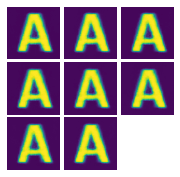

(8, 1, 64, 64)
[239/300][50/154]	Loss_D: 0.7109	Loss_G: 0.6762	D(x): 1.0000	D(G(z)): 0.5088 / 0.5085
label is ['A']


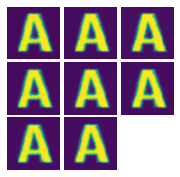

(8, 1, 64, 64)
[239/300][100/154]	Loss_D: 0.6899	Loss_G: 0.6972	D(x): 0.9997	D(G(z)): 0.4982 / 0.4980
label is ['A']


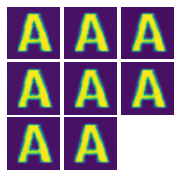

(8, 1, 64, 64)
[239/300][150/154]	Loss_D: 0.6977	Loss_G: 0.6891	D(x): 1.0000	D(G(z)): 0.5023 / 0.5020
label is ['A']


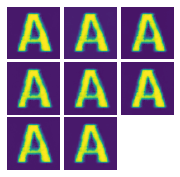

(8, 1, 64, 64)
[240/300][0/154]	Loss_D: 0.6963	Loss_G: 0.6905	D(x): 1.0000	D(G(z)): 0.5016 / 0.5013
label is ['A']


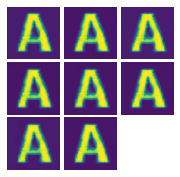

(8, 1, 64, 64)
[240/300][50/154]	Loss_D: 0.7078	Loss_G: 0.6922	D(x): 0.9861	D(G(z)): 0.5001 / 0.5005
label is ['A']


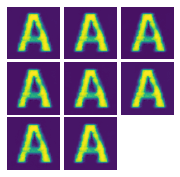

(8, 1, 64, 64)
[240/300][100/154]	Loss_D: 0.6946	Loss_G: 0.6923	D(x): 0.9999	D(G(z)): 0.5007 / 0.5004
label is ['A']


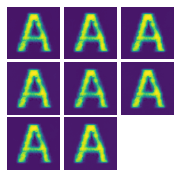

(8, 1, 64, 64)
[240/300][150/154]	Loss_D: 0.6949	Loss_G: 0.6921	D(x): 0.9999	D(G(z)): 0.5008 / 0.5005
label is ['A']


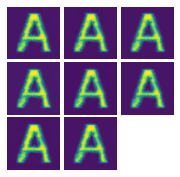

(8, 1, 64, 64)
[241/300][0/154]	Loss_D: 0.6941	Loss_G: 0.6927	D(x): 1.0000	D(G(z)): 0.5005 / 0.5002
label is ['A']


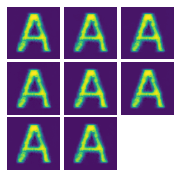

(8, 1, 64, 64)
[241/300][50/154]	Loss_D: 0.6970	Loss_G: 0.6901	D(x): 0.9998	D(G(z)): 0.5018 / 0.5015
label is ['A']


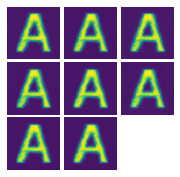

(8, 1, 64, 64)
[241/300][100/154]	Loss_D: 0.6946	Loss_G: 0.6933	D(x): 0.9990	D(G(z)): 0.5002 / 0.4999
label is ['A']


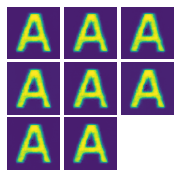

(8, 1, 64, 64)
[241/300][150/154]	Loss_D: 0.6943	Loss_G: 0.6928	D(x): 1.0000	D(G(z)): 0.5005 / 0.5002
label is ['A']


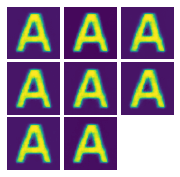

(8, 1, 64, 64)
[242/300][0/154]	Loss_D: 0.6920	Loss_G: 0.6950	D(x): 1.0000	D(G(z)): 0.4994 / 0.4991
label is ['A']


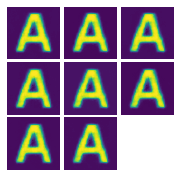

(8, 1, 64, 64)
[242/300][50/154]	Loss_D: 0.6928	Loss_G: 0.6943	D(x): 0.9997	D(G(z)): 0.4997 / 0.4994
label is ['A']


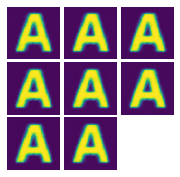

(8, 1, 64, 64)
[242/300][100/154]	Loss_D: 0.6929	Loss_G: 0.6942	D(x): 1.0000	D(G(z)): 0.4999 / 0.4995
label is ['A']


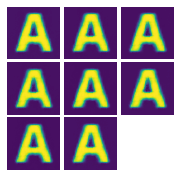

(8, 1, 64, 64)


In [ ]:
# Training Loop
import torch.optim as optim
import matplotlib.gridspec as gridspec

# Lists to keep track of progress
img_list = []
G_losses = []
D_losses = []
iters = 0

print("Starting Training Loop...")
labellist = ['A', 'B']
for alphabet in labellist:
  training_data.set_dataset(alphabet)
  train_dataloader = DataLoader(training_data, batch_size=BATCH_SIZE, shuffle=False)
  
  # test_data.set_dataset(alphabet)
  # test_dataloader = DataLoader(test_data, batch_size=BATCH_SIZE, shuffle=False)
  # For each epoch
  for epoch in range(num_epochs):
      # For each batch in the dataloader
      for i, data in enumerate(train_dataloader):
          # data[0] -> real x
          # data[1] -> real y
          y = np.expand_dims(data[1], (-1, -2))
          # y has shape (8, 1,  62, 1, 1) I need shape (8, 62, 1, 1)
          y = y.mean(axis=1)

          ############################
          # (1) Update D network: maximize log(D(x)) + log(1 - D(G(z)))
          ###########################
          ## Train with all-real batch
          netD.zero_grad()
          # Format batch
          real_cpu = data[0].to(device)
          b_size = real_cpu.size(0)

          # [real_label, real_label, real_label, real_label.....] with length batch size
          label = torch.full((b_size,), real_label, dtype=torch.float, device=device)
          
          # Forward pass real batch through D
          output = netD(real_cpu).view(-1)
          # Calculate loss on all-real batch
          errD_real = criterion(output, label)
          # Calculate gradients for D in backward pass
          errD_real.backward()
          D_x = output.mean().item()

          ## Train with all-fake batch
          # Generate batch of latent vectors
          noise = torch.randn(b_size, nz-62, 1, 1, device=device)
          # print(noise.shape)
          # print(y.mean(axis=1).shape)
          noise = torch.tensor(np.concatenate((y, noise.cpu()), axis=1)).type(torch.FloatTensor).to(device)
          # Generate fake image batch with G
          fake = netG(noise)
          label.fill_(fake_label)
          # Classify all fake batch with D
          output = netD(fake.detach()).view(-1)
          # Calculate D's loss on the all-fake batch
          errD_fake = criterion(output, label)
          # Calculate the gradients for this batch, accumulated (summed) with previous gradients
          errD_fake.backward()
          D_G_z1 = output.mean().item()
          # Compute error of D as sum over the fake and the real batches
          errD = errD_real + errD_fake
          # Update D
          optimizerD.step()

          ############################
          # (2) Update G network: maximize log(D(G(z)))
          ###########################
          netG.zero_grad()
          label.fill_(real_label)  # fake labels are real for generator cost
          # Since we just updated D, perform another forward pass of all-fake batch through D
          output = netD(fake).view(-1)
          # Calculate G's loss based on this output
          errG = criterion(output, label)
          # Calculate gradients for G
          errG.backward()
          D_G_z2 = output.mean().item()
          # Update G
          optimizerG.step()

          # Output training stats
          if i % 50 == 0:
              print('[%d/%d][%d/%d]\tLoss_D: %.4f\tLoss_G: %.4f\tD(x): %.4f\tD(G(z)): %.4f / %.4f'
                    % (epoch, num_epochs, i, len(train_dataloader),
                      errD.item(), errG.item(), D_x, D_G_z1, D_G_z2))
              print(f"label is {training_data.decode_to_label(data[1])}")
              imgs_numpy = fake.data.cpu().numpy()
              show_images(imgs_numpy[0:16])
              plt.show()
              print(imgs_numpy.shape)

          # Save Losses for plotting later
          G_losses.append(errG.item())
          D_losses.append(errD.item())

          # Check how the generator is doing by saving G's output on fixed_noise
          if (iters % 500 == 0) or ((epoch == num_epochs-1) and (i == len(train_dataloader)-1)):
              with torch.no_grad():
                  fake = netG(fixed_noise).detach().cpu()
              img_list.append(vutils.make_grid(fake, padding=2, normalize=True))

          iters += 1

In [ ]:
4098*2

In [ ]:
torch.randn(b_size, nz-62, 1, 1).shape

In [ ]:
np.expand_dims(y, (-1, -2)).shape

In [ ]:
def show_images(images):
    images = np.reshape(images, [images.shape[0], -1])  # images reshape to (batch_size, D)
    sqrtn = int(np.ceil(np.sqrt(images.shape[0])))
    sqrtimg = int(np.ceil(np.sqrt(images.shape[1])))

    fig = plt.figure(figsize=(sqrtn, sqrtn))
    gs = gridspec.GridSpec(sqrtn, sqrtn)
    gs.update(wspace=0.05, hspace=0.05)

    for i, img in enumerate(images):
        ax = plt.subplot(gs[i])
        plt.axis('off')
        ax.set_xticklabels([])
        ax.set_yticklabels([])
        ax.set_aspect('equal')
        plt.imshow(img.reshape([sqrtimg,sqrtimg]))
    return 

In [ ]:

# # def build_glyph_gan_generator(image_size=(32, 32, 1), noise_dimension=100, character_class_count=10, dimension=16):
# def build_glyph_gan_generator(image_size=(28, 28, 1), noise_dimension=NOISE_DIM, character_class_count=CLASS_COUNT):
#   """
#   PyTorch model implementing the GlyphGAN generator.
#   It will generate images of size `image_size`.
#   Inputs:
#   - `image_size`: A tuple (W,H,C) for the size of the images. Defaults to (32, 32, 1)
#   - `noise_dimension`: The width of the noise. Defaults to 100.
#   - `dimension`: The depth of the noise. Defaults to 14.
#   """
#   feature_sizes = (image_size[0], image_size[1])
#   # output_size I decided from Discriminator end output
#   output_size = 1024

#   return nn.Sequential(
#     nn.Linear(noise_dimension + character_class_count, output_size),
#     nn.ReLU(),
#     nn.BatchNorm1d(output_size),
#     nn.Unflatten(1, (256, 2,  2)),
#     nn.BatchNorm2d(256),

#     # Fractionally Strided Conv 1
#     nn.ConvTranspose2d(256, 128, 5, stride = 2, padding = 1),
#     nn.ReLU(),
#     nn.BatchNorm2d(128),

#     # # Fractionally Strided Conv 2
#     nn.ConvTranspose2d(128, 64, 5, stride = 2, padding = 1),
#     nn.ReLU(),
#     nn.BatchNorm2d(64),

#     # # Fractionally Strided Conv 3
#     nn.ConvTranspose2d(64, 32, 5, stride = 2, padding = 1, output_padding = 1),
#     nn.ReLU(),
#     nn.BatchNorm2d(32),

#     # # Fractionally Strided Conv 4
#     nn.ConvTranspose2d(32, 1, 7, stride = 1, padding = 1),
#     nn.ReLU(),
#     nn.Flatten(1)
#   )
# net = build_glyph_gan_generator().type(dtype)
# print(net)

# # Image should be a 28*28 array
# input = torch.randn(1, 28*28)
# net.apply(initialize_weights)

# # 300 is noise vector, 62 is character length
# # faje_seed shape should be(batch_size, noise+character)
# fake_seed = torch.randn(2, NOISE_DIM + CLASS_COUNT)
# fake_images = net.forward(fake_seed)
# print(fake_images.size())

In [ ]:
for x, _ in train_dataloader:
  print(x.shape)
  D  = build_glyph_gan_discriminator()
  real_data = x/255.0
  logits_real = (2* (real_data - 0.5))
  break

In [ ]:
# np.max(logits_real[0][0].numpy())
print(logits_real.shape)
print(len(logits_real))
plt.imshow(logits_real[0][0])

In [ ]:
for r, _ in train_dataloader:
  print(r.shape)
  # print(r[1])
  print(len(r))
  print(min(r[0][0].flatten()))
  plt.imshow(r[0][0])
  break

In [ ]:
def bce_loss(input, target):
    """
    Numerically stable version of the binary cross-entropy loss function.

    As per https://github.com/pytorch/pytorch/issues/751
    See the TensorFlow docs for a derivation of this formula:
    https://www.tensorflow.org/api_docs/python/tf/nn/sigmoid_cross_entropy_with_logits

    Inputs:
    - input: PyTorch Tensor of shape (N, ) giving scores.
    - target: PyTorch Tensor of shape (N,) containing 0 and 1 giving targets.

    Returns:
    - A PyTorch Tensor containing the mean BCE loss over the minibatch of input data.
    """
    neg_abs = - input.abs()
    loss = input.clamp(min=0) - input * target + (1 + neg_abs.exp()).log()
    return loss.mean()

def discriminator_loss(logits_real, logits_fake):
    """
    Computes the discriminator loss described above.
    
    Inputs:
    - logits_real: PyTorch Tensor of shape (N,) giving scores for the real data.
    - logits_fake: PyTorch Tensor of shape (N,) giving scores for the fake data.
    
    Returns:
    - loss: PyTorch Tensor containing (scalar) the loss for the discriminator.
    """
    size = logits_real.size()
    true_labels = torch.ones(size).type(dtype)
    loss = bce_loss(logits_real, true_labels) + bce_loss(logits_fake, true_labels - 1)
    return loss

def generator_loss(logits_fake):
    """
    Computes the generator loss described above.

    Inputs:
    - logits_fake: PyTorch Tensor of shape (N,) giving scores for the fake data.
    
    Returns:
    - loss: PyTorch Tensor containing the (scalar) loss for the generator.
    """
    size = logits_fake.size()
    true_labels = torch.ones(size).type(dtype)
    loss = bce_loss(logits_fake, true_labels)
    return loss

In [ ]:
torch.ones([2,1])

In [ ]:
import torch.optim as optim
import matplotlib.gridspec as gridspec

USE_GPU = True

dtype = torch.FloatTensor

if USE_GPU and torch.cuda.is_available():
    device = torch.device('cuda')
    dtype = torch.cuda.FloatTensor
else:
    device = torch.device('cpu')

print('using device:', device)

def get_optimizer(model):
    """
    Construct and return an Adam optimizer for the model with learning rate 1e-3,
    beta1=0.5, and beta2=0.999.
    
    Input:
    - model: A PyTorch model that we want to optimize.
    
    Returns:
    - An Adam optimizer for the model with the desired hyperparameters.
    """
    optimizer = optim.Adam(model.parameters(), lr=2e-4, betas=(0.9, 0.99))
    return optimizer

def sample_noise(batch_size, dim):
    """
    Generate a PyTorch Tensor of uniform random noise.

    Input:
    - batch_size: Integer giving the batch size of noise to generate.
    - dim: Integer giving the dimension of noise to generate.
    
    Output:
    - A PyTorch Tensor of shape (batch_size, dim) containing uniform
      random noise in the range (-1, 1).
    """
    return torch.rand((batch_size, dim)) * 2 - 1

In [ ]:
np.concatenate(torch.rand((8, 1024), sample_noise(8, 300)))

In [ ]:
sample_noise(8, 300).shape

In [ ]:
def run_a_gan(D, G, D_solver, G_solver, discriminator_loss, generator_loss, loader_train=train_dataloader, \
              show_every=10, batch_size=8, noise_size=NOISE_DIM + CLASS_COUNT, num_epochs=30):
    """
    Train a GAN!
    
    Inputs:
    - D, G: PyTorch models for the discriminator and generator
    - D_solver, G_solver: torch.optim Optimizers to use for training the
      discriminator and generator.
    - discriminator_loss, generator_loss: Functions to use for computing the generator and
      discriminator loss, respectively.
    - show_every: Show samples after every show_every iterations.
    - batch_size: Batch size to use for training.
    - noise_size: Dimension of the noise to use as input to the generator.
    - num_epochs: Number of epochs over the training dataset to use for training.
    """
    iter_count = 0
    for epoch in range(num_epochs):
        for x, y in loader_train:
            if len(x) != batch_size:
                continue
            # Normalize the pixels to 0 to 1
            x = x/255.0
            D_solver.zero_grad()
            real_data = x.type(dtype)

            # Why this :| 
            # I think it converts 0 to 1 to -1 to 1
            # size of logits_real will be 8, 1024
            logits_real = D(2* (real_data - 0.5)).type(dtype)
            # print(logits_real.shape)
            # plt.imshow(x[1].reshape(28,28))
            # break

            sample_zs = sample_noise(batch_size, noise_size-62)
            # print(f"{zc}\n\n\n{sample_zs}")
            g_fake_seed = torch.tensor(np.concatenate((y, sample_zs), axis=1)).type(dtype)
            # print(g_fake_seed.cpu().shape)
            fake_images = G(g_fake_seed).detach()
            logits_fake = D(fake_images.view(batch_size, 1, 28, 28))

            # print(g_fake_seed.cpu().shape)
            # print(f"{logits_real.cpu()}\n\n")
            # print(logits_fake.cpu())
            # break

            d_total_error = discriminator_loss(logits_real, logits_fake)
            d_total_error.backward()        
            D_solver.step()

            G_solver.zero_grad()

            sample_zs = sample_noise(batch_size, noise_size-62)
            g_fake_seed = torch.tensor(np.concatenate((y, sample_zs), axis=1)).type(dtype)
            # g_fake_seed = sample_noise(batch_size, noise_size).type(dtype)
            fake_images = G(g_fake_seed)

            gen_logits_fake = D(fake_images.view(batch_size, 1, 28, 28))
            g_error = generator_loss(gen_logits_fake)
            g_error.backward()
            G_solver.step()

            if (iter_count % show_every == 0):
                print('Iter: {}, D: {:.4}, G:{:.4}'.format(iter_count,d_total_error.item(),g_error.item()))
                imgs_numpy = fake_images.data.cpu().numpy()
                show_images(imgs_numpy[0:16])
                plt.show()
                print()
            iter_count += 1

In [ ]:
def show_images(images):
    images = np.reshape(images, [images.shape[0], -1])  # images reshape to (batch_size, D)
    sqrtn = int(np.ceil(np.sqrt(images.shape[0])))
    sqrtimg = int(np.ceil(np.sqrt(images.shape[1])))

    fig = plt.figure(figsize=(sqrtn, sqrtn))
    gs = gridspec.GridSpec(sqrtn, sqrtn)
    gs.update(wspace=0.05, hspace=0.05)

    for i, img in enumerate(images):
        ax = plt.subplot(gs[i])
        plt.axis('off')
        ax.set_xticklabels([])
        ax.set_yticklabels([])
        ax.set_aspect('equal')
        plt.imshow(img.reshape([sqrtimg,sqrtimg]))
    return 

In [ ]:
D_DC = build_glyph_gan_discriminator(batch_size = LOADER_BATCH_SIZE).type(dtype) 
D_DC.apply(initialize_weights)
G_DC = build_glyph_gan_generator().type(dtype)
G_DC.apply(initialize_weights)

D_DC_solver = get_optimizer(D_DC)
G_DC_solver = get_optimizer(G_DC)

run_a_gan(D_DC, G_DC, D_DC_solver, G_DC_solver, discriminator_loss, generator_loss, num_epochs=100, show_every=1024)

#  Testing mnist dataset formatting

In [ ]:
from torchvision import datasets, transforms


def get_mnist_dataloaders(batch_size=128):
    """MNIST dataloader with (32, 32) sized images."""
    # Resize images so they are a power of 2
    all_transforms = transforms.Compose([
        transforms.Resize(32),
        transforms.ToTensor()
    ])
    # Get train and test data
    train_data = datasets.MNIST('../data', train=True, download=True,
                                transform=all_transforms)
    test_data = datasets.MNIST('../data', train=False,
                               transform=all_transforms)
    # Create dataloaders
    train_loader = DataLoader(train_data, batch_size=batch_size, shuffle=True)
    test_loader = DataLoader(test_data, batch_size=batch_size, shuffle=True)
    return train_loader, test_loader

tl, _ = get_mnist_dataloaders()

In [ ]:
for r, _ in tl:
  print(r[0].shape)
  # print(r[1])
  print(len(r))
  plt.imshow(r[0][0])
  print(max(r[0][0][0].flatten()))
  break